In [9]:
import numpy as np
import pandas as pd
import scipy.interpolate
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable

from astropy.io import fits 
from astropy.table import QTable, Table
from astropy.io import ascii

# import emcee 
# import lmfit

## 1) All data-cleaning

In [10]:
# 1) HEAD FILE 
f = fits.open('DES-SN5YR_DES_HEAD.FITS')
t = Table(f[1].data)

# 2) PHOT FILE 
dat = fits.open('DES-SN5YR_DES_PHOT.FITS')
tb = Table(dat[1].data)
flux = tb['FLUXCAL'].data
fluxerr = tb['FLUXCALERR'].data

### a) Making `tnew` file: master dataframe with 1635 SN Ia info

In [11]:
c = pd.read_csv('DES_classification.csv')     # note this is 1635 total 
cids = c['CID'].values.astype(int) 

goodsn = c[c['PROB_SNNV19'] > 0.5]            # this is 1499 
goodsnids = goodsn['CID'].values
goodsnids = goodsnids.astype(int)

common_ids = np.intersect1d(t['SNID'].data.astype(int), cids)    # 1635 

In [12]:
inds = list(zip(t[t['SNTYPE'] == 1]['PTROBS_MIN'], t[t['SNTYPE'] == 1]['PTROBS_MAX']))
reds = t[t['SNTYPE'] == 1]['REDSHIFT_FINAL'].data
redss = reds[reds < 0.5]

inds = np.array(inds)
indss = inds[reds < 0.5]

snrows = [np.where(t['SNID'].data.astype(int) == cids.astype(int)[i])[0][0] for i in range(len(cids))]

snpeakmjd = t[snrows]['PEAKMJD'].data
snmjddetectfirst = t[snrows]['MJD_DETECT_FIRST'].data
snmjddetectlast = t[snrows]['MJD_DETECT_LAST'].data
snptrobs_min = t[snrows]['PTROBS_MIN'].data
snptrobs_max = t[snrows]['PTROBS_MAX'].data
snredshift_final = t[snrows]['REDSHIFT_FINAL'].data
snmjd = [tb[snptrobs_min[i]:snptrobs_max[i]]['MJD'].data for i in range(len(snrows))]
snband = [tb[snptrobs_min[i]:snptrobs_max[i]]['BAND'].data for i in range(len(snrows))]
snfluxcal = [tb[snptrobs_min[i]:snptrobs_max[i]]['FLUXCAL'].data for i in range(len(snrows))]
snfluxcalerr = [tb[snptrobs_min[i]:snptrobs_max[i]]['FLUXCALERR'].data for i in range(len(snrows))]

sntimes = [(snmjd[i] - snpeakmjd[i]) / (1 + snredshift_final[i]) for i in range(len(snrows))]


tnew = QTable([cids, snrows, snpeakmjd, snmjddetectfirst, snmjddetectlast, snptrobs_min, snptrobs_max, snredshift_final, 
              snmjd, snband, snfluxcal, snfluxcalerr],
           names=('CID', 'ROW', 'PEAKMJD', 'MJD_DETECT_FIRST', 'MJD_DETECT_LAST', 'PTROBS_MIN', 'PTROBS_MAX', 'REDSHIFT_FINAL',
                 'MJD', 'BAND', 'FLUXCAL', 'FLUXCALERR'),
           meta={'name': 'master table'})

# ascii.write(tnew, 'tnew.csv', format='csv', fast_writer=False, overwrite=True)


### b) Models & Making `tnewgood`, `tnewgood2` dataframes

In [13]:
# 5th lcplot: 
with open('FITOPT/FITOPT005.LCPLOT','r') as file5:
    data5 = file5.readlines()
    
for i in range(len(data5)): 
    data5[i] = data5[i].rstrip('\n')
    
# data5
head = data5[0]
data5 = [data5[i].split(',') for i in range(1, len(data5))]
ids = np.array([data5[i][0] for i in range(len(data5))])

bad = np.where([len(data5[i][0]) != 7 for i in range(len(data5))])
ids_cp = ids.copy()
ids_cp = np.delete(ids, bad)
ids_cp = ids_cp.astype(int)

mask = np.delete(np.arange(len(data5)), bad[0])
data5_cp = np.array([data5[mask[i]] for i in range(len(mask))])

no_sn_models = cids[list(set(np.arange(1635)) - set(np.intersect1d(cids, ids_cp, return_indices=True)[1]))]

In [14]:
# DES g: CWL = 473 nm, Blue Turn-on = 398 nm, Red Cutoff = 548 nm, FWHM = 150 nm
# DES r: CWL = 642 nm, Blue Turn-on = 568 nm, Red Cutoff = 716 nm, FWHM = 148 nm 
# DES i: CWL = 784 nm, Blue Turn-on = 710 nm, Red Cutoff = 857 nm, FWHM = 147 nm. 
# # https://noirlab.edu/science/programs/ctio/filters/Dark-Energy-Camera#:~:text=The%20filters%20used%20by%20the,objects%20in%20our%20solar%20system.) 

# (1 + z) * 473 = 784
z_gi = (784 / 473) - 1     # above 0.657 we should perhaps look into i band for excess. 
z_gr = (642 / 473) - 1

In [15]:
models = [data5_cp[np.where(ids_cp == cids[i])] for i in range(len(cids))]    # 1635 with some empty rows (1635-1626 = 9) 

models_g = [models[i][models[i][:, 6] == [' g']] for i in range(len(models))]
models_r = [models[i][models[i][:, 6] == [' r']] for i in range(len(models))]
models_i = [models[i][models[i][:, 6] == [' i']] for i in range(len(models))]  # in case for very high redshift (calculate this redshift) 

# model 
# models_g[i][:, 1].astype(float)    # model date 
# models_g[i][:, 3].astype(float)    # model flux 

# # real data  
# tnew[i]['MJD'][tnew[i]['BAND'] == 'g ']         # real date
# tnew[i]['FLUXCAL'][tnew[i]['BAND'] == 'g ']     # real flux   
# tnew[i]['CID']                                  # snid

# reference ^ by index (snid) --> note: might be safer to ref by id 

In [16]:
### for interpolation purposes 
ids_interp_g = [int(cids[i])*np.ones(len(tnew[i]['MJD'][tnew[i]['BAND'] == 'g '])) for i in range(len(tnew))]
ids_interp_r = [int(cids[i])*np.ones(len(tnew[i]['MJD'][tnew[i]['BAND'] == 'r '])) for i in range(len(tnew))]
ids_interp_i = [int(cids[i])*np.ones(len(tnew[i]['MJD'][tnew[i]['BAND'] == 'i '])) for i in range(len(tnew))]

# though the mjds might be useful for residuals, (SORTED by band). 
mjds_interp_g = [tnew[i]['MJD'][tnew[i]['BAND'] == 'g '] for i in range(len(tnew))]         # real date
mjds_interp_r = [tnew[i]['MJD'][tnew[i]['BAND'] == 'r '] for i in range(len(tnew))]
mjds_interp_i = [tnew[i]['MJD'][tnew[i]['BAND'] == 'i '] for i in range(len(tnew))]

# fluxes, SORTED by band. 
real_fluxes_g = [tnew[i]['FLUXCAL'][tnew[i]['BAND'] == 'g '] for i in range(len(tnew))]     # real flux 
real_fluxes_r = [tnew[i]['FLUXCAL'][tnew[i]['BAND'] == 'r '] for i in range(len(tnew))]
real_fluxes_i = [tnew[i]['FLUXCAL'][tnew[i]['BAND'] == 'i '] for i in range(len(tnew))]
# still indexed by snid. 

# flux ERRORS, SORTED by band. 
real_fluxes_g_err = [tnew[i]['FLUXCALERR'][tnew[i]['BAND'] == 'g '] for i in range(len(tnew))]     # real flux err
real_fluxes_r_err = [tnew[i]['FLUXCALERR'][tnew[i]['BAND'] == 'r '] for i in range(len(tnew))]
real_fluxes_i_err = [tnew[i]['FLUXCALERR'][tnew[i]['BAND'] == 'i '] for i in range(len(tnew))]

# peaks 
peakmjds_all = tnew['PEAKMJD'].data   # indexed by snid

# first and last detection (for quality cuts?) 
mjds_detect_first_all = tnew['MJD_DETECT_FIRST'].data
mjds_detect_last_all = tnew['MJD_DETECT_LAST'].data

# redshifts
redshifts_all = tnew['REDSHIFT_FINAL'].data   # min is 0.059624, max is 1.121319

In [17]:
# rest frame times 
rftimes_g = [(mjds_interp_g[i] - peakmjds_all[i]) / (1 + redshifts_all[i]) for i in range(len(mjds_interp_g))]
rftimes_r = [(mjds_interp_r[i] - peakmjds_all[i]) / (1 + redshifts_all[i]) for i in range(len(mjds_interp_r))]
rftimes_i = [(mjds_interp_i[i] - peakmjds_all[i]) / (1 + redshifts_all[i]) for i in range(len(mjds_interp_i))]

for i in range(len(rftimes_g)): 
    if len(rftimes_g[i]) == 0: 
        rftimes_g[i] = np.full(25, np.nan)   # nan
   
for i in range(len(rftimes_r)): 
    if len(rftimes_r[i]) == 0: 
        rftimes_r[i] = np.full(25, np.nan)   # nan
        
for i in range(len(rftimes_i)): 
    if len(rftimes_i[i]) == 0: 
        rftimes_i[i] = np.full(25, np.nan)   # nan
        
# rftimes_r[i] = [np.full(25, np.nan) for i in range(len(rftimes_r)) if len(rftimes_r[i]) == 0]
# seeing which indices for g, r, i don't have observational data.  --> replace with nans 

In [18]:
np.where(np.array([np.isnan(rftimes_g[i][0]) for i in range(len(rftimes_g))]) == True)
np.where(np.array([np.isnan(rftimes_r[i][0]) for i in range(len(rftimes_r))]) == True)
np.where(np.array([np.isnan(rftimes_i[i][0]) for i in range(len(rftimes_i))]) == True)

(array([  12,  106,  156,  174,  316,  555,  661,  715, 1168]),)

In [19]:
# rest frame mjds first detection 
mjds_detect_first_all_rf = (mjds_detect_first_all - peakmjds_all) / (1 + redshifts_all)

In [20]:
# FITRES file
with open('FITOPT/FITOPT005.FITRES','r') as file5_:
    fitres5 = file5_.readlines()
    
for i in range(len(fitres5)): 
    fitres5[i] = fitres5[i].rstrip('\n')

head5 = fitres5[5]
fitres5_ = [fitres5[i].split(' ') for i in range(1, len(fitres5))]
varnames = np.delete(np.copy(fitres5_[4][:-1]), 1)

fitres5 = fitres5_.copy()[6:]
bads = np.where(np.array([len(fitres5[i]) for i in range(len(fitres5))]) != 58)
mask = np.delete(np.arange(len(fitres5)), bads[0])
fitres5_cp = np.array([fitres5[mask[i]] for i in range(len(mask))])
mask = np.delete(np.arange(len(fitres5)), bads[0])
fitres5_cp = np.array([fitres5[mask[i]] for i in range(len(mask))])


In [21]:
np.setxor1d(np.arange(1635), np.intersect1d(cids, fitres5_cp[:, 1].astype(int), return_indices=True)[1])
# NO FITRES MODELS. should in theory be the same as no models from data5_cp (LCPLOT)... (YES it is)
# indices: np.setxor1d(np.arange(1635), np.intersect1d(cids, fitres5_cp[:, 1].astype(int), return_indices=True)[1])
sad = cids[np.setxor1d(np.arange(1635), np.intersect1d(cids, fitres5_cp[:, 1].astype(int), return_indices=True)[1])]
sad[np.argsort(sad)] == no_sn_models[np.argsort(no_sn_models)]

array([ True,  True,  True,  True,  True,  True,  True,  True,  True])

In [22]:
fits_1635sn = [1] * 1635

for i, cid in enumerate(cids): 
    ind_init = np.where(fitres5_cp[:, 1].astype(int) == cids[i])[0]
    if len(ind_init) == 0:     # accounting for no models there 
        fits_1635sn[i] = np.full(1, np.nan)
    else: 
        ind = ind_init[0]
        fits_1635sn[i] = fitres5_cp[ind]


In [23]:
# checked other file and the peaks are pretty much the same. 
# with open('FITOPT/FITOPT004.FITRES','r') as file4_:
#     fitres4 = file4_.readlines()
    
# for i in range(len(fitres4)): 
#     fitres4[i] =
#     a = np.where([np.isclose(fitres4_cp[:, 42][i].astype(float), fitres5_cp[:, 42][i].astype(float), atol=1) for i in range(len(fitres4_cp[:, 42]))])
# np.array(a).shape
# fitres4[i].rstrip('\n')

# head4 = fitres4[5]
# fitres4_ = [fitres4[i].split(' ') for i in range(1, len(fitres4))]
# varnames = np.delete(np.copy(fitres4_[4][:-1]), 1)

# fitres4 = fitres4_.copy()[6:]
# bads = np.where(np.array([len(fitres4[i]) for i in range(len(fitres4))]) != 58)
# mask = np.delete(np.arange(len(fitres4)), bads[0])
# fitres4_cp = np.array([fitres4[mask[i]] for i in range(len(mask))])
# mask = np.delete(np.arange(len(fitres4)), bads[0])
# fitres4_cp = np.array([fitres4[mask[i]] for i in range(len(mask))])

# a = np.where([np.isclose(fitres4_cp[:, 42][i].astype(float), fitres5_cp[:, 42][i].astype(float), atol=1) for i in range(len(fitres4_cp[:, 42]))])
# np.array(a).shape


In [24]:
## rest frame times based on peak from FITRES 
mask = np.delete(np.arange(1635), np.where([len(fits_1635sn[i]) == 1 for i in range(1635)]))

peakmjds_fitres = np.full(1635, np.nan)
peakmjdserr_fitres = np.full(1635, np.nan) 

for i in range(len(mask)): 
    peakmjds_fitres[mask[i]] = fits_1635sn[mask[i]][42].astype(float)
    peakmjdserr_fitres[mask[i]] = fits_1635sn[mask[i]][43].astype(float)
    
# check: np.where(np.isnan(peakmjdserr_fitres) == True) --> array([ 197,  312,  905,  917, 1203, 1209, 1245, 1507, 1574

In [25]:
# rest frame times based on peak from FITRES (all we have to do is replace peakmjds_all by peakmjds_fitres) 
rftimes_g_fitres = [(mjds_interp_g[i] - peakmjds_fitres[i]) / (1 + redshifts_all[i]) for i in range(len(mjds_interp_g))]
rftimes_r_fitres = [(mjds_interp_r[i] - peakmjds_fitres[i]) / (1 + redshifts_all[i]) for i in range(len(mjds_interp_r))]
rftimes_i_fitres = [(mjds_interp_i[i] - peakmjds_fitres[i]) / (1 + redshifts_all[i]) for i in range(len(mjds_interp_i))]

# this is where there is NO OBSERVATIONAL data for the bands. but there are also NO PEAKS / rftimes for those that don't have models too. 
# so have to add the above 9 as well.
# np.where([len(rftimes_g_fitres[i]) == 0 for i in range(len(rftimes_g_fitres))])
# np.where([len(rftimes_r_fitres[i]) == 0 for i in range(len(rftimes_r_fitres))])
# np.where([len(rftimes_i_fitres[i]) == 0 for i in range(len(rftimes_i_fitres))])

for i in range(len(rftimes_g_fitres)): 
    if len(rftimes_g_fitres[i]) == 0: 
        rftimes_g_fitres[i] = np.full(25, np.nan)   # nan
   
for i in range(len(rftimes_r_fitres)): 
    if len(rftimes_r_fitres[i]) == 0: 
        rftimes_r_fitres[i] = np.full(25, np.nan)   # nan
        
for i in range(len(rftimes_i_fitres)): 
    if len(rftimes_i_fitres[i]) == 0: 
        rftimes_i_fitres[i] = np.full(25, np.nan)   # nan
        
# seeing where nans in total (should be however many for 0 + the 9) <-- checked this! 
# np.where(np.array([np.isnan(rftimes_g_fitres[i][0]) for i in range(len(rftimes_g_fitres))]) == True)

# rftimes_r[i] = [np.full(25, np.nan) for i in range(len(rftimes_r)) if len(rftimes_r[i]) == 0]

In [19]:
### FIX THE TIME THING HERE ### 
## maybe just use the SNANA fits.. 

In [ ]:
# graph mjds_interp_g, real_fluxes_g, error_bars
# also graph shifed by peakmjds_all and redshifts_all

# graph models_g with dates and fluxes

Text(0.5, 1.0, 'with PHOT file PEAKMJD, g')

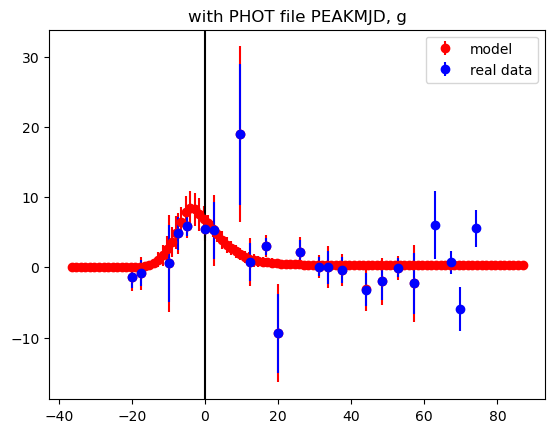

In [19]:
# a) i) graph with rest frame time
j = 80
test_times_model = (models_g[j][:, 1].astype(float) - peakmjds_all[j]) / (1 + redshifts_all[j])
test_times_real = (mjds_interp_g[j] - peakmjds_all[j]) / (1 + redshifts_all[j])

plt.errorbar(test_times_model, models_g[j][:, 3].astype(float), yerr=models_g[j][:, 4].astype(float), fmt='ro', label='model')
plt.errorbar(test_times_real, real_fluxes_g[j], yerr=real_fluxes_g_err[j], fmt='bo', label='real data')
plt.legend()
plt.axvline(0, color='k', ls='-')
plt.title('with PHOT file PEAKMJD, g')

# graph with the pkmjd from fitres file... 

In [ ]:
## fitprob in the fitres file (can check this too -- if the fit is bad it's prob not great for peak) 



Text(0.5, 1.0, 'with PHOT file PEAKMJD, r')

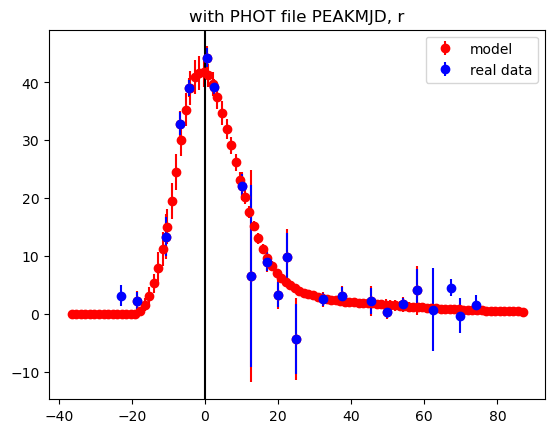

In [22]:
j = 80
test_times_model = (models_r[j][:, 1].astype(float) - peakmjds_all[j]) / (1 + redshifts_all[j])
test_times_real = (mjds_interp_r[j] - peakmjds_all[j]) / (1 + redshifts_all[j])

plt.errorbar(test_times_model, models_r[j][:, 3].astype(float), yerr=models_r[j][:, 4].astype(float), fmt='ro', label='model')
plt.errorbar(test_times_real, real_fluxes_r[j], yerr=real_fluxes_r_err[j], fmt='bo', label='real data')
plt.legend()
plt.axvline(0, color='k', ls='-')
plt.title('with PHOT file PEAKMJD, r')


In [172]:
fitres_pkmjd = np.zeros(1635)

for i in range(1635): 
    if len(fits_1635sn[i]) == 1: 
        fitres_pkmjd[i] = 0 
    else:    
        fitres_pkmjd[i] = fits_1635sn[i][42]


array([56530.3047, 56548.6055, 56532.5664, ..., 58128.0508, 58140.7188,
       58149.918 ])

In [187]:
peakmjds_all[0], fitres_pkmjd[0]

(56534.223, 56530.3047)

In [188]:
cids[1]

1246281

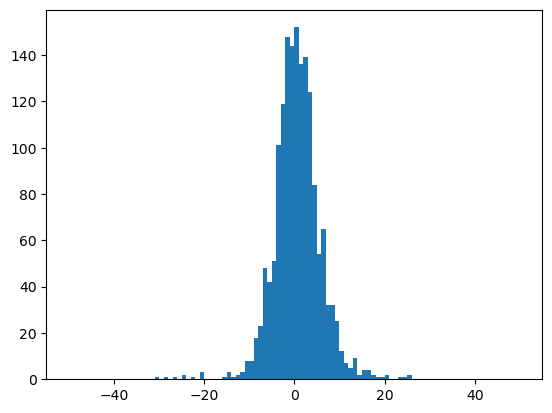

In [185]:
a, b, d = plt.hist(peakmjds_all - fitres_pkmjd, bins=100, range=(-50, 50))

Text(0.5, 0, 'days')

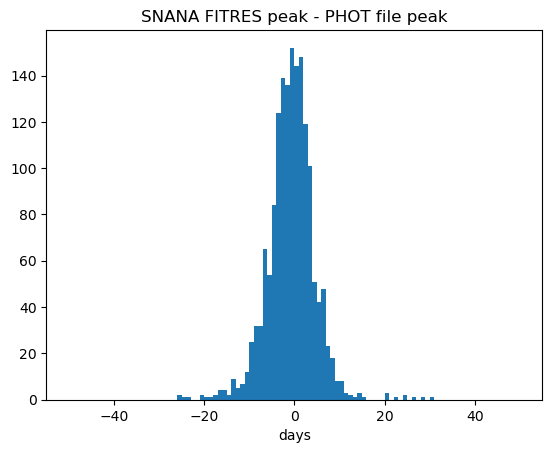

In [196]:
a, b, d = plt.hist(fitres_pkmjd - peakmjds_all, bins=100, range=(-50, 50))
plt.title('SNANA FITRES peak - PHOT file peak')
plt.xlabel('days')

In [201]:
np.where(((fitres_pkmjd - peakmjds_all) > -50) & ((fitres_pkmjd - peakmjds_all) < -20))

(array([ 152,  206,  371,  516,  611, 1391]),)

(-100.0, 100.0)

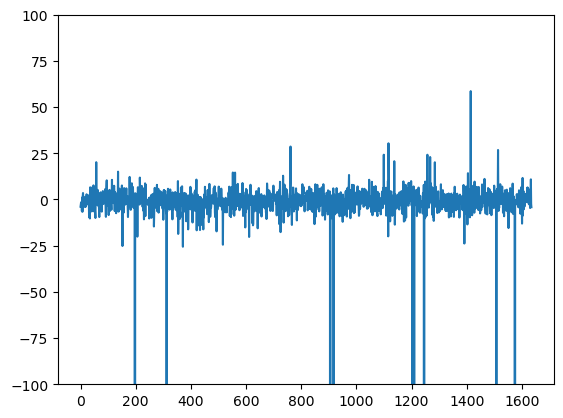

In [202]:
plt.plot(fitres_pkmjd - peakmjds_all)
plt.ylim([-100, 100])

Text(0.5, 1.0, 'with SNANA PKMJD fit, g')

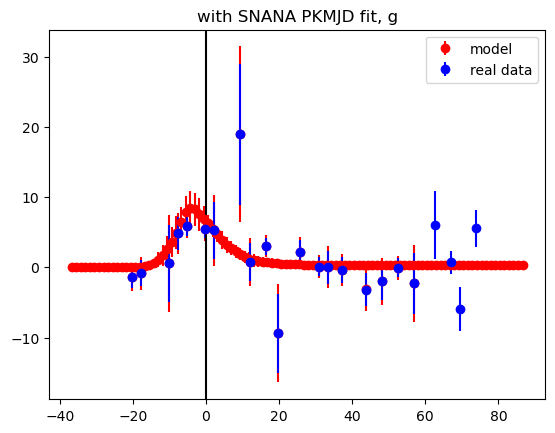

In [23]:
# a) ii) graph with the pkmjd from fitres file...
j = 80
test_times_model = (models_g[j][:, 1].astype(float) - fits_1635sn[j][42].astype(float)) / (1 + redshifts_all[j])
test_times_real = (mjds_interp_g[j] - fits_1635sn[j][42].astype(float)) / (1 + redshifts_all[j])

plt.errorbar(test_times_model, models_g[j][:, 3].astype(float), yerr=models_g[j][:, 4].astype(float), fmt='ro', label='model')
plt.errorbar(test_times_real, real_fluxes_g[j], yerr=real_fluxes_g_err[j], fmt='bo', label='real data')
plt.legend()
plt.axvline(0, color='k', ls='-')
plt.title('with SNANA PKMJD fit, g')



Text(0.5, 1.0, 'with SNANA PKMJD fit, r')

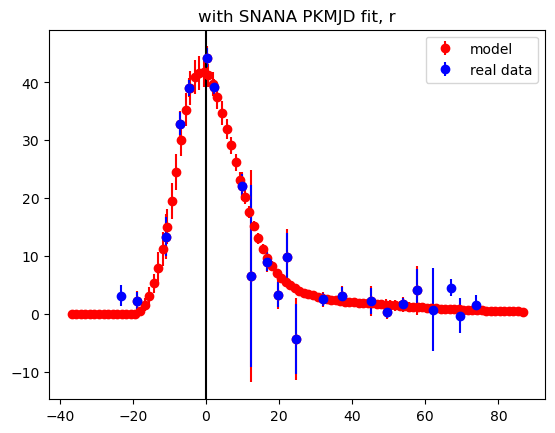

In [24]:
j = 80
test_times_model = (models_r[j][:, 1].astype(float) - fits_1635sn[j][42].astype(float)) / (1 + redshifts_all[j])
test_times_real = (mjds_interp_r[j] - fits_1635sn[j][42].astype(float)) / (1 + redshifts_all[j])

plt.errorbar(test_times_model, models_r[j][:, 3].astype(float), yerr=models_r[j][:, 4].astype(float), fmt='ro', label='model')
plt.errorbar(test_times_real, real_fluxes_r[j], yerr=real_fluxes_r_err[j], fmt='bo', label='real data')
plt.legend()
plt.axvline(0, color='k', ls='-')
plt.title('with SNANA PKMJD fit, r')

In [ ]:
# b) graph with the dataflag=0 only 

dataflag = [models_g[i][:, -4] for i in range(len(models_g))]
goodz_1 = models_g[0][dataflag[0].astype(int) == 1]
goodz_1_ = models_g[0][dataflag[0].astype(int) == -1]
goodz = models_g[0][dataflag[0].astype(int) == 0]
mjds_interp_g[0]



In [51]:
models_g[0]

array([['1246275', ' 56534.219', '    3.91', ..., ' g', ' 0.12', ' 1'],
       ['1246275', ' 56538.363', '    8.06', ..., ' g', ' 0.18', ' 1'],
       ['1246275', ' 56543.309', '   13.00', ..., ' g', ' 0.48', ' 1'],
       ...,
       ['1246275', ' 56665.305', '  135.00', ..., ' g', ' 0.00', ' 1'],
       ['1246275', ' 56667.305', '  137.00', ..., ' g', ' 0.00', ' 1'],
       ['1246275', ' 56669.305', '  139.00', ..., ' g', ' 0.00', ' 1']],
      dtype='<U12')

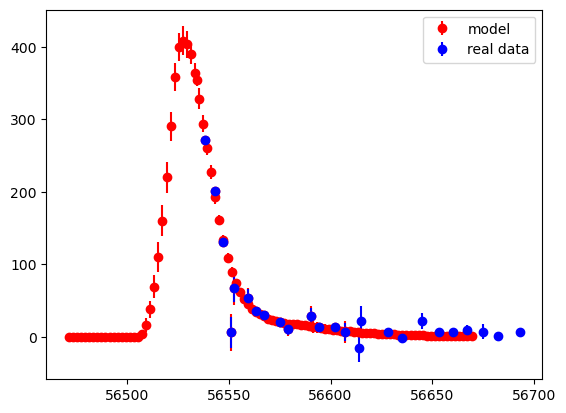

In [50]:
# 0) id 1246275

plt.errorbar(models_g[0][:, 1].astype(float), models_g[0][:, 3].astype(float), yerr=models_g[0][:, 4].astype(float), fmt='ro', label='model')
plt.errorbar(mjds_interp_g[0], real_fluxes_g[0], yerr=real_fluxes_g_err[0], fmt='bo', label='real data')
plt.legend()

## 2) Functions: Interpolation, Plotting, SNR

### a) Calculating cumulative SNR for interval of interest
### b) Interpolation with ONLY `DATAFLAG=0`, and ID rather than index

In [26]:
def cum_sn(time_arr_rf, flux, fluxerr): 
    """
    Return cumulative SNR and SNR arrays for interval -20-14d before peak. 
    """
    if np.isnan(time_arr_rf.sum()) != 0:      # no data 
        return np.nan, np.nan
    
    else: 
        cond = (-20 <= time_arr_rf) & (time_arr_rf <= -14)
        sn = flux[cond] / fluxerr[cond] 
    #     cumsn = np.sqrt(np.sum((flux[cond] / fluxerr[cond])**2))    # cumulative SN
        cumsn = np.sqrt(np.sum(sn**2))
        return cumsn, sn 

In [28]:
### Interpolation with ONLY DATAFLAG=0, AND ID rather than index ###
## NEW (modified)

from scipy import interpolate 

models_g_0 = [models_g[i][models_g[i][:, -4].astype(int) == 0] for i in range(len(models_g))]
models_r_0 = [models_r[i][models_r[i][:, -4].astype(int) == 0] for i in range(len(models_r))]
models_i_0 = [models_i[i][models_i[i][:, -4].astype(int) == 0] for i in range(len(models_i))]

def interp(i, filter, peak='fitres'):
    
    """ 
    Interpolate a model-fit SN Ia at MJDs of its observation. 
    Inputs: index i (out of 1635 SN Ia) or SNID, filter 'g', 'r', or 'i', peakmjd type 'fitres' or 'phot' 
    Outputs: dictionary containing 'model', 'interp_flux', 'data', 'err', 'res', 'res_chi2', 'cum_sn', 'sn', 'snid', 'redshift' 
             if model exists; otherwise only 'data', 'err', 'cum_sn', 'sn', 'snid', redshift'. 
    """
    
    if filter == 'g': 
        model = models_g_0
        mjds = mjds_interp_g     # note this is NOT rest frame time bc model has observed time and i was too lazy to convert it 
        fluxes = real_fluxes_g 
        fluxerrs = real_fluxes_g_err
        rftimes = rftimes_g_fitres if peak == 'fitres' else rftimes_g 
    if filter == 'r': 
        model = models_r_0
        mjds = mjds_interp_r
        fluxes = real_fluxes_r
        fluxerrs = real_fluxes_r_err
        rftimes = rftimes_r_fitres if peak == 'fitres' else rftimes_r
    if filter == 'i':  
        model = models_i_0 
        mjds = mjds_interp_i 
        fluxerrs = real_fluxes_i_err
        fluxes = real_fluxes_i 
        rftimes = rftimes_i_fitres if peak == 'fitres' else rftimes_i
     
    if i > 1e6:     # id 
        if len(np.where(cids == i)[0]) != 0:
            i = np.where(cids == i)[0][0]
        else: 
            return "No SN Ia found!" 

    # error and sn 
    err = fluxerrs[i].astype(float) 
    cumsn, sn = cum_sn(rftimes[i], fluxes[i], fluxerrs[i])[0], cum_sn(rftimes[i], fluxes[i], fluxerrs[i])[1]
    
    # id and redshift 
    snid = cids[i]
    redshift = redshifts_all[i]
 
    # interpolation 
    x = model[i][:, 1].astype(float)[np.argsort(model[i][:, 1].astype(float))]    # model date, sorted chronologically 
    x = (x - peakmjds_fitres[i]) / (1 + redshifts_all[i]) if peak == 'fitres' else (x - peakmjds_all[i]) / (1 + redshifts_all[i]) 
    # ^ rest frame time w/ fitres peak
    # ^ could be none if no model, but next line takes care of that. 
    y = model[i][:, 3].astype(float)[np.argsort(model[i][:, 1].astype(float))]    # model flux, sorted ^ 
    
    # check if model exists ^ 
    if len(y) == 0: 
        # return None 
        dict_nomodel = {
            "data": np.array(list(zip(rftimes[i], fluxes[i]))),    # rest frame; note technically there could be no data for this as well (nans just don't plot so it's fine) 
            "err": err,
            "cum_sn": cumsn, 
            "sn": sn, 
            "snid": snid, 
            "redshift": redshift} 
        return dict_nomodel
    
    f = interpolate.interp1d(x, y, fill_value='extrapolate')   
    
    # xnew = mjds[i]          # mjds of observation
    xnew = rftimes[i]       # rest frame times of observation
    ynew = f(xnew)          # predicted/expected model for those mjds 
    
    # err = fluxerrs[i] 
    # ddof = 
    res = fluxes[i] - ynew 
    res_chi2 = (fluxes[i] - ynew)**2 / ynew 
    # chi2 = res**2 / ynew 
    # rchi2 = chi2 / ddof 
    
    # return ynew, chi2, rchi2 
    
    dict = {
        "model": np.array(list(zip(x, y))), 
        "interp_flux": np.array(list(zip(xnew, ynew))), 
        "data": np.array(list(zip(rftimes[i], fluxes[i]))),     # rest frame times 
        "err": err, 
        "res": res, 
        "res_chi2": res_chi2, 
        "cum_sn": cumsn,
        "sn": sn,
        "snid": snid,
        "redshift": redshift}
    
    return dict

### c) Plotting with Error Bars & Labeling with Cumulative SN

In [29]:
def bin2gri(): 
    """ Returns a dictionary with the following conversion: 
    {
        '000': None,
        '100': 'g',
        '010': 'r',
        '001': 'i',
        '110': 'gr',
        '101': 'gi',
        '011': 'ri',
        '111': 'gri'
        }
        """
    return {
        '000': None,
        '100': 'g',
        '010': 'r',
        '001': 'i',
        '110': 'gr',
        '101': 'gi',
        '011': 'ri',
        '111': 'gri'
    }

In [30]:
## 1) STILL PLOT DATA even if model doesn't exist! 
## 2) overplot error bars
## 3) label with cumulative SN 
## 4) plot where peakmjd is from PHOT file 

### NEW ###
def plot_all_res(ax, i, peak, exflux='000', restype='res', bothpeaks=True):          #including residuals 
    
    """
    Plot model, data, and residuals for 'g' and 'r' bands, 'i' if applicable (redshift is > z_gi =~ 0.66). 
    Inputs: ax to plot on, i: either index i of 1635 SN or snid, exflux (3-digit binary str to indicate detection in 'g', 'r', or 'i' band),
            restype (either 'res' or 'chi2'), peakmjd type (either 'fitres' or 'phot') 
    Outputs: the plot!  
    
    """
    
    # fig, ax = plt.subplots(figsize=(12, 8))   # if you want each separate
    divider = make_axes_locatable(ax)
    ax2 = divider.append_axes("bottom", size="30%", pad=0, sharex=ax)

    # i can be either index or id 
    if i > 1e6: 
        i = np.where([cids == i])[1][0]
         
    # detection band
    ex_detect_bands = bin2gri()[f'{exflux}']
    
    ### 1) Model and Data ### 
    if len(interp(i, 'g', 'fitres')['data']) != 0: 
        ax.errorbar(interp(i, 'g', peak)['data'][:, 0], interp(i, 'g', peak)['data'][:, 1], yerr=interp(i, 'g', peak)['err'], 
                    fmt='o--', color='teal', label=f"data g, SNR = {interp(i, 'g')['cum_sn']:.3f}") 
        
    if len(interp(i, 'r', 'fitres')['data']) != 0: 
        ax.errorbar(interp(i, 'r', peak)['data'][:, 0], interp(i, 'r', peak)['data'][:, 1], yerr=interp(i, 'r', peak)['err'], 
                    fmt='o--', color='orange', label=f"data r, SNR = {interp(i, 'r')['cum_sn']:.3f}") 

    if len(interp(i, 'g', peak)) > 6:    # model exists
        ax.plot(interp(i, 'g', peak)['model'][:, 0], interp(i, 'g', peak)['model'][:, 1], '-', color='teal', alpha=0.6, label='model g')
        # ax.plot(interp(i, 'g')['interp_flux'][:, 0], interp(i, 'g')['interp_flux'][:, 1], 'o', color='teal', label='interp_flux g')

        if restype == 'res': 
            ax2.plot(interp(i, 'g', peak)['data'][:, 0], interp(i, 'g', peak)['res'], 'o', color='teal')

        if restype == 'chi2':
            ax2.plot(interp(i, 'g', peak)['data'][:, 0], interp(i, 'g', peak)['res_chi2'], 'o', color='teal')
   
    if len(interp(i, 'r', peak)) > 6:
        ax.plot(interp(i, 'r', peak)['model'][:, 0], interp(i, 'r', peak)['model'][:, 1], '-', color='orange', alpha=0.6, label='model r')
        # plt.plot(interp(i, 'r')['interp_flux'][:, 0], interp(i, 'r')['interp_flux'][:, 1], 'o', color='k', label='interp_flux r')        
        
        if restype == 'res': 
            ax2.plot(interp(i, 'r', peak)['data'][:, 0], interp(i, 'r', peak)['res'], 'o', color='orange')
            
        if restype == 'chi2': 
            ax2.plot(interp(i, 'r', peak)['data'][:, 0], interp(i, 'r', peak)['res_chi2'], 'o', color='orange')
        
    # if interp(i, 'g')['redshift'] > z_gi: 
    if redshifts_all[i] > z_gi: 
        if len(interp(i, 'i', 'fitres')['data']) != 0: 
            ax.errorbar(interp(i, 'i', peak)['data'][:, 0], interp(i, 'i', peak)['data'][:, 1], yerr=interp(i, 'i', peak)['err'], fmt='o--', color='grey', label=f"data i, SNR = {interp(i, 'i')['cum_sn']:.3f}")

        if len(interp(i, 'i', peak)) > 6: 
            ax.plot(interp(i, 'i', peak)['model'][:, 0], interp(i, 'i', peak)['model'][:, 1], '-', color='grey', alpha=0.6, label='model i')
            # plt.plot(interp(i, 'g')['interp_flux'][:, 0], interp(i, 'g')['interp_flux'][:, 1], 'o', color='k', label='interp_flux i')
            
            if restype == 'res': 
                ax2.plot(interp(i, 'i', peak)['data'][:, 0], interp(i, 'i', peak)['res'], 'o', color='grey')
            
            if restype == 'chi2': 
                ax2.plot(interp(i, 'i', peak)['data'][:, 0], interp(i, 'i', peak)['res_chi2'], 'o', color='grey')
 
    # rest frame mjds first detection 
    mjds_detect_first_all_rf = (mjds_detect_first_all - peakmjds_fitres) / (1 + redshifts_all) if peak == 'fitres' else (mjds_detect_first_all - peakmjds_all) / (1 + redshifts_all)
    other_peak_rf = (peakmjds_all - peakmjds_fitres) / (1 + redshifts_all) if peak == 'fitres' else (peakmjds_fitres - peakmjds_all) / (1 + redshifts_all)
    peaks = ['fitres', 'phot'] 
    peaktype = peak 
    other_peak = peaks[np.logical_not(peaks == peak)]
    
    ax.axvspan(-20, -14, alpha=0.2, color='grey', label='-20-14 d')
    ax.axvline(mjds_detect_first_all_rf[i], color='grey', ls='--', label='first detection')
    ax.axvline(0, color='grey', label=f"$t_p$, '{peaktype}'")      # peak from reference t,peakmjd. fitres = default 
    
    # make option to plot the peakmjds_all in rest frame too to see what the offset is. 
    if bothpeaks == True: 
        ax.axvline(other_peak_rf[i], color='red', label=f"$t_p$, '{other_peak}'")
            
    ax.set_ylabel('Flux')
    ax.legend()

    ## 2) RESIDUALS PLOT ax2 
    if restype == 'res':
        ax2.set_ylabel('Residuals')
    
    if restype == 'chi2': 
        ax2.set_ylabel(r'$\chi^2$ Residuals')

    ax2.axvspan(-20, -14, alpha=0.2, color='grey', label='-20-14 d')
    ax2.axvline(mjds_detect_first_all_rf[i], color='grey', ls='--', label='first detection')
    ax2.axvline(0, color='grey', label=f"$t_p$, '{peaktype}'")
    
    if bothpeaks == True: 
        ax2.axvline(other_peak_rf[i], color='red', label=f"$t_p$, '{other_peak}'")
            
    ax2.axhline(0, color='k', ls='--')
    ax2.set_xlabel(r'Rest Frame days $(t - t_{peakmjd})$')
    # ax2.legend()

    # Set x-ticks for the shared axis
#     x_ticks = np.linspace(-40, 100, 20)
#     ax2.set_xticks(x_ticks)
#     ax2.set_xticklabels([str(int(tick)) for tick in x_ticks])

#     # remove x-ticks from the main plot to avoid overlap
    # ax.set_xticklabels([])

#     ax.set_xlim([-35, 20])
#     ax2.set_xlim([-35, 20])
    l = min(-30, mjds_detect_first_all_rf[i])     # minimum x value is either -35 or -5 before first detection. 
    ax.set_xlim([l-5, 20])
    ax2.set_xlim([l-5, 20])
#     fig.suptitle(f"snid {cids[i]}, redshift {redshifts_all[i]:.4f}")
#     fig.tight_layout()
    
    ax.set_title(f"snid {cids[i]}, redshift {redshifts_all[i]:.4f}, detection in {ex_detect_bands}")


## 3) New Sample Cuts

### a) Revised Cuts

In [ ]:
* 3) NEW Sample cut criteria: 
    * 1) An observation between -40 and -20 in rest frame 
    * 2) A detection between -20 and -14 from peak 
    * 3) Fix the x1 and c constraints again (gets rid of only a few) 

#### This is with the original rest frame times using the PEAKMJD from the PHOT file. 

In [24]:
a_g = []    # 1169
a_r = []    # 1225 
a_i = []    # 1236 
a = [a_g, a_r, a_i] 
rftimes_gri = [rftimes_g, rftimes_r, rftimes_i]

for i in range(1635):
    for j, rf_filt in enumerate(rftimes_gri): 
        cond = (-40 < rf_filt[i]) & (rf_filt[i] < -20)
        if np.sum(cond) > 0:   # at least one observation between -40 and -20 in rest frame (it's okay if earlier too i guess) 
            a[j].append(i) 
    
cond1 = (peakmjds_all - mjds_detect_first_all) / (1 + redshifts_all) >= 14
cond2 = (peakmjds_all  - mjds_detect_first_all) / (1 + redshifts_all) <= 20

b = np.where(cond1 & cond2)[0]

c_g = np.intersect1d(a_g, b)    # 258
c_r = np.intersect1d(a_r, b)    # 265
c_i = np.intersect1d(a_i, b)    # 265

c_new_phot = np.unique(np.hstack((c_g, c_r, c_i)))    # 71 

## now delete to satisfy x1 and c bounds 
fitres_cuts = np.array([fits_1635sn[c_new_phot[i]] for i in range(len(c_new_phot))])
cond3 = fitres_cuts[:, 46].astype(float) > 0.3
cond_3 = fitres_cuts[:, 46].astype(float) < -0.3
cond4 = fitres_cuts[:, 44].astype(float) > 3
cond_4 = fitres_cuts[:, 44].astype(float) < -3    # can use np.abs for this as well 
more = np.concatenate((np.where(cond3)[0], np.where(cond_3)[0], np.where(cond4)[0], np.where(cond_4)[0]))
more
c_new_phot = np.delete(c_new_phot, more)
c_new_phot.shape    # 161 

(161,)

In [27]:
c_new_phot

array([  68,   77,  124,  131,  134,  154,  166,  184,  189,  199,  201,
        204,  214,  225,  230,  244,  249,  250,  252,  253,  257,  258,
        266,  267,  268,  278,  288,  297,  299,  300,  309,  310,  311,
        322,  383,  440,  465,  474,  481,  487,  488,  496,  497,  529,
        530,  545,  547,  558,  571,  574,  595,  597,  613,  615,  619,
        622,  626,  639,  642,  644,  661,  674,  675,  681,  688,  696,
        698,  703,  704,  711,  717,  718,  725,  728,  729,  733,  736,
        741,  746,  750,  753,  756,  764,  766,  769,  782,  788,  789,
        792,  801,  802,  832,  848,  853,  877,  887,  889,  908,  910,
        913,  922,  925,  926,  941,  942,  944,  950,  952,  965, 1002,
       1038, 1039, 1058, 1081, 1094, 1118, 1122, 1130, 1134, 1139, 1167,
       1172, 1186, 1201, 1236, 1237, 1275, 1280, 1289, 1295, 1297, 1299,
       1302, 1304, 1325, 1328, 1342, 1346, 1349, 1363, 1390, 1392, 1409,
       1411, 1417, 1420, 1445, 1448, 1476, 1496, 15

In [363]:
c_new_ = c_new.reshape((23, 7))
fig, axes = plt.subplots(23, 7, figsize=(70, 230))

for i in range(23): 
    for j in range(7): 
        plot_all_res(axes[i, j], c_new_[i, j], 'fitres')

#### And this is with the PKMJD from the FITRES file. 

In [358]:
# rftimes_g_fitres = [(mjds_interp_g[i] - peakmjds_fitres[i]) / (1 + redshifts_all[i]) for i in range(len(mjds_interp_g))]
# rftimes_r_fitres = [(mjds_interp_r[i] - peakmjds_fitres[i]) / (1 + redshifts_all[i]) for i in range(len(mjds_interp_r))]
# # rftimes_i_fitres

In [31]:
a_g = []    # 1169
a_r = []    # 1225 
a_i = []    # 1236 
a = [a_g, a_r, a_i] 
rftimes_gri_fitres = [rftimes_g_fitres, rftimes_r_fitres, rftimes_i_fitres]

for i in range(1635):
    for j, rf_filt in enumerate(rftimes_gri_fitres): 
        cond = (-40 < rf_filt[i]) & (rf_filt[i] < -20)
        if np.sum(cond) > 0:   # at least one observation between -40 and -20 in rest frame (it's okay if earlier too i guess) 
            a[j].append(i) 
    

In [32]:
cond1 = (peakmjds_fitres - mjds_detect_first_all) / (1 + redshifts_all) >= 14
cond2 = (peakmjds_fitres - mjds_detect_first_all) / (1 + redshifts_all) <= 20

b = np.where(cond1 & cond2)[0]

c_g = np.intersect1d(a_g, b)    # 258
c_r = np.intersect1d(a_r, b)    # 265
c_i = np.intersect1d(a_i, b)    # 265

c_new = np.unique(np.hstack((c_g, c_r, c_i)))    # 71 

## now delete to satisfy x1 and c bounds 
fitres_cuts = np.array([fits_1635sn[c_new[i]] for i in range(len(c_new))])
cond3 = fitres_cuts[:, 46].astype(float) > 0.3
cond_3 = fitres_cuts[:, 46].astype(float) < -0.3
cond4 = fitres_cuts[:, 44].astype(float) > 3
cond_4 = fitres_cuts[:, 44].astype(float) < -3 
more = np.concatenate((np.where(cond3)[0], np.where(cond_3)[0], np.where(cond4)[0], np.where(cond_4)[0]))

c_new = np.delete(c_new, more)
c_new     # now it's 70 

array([  93,  149,  154,  189,  201,  214,  250,  260,  267,  268,  290,
        440,  491,  493,  497,  516,  547,  574,  607,  655,  661,  675,
        698,  703,  704,  717,  718,  719,  729,  733,  746,  750,  789,
        792,  794,  832,  853,  887,  908,  922,  926,  941,  944,  952,
       1006, 1009, 1016, 1026, 1175, 1201, 1207, 1257, 1295, 1302, 1304,
       1317, 1349, 1451, 1481, 1525, 1539, 1562, 1567, 1572, 1585, 1608,
       1628])

In [33]:
c_new = np.array(c_new, dtype=object)

c_new_ = np.append(c_new, [np.nan, np.nan, np.nan])
c_new_ = c_new_.reshape((10, 7))
c_new_

array([[93, 149, 154, 189, 201, 214, 250],
       [260, 267, 268, 290, 440, 491, 493],
       [497, 516, 547, 574, 607, 655, 661],
       [675, 698, 703, 704, 717, 718, 719],
       [729, 733, 746, 750, 789, 792, 794],
       [832, 853, 887, 908, 922, 926, 941],
       [944, 952, 1006, 1009, 1016, 1026, 1175],
       [1201, 1207, 1257, 1295, 1302, 1304, 1317],
       [1349, 1451, 1481, 1525, 1539, 1562, 1567],
       [1572, 1585, 1608, 1628, nan, nan, nan]], dtype=object)

/tmp/ipykernel_1775656/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_1775656/305493186.py:77: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  other_peak = peaks[np.logical_not(peaks == peak)]
/global/common/software/nersc/pe/conda-envs/24.1.0/python-3.11/nersc-python/lib/python3.11/site-packages/scipy/interpolate/_interpolate.py:701: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


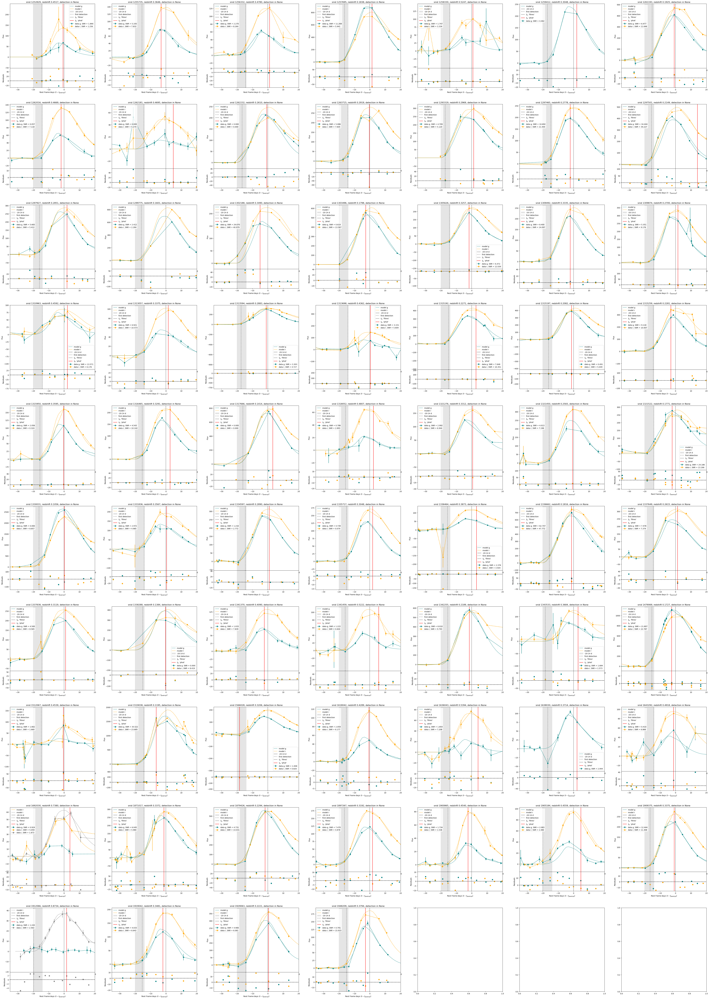

In [31]:
fig, axes = plt.subplots(10, 7, figsize=(70, 100))

for i in range(10): 
    for j in range(7): 
        if i == 9: 
            if j == 4 or j == 5 or j == 6: 
                break 
        plot_all_res(axes[i, j], c_new_[i, j], 'fitres')
    
plt.savefig('newcuts.pdf')

### b) Load into new dataframe with Cumulative SN 

In [ ]:
## load into NEW SAMPLE CUTS dataframe 
from astropy.table import Column

tnewgood = tnew.copy()[c]
tnewgood.add_columns([1, 1, 1, 1, 1], names=['model', 'interp_flux', 'data', 'res', 'res_chi2'])  
# use j to index

In [ ]:
# models 
models = []
for j in range(len(c)): 
    model = []
    
    if interp(c[j], 'g') is None: 
        model.append(np.full(1, np.nan))        # array of nans as placeholder
    if interp(c[j], 'g') is not None: 
        model.append(interp(c[j], 'g')['model'])
        
    if interp(c[j], 'r') is None: 
        model.append(np.full(1, np.nan))      
    if interp(c[j], 'r') is not None: 
        model.append(interp(c[j], 'r')['model'])
        
    if interp(c[j], 'i') is None: 
        model.append(np.full(1, np.nan))  
    if interp(c[j], 'i') is not None: 
        model.append(interp(c[j], 'i')['model'])
        
    models.append(model)
    
# interpolated flux
interp_fluxes = []
for j in range(len(c)): 
    interp_flux = []
    
    if interp(c[j], 'g') is None: 
        interp_flux.append(np.full(1, np.nan))        # array of nans as placeholder
    if interp(c[j], 'g') is not None: 
        interp_flux.append(interp(c[j], 'g')['interp_flux'])
        
    if interp(c[j], 'r') is None: 
        interp_flux.append(np.full(1, np.nan))      
    if interp(c[j], 'r') is not None: 
        interp_flux.append(interp(c[j], 'r')['interp_flux'])
        
    if interp(c[j], 'i') is None: 
        interp_flux.append(np.full(1, np.nan))  
    if interp(c[j], 'i') is not None: 
        interp_flux.append(interp(c[j], 'i')['interp_flux'])
        
    interp_fluxes.append(interp_flux)
    
# data
datas = []
for j in range(len(c)): 
    data = []
    
    if interp(c[j], 'g') is None: 
        data.append(np.full(1, np.nan))        # array of nans as placeholder
    if interp(c[j], 'g') is not None: 
        data.append(interp(c[j], 'g')['data'])
        
    if interp(c[j], 'r') is None: 
        data.append(np.full(1, np.nan))      
    if interp(c[j], 'r') is not None: 
        data.append(interp(c[j], 'r')['data'])
        
    if interp(c[j], 'i') is None: 
        data.append(np.full(1, np.nan))  
    if interp(c[j], 'i') is not None: 
        data.append(interp(c[j], 'i')['data'])
        
    datas.append(data)

# res
ress = []
for j in range(len(c)): 
    res = []
    
    if interp(c[j], 'g') is None: 
        res.append(np.full(1, np.nan))        # array of nans as placeholder
    if interp(c[j], 'g') is not None: 
        res.append(interp(c[j], 'g')['res'])
        
    if interp(c[j], 'r') is None: 
        res.append(np.full(1, np.nan))      
    if interp(c[j], 'r') is not None: 
        res.append(interp(c[j], 'r')['res'])
        
    if interp(c[j], 'i') is None: 
        res.append(np.full(1, np.nan))  
    if interp(c[j], 'i') is not None: 
        res.append(interp(c[j], 'i')['res'])
        
    ress.append(res)
    
# res_chi2
ress_chi2 = []
for j in range(len(c)): 
    res_chi2 = []
    
    if interp(c[j], 'g') is None: 
        res_chi2.append(np.full(1, np.nan))        # array of nans as placeholder
    if interp(c[j], 'g') is not None: 
        res_chi2.append(interp(c[j], 'g')['res_chi2'])
        
    if interp(c[j], 'r') is None: 
        res_chi2.append(np.full(1, np.nan))      
    if interp(c[j], 'r') is not None: 
        res_chi2.append(interp(c[j], 'r')['res_chi2'])
        
    if interp(c[j], 'i') is None: 
        res_chi2.append(np.full(1, np.nan))  
    if interp(c[j], 'i') is not None: 
        res_chi2.append(interp(c[j], 'i')['res_chi2'])
        
    ress_chi2.append(res_chi2)

In [ ]:
tnewgood['model'] = models
tnewgood['interp_flux'] = interp_fluxes
tnewgood['data'] = datas
tnewgood['res'] = ress
tnewgood['res_chi2'] = ress_chi2

In [12]:
# make a copy for exporting csv bc annoying object stuff 
tnewgood2 = tnewgood.copy()

NameError: name 'tnewgood' is not defined

In [ ]:
models_ = {
    "g": [models[i][0] for i in range(len(models))],
    "r": [models[i][1] for i in range(len(models))],
    "i": [models[i][2] for i in range(len(models))]
}

interp_fluxes_ = {
    "g": [interp_fluxes[i][0] for i in range(len(interp_fluxes))],
    "r": [interp_fluxes[i][1] for i in range(len(interp_fluxes))],
    "i": [interp_fluxes[i][2] for i in range(len(interp_fluxes))]
}

datas_ = {
    "g": [datas[i][0] for i in range(len(datas))],
    "r": [datas[i][1] for i in range(len(datas))],
    "i": [datas[i][2] for i in range(len(datas))]
}

ress_ = {
    "g": [ress[i][0] for i in range(len(ress))],
    "r": [ress[i][1] for i in range(len(ress))],
    "i": [ress[i][2] for i in range(len(ress))]
}


ress_chi2_ = {
    "g": [ress_chi2[i][0] for i in range(len(ress_chi2))],
    "r": [ress_chi2[i][1] for i in range(len(ress_chi2))],
    "i": [ress_chi2[i][2] for i in range(len(ress_chi2))]
}


In [ ]:
tnewgood2['model_g'] = models_['g']
tnewgood2['model_r'] = models_['r']
tnewgood2['model_i'] = models_['i']

tnewgood2['interp_flux_g'] = interp_fluxes_['g']
tnewgood2['interp_flux_r'] = interp_fluxes_['r']
tnewgood2['interp_flux_i'] = interp_fluxes_['i']

tnewgood2['data_g'] = datas_['g']
tnewgood2['data_r'] = datas_['r']
tnewgood2['data_i'] = datas_['i']

tnewgood2['res_g'] = ress_['g']
tnewgood2['res_r'] = ress_['r']
tnewgood2['res_i'] = ress_['i']

tnewgood2['res_chi2_g'] = ress_chi2_['g']
tnewgood2['res_chi2_r'] = ress_chi2_['r']
tnewgood2['res_chi2_i'] = ress_chi2_['i']

In [ ]:
tnewgood2.remove_columns(['model', 'interp_flux', 'data', 'res', 'res_chi2'])

# ascii.write(tnewgood2, 'tnewgood2.csv', format='csv', fast_writer=False, overwrite=True)

## 4) Detection of Excess Flux

In [308]:
## visual analysis

snids_exflux = [1255423, 
                1255974,
                1257112,
                1257496,
                1259615,
                1262736,
                1264689,
                1265040,
                1297742,
                1300390,
                1306578,
                1311247,
                1327978,
                1328016,
                1337838,
                1339756,
                1408024,
                1432027,
                1480038,
                1567044,
                1692030,
                1815065,
                1837096,
                1862039,
                1876305,
                1890041,
                1901738,
                1927203]

In [391]:
sample_cuts_id_phot = [cids[c_new_phot[i]] for i in range(len(c_new_phot))]
np.intersect1d(snids_exflux, sample_cuts_id_phot)   # with the phot sample cuts 

array([1264689, 1297742, 1337838, 1408024, 1432027, 1692030, 1862039,
       1927203])

In [385]:
sample_cuts_id = [cids[c_new[i]] for i in range(len(c_new))]
np.intersect1d(snids_exflux, sample_cuts_id)   # oh that's terrible it misses a LOT 

array([1337838, 1692030])

In [280]:
for m, k in enumerate(c_new): 
    snrs = np.array((interp(k, 'g', 'fitres')['cum_sn'], interp(k, 'r', 'fitres')['cum_sn'], interp(k, 'i', 'fitres')['cum_sn']))
    print(m, snrs)

0 [1.8904098 1.2557465 1.3567871]
1 [5.1926684 7.832355  8.975223 ]
2 [2.2698507 8.264424  7.262638 ]
3 [11.268695   5.9408135  5.161542 ]
4 [1.7466148 3.3336668 2.494447 ]
5 [4.46205521        nan 5.51392078]
6 [ 6.9773126 11.646166   5.7140946]
7 [0.05718608 7.1177835  6.50878   ]
8 [0.        5.2702036 0.       ]
9 [0. 0. 0.]
10 [5.0859194 7.605129  5.1079383]
11 [4.7090483 5.120384  1.72392  ]
12 [10.691975 21.443604 19.357376]
13 [34.444084 39.227463 34.64333 ]
14 [5.6825967 5.412204  0.6129179]
15 [2.4116297 2.2838504 4.7636185]
16 [29.07012  40.979057 42.144066]
17 [ 0.61440784 13.567464   11.673436  ]
18 [ 6.4716268 12.038744   4.8277726]
19 [ 8.399729 14.09724  10.430126]
20 [5.35051346 9.17579746        nan]
21 [13.5706005  6.176132   2.7018166]
22 [ 6.921059 10.573359  8.117001]
23 [3.3027625  4.7269373  0.96134275]
24 [3.1507337 5.609215  3.8927088]
25 [ 7.6483984 10.351408   6.5917625]
26 [0.49098954 5.0487037  2.0897505 ]
27 [ 9.118429 10.00681   0.      ]
28 [2.0564053  

/tmp/ipykernel_994968/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/global/common/software/nersc/pe/conda-envs/24.1.0/python-3.11/nersc-python/lib/python3.11/site-packages/scipy/interpolate/_interpolate.py:701: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


In [34]:
## NEW DETECTION FUNCTION (which takes in the i of the 1635 SN / snid) 

def detect_ex_flux(i, peak, th_pc=0.02):  # 2% of max flux (ztf?) 
    """
    Detect early excess fluxes given a residual threshold defined by percentage of max flux, th_pc. 
    Inputs: i, index of 1635 SN Ia, or SNID; th_pc percentage. 
    Outputs: gri array (shape 3) for ith supernova, where for every residual point > th, +=1; threshold residual detection for gri; cumulative SNR for each band in -20-14d interval.
    """

    if i > 1e6: 
        i = np.where([cids == i])[1][0]
     
    # checking to see if there is data for g band 
    if len(interp(i, 'g', peak)['data']) > 0: 
        times_g = interp(i, 'g', peak)['data'][:, 0]        # rest frame 
        fluxes_g = interp(i, 'g', peak)['data'][:, 1]
        if len(interp(i, 'g', peak)) > 6:           # checking to see if there is a model. 
            res_g = interp(i, 'g', peak)['res']
        else: 
            res_g = None
        cumsn_g = interp(i, 'g', peak)['cum_sn']

    else: 
        times_g = None 
        res_g = None

    if len(interp(i, 'r', peak)['data']) > 0: 
        times_r = interp(i, 'r', peak)['data'][:, 0]
        fluxes_r = interp(i, 'r', peak)['data'][:, 1]
        if len(interp(i, 'r', peak)) > 6:           # checking to see if there is a model. 
            res_r = interp(i, 'r', peak)['res']
        else: 
            res_r = None
        cumsn_r = interp(i, 'r', peak)['cum_sn']

    else: 
        times_r = None
        res_r = None

    if len(interp(i, 'i', peak)['data']) > 0: 
        times_i = interp(i, 'i', peak)['data'][:, 0]
        fluxes_i = interp(i, 'i', peak)['data'][:, 1]
        if len(interp(i, 'i', peak)) > 6:           # checking to see if there is a model. 
            res_i = interp(i, 'i', peak)['res']
        else: 
            res_i = None
        cumsn_i = interp(i, 'i', peak)['cum_sn']

    else: 
        times_i = None 
        res_i = None

    gri = np.ones(3) * np.nan
    th_gri = np.ones(3) * np.nan 
    cumsn_gri = np.ones(3) * np.nan
    
    # search for residuals > th in -20-14d interval before peak 
    if times_g is not None: 
        cond_g = (-20 <= times_g) & (times_g <= -14) 
        max_g = np.max(fluxes_g)
        th_g = th_pc * max_g           # threshold defined by percentage of max (th_pc) 
        th_gri[0] = th_g 
        cumsn_gri[0] = cumsn_g
        if res_g is not None:
            gri[0] = np.sum(res_g[cond_g] > th_g)    

    if times_r is not None: 
        cond_r = (-20 <= times_r) & (times_r <= -14) 
        max_r = np.max(fluxes_r)
        th_r = th_pc * max_r          # threshold defined by percentage of max (th_pc) 
        th_gri[1] = th_r 
        cumsn_gri[1] = cumsn_r
        if res_r is not None: 
            gri[1] = np.sum(res_r[cond_r] > th_r)  
           
    if times_i is not None:
        cond_i = (-20 <= times_i) & (times_i <= -14) 
        max_i = np.max(fluxes_i)
        th_i = th_pc * max_i           # threshold defined by percentage of max (th_pc)         
        th_gri[2] = th_i 
        cumsn_gri[2] = cumsn_i 
        if res_i is not None: 
            gri[2] = np.sum(res_i[cond_i] > th_i)  

    return gri, th_gri, cumsn_gri
    # return gri, th_gri 


In [33]:
for v, j in enumerate(snids_exflux): 
    test_vis = detect_ex_flux(j, peak='fitres', th_pc=0.02) 
    print(v, test_vis)

NameError: name 'snids_exflux' is not defined

In [356]:
detects_vis = np.array([detect_ex_flux(snids_exflux[j], peak='fitres', th_pc=0.02)[0] for j in range(len(snids_exflux))])
snrs_vis = np.array([detect_ex_flux(snids_exflux[j], peak='fitres', th_pc=0.02)[2] for j in range(len(snids_exflux))])
detects_snrs_vis = np.array(list(zip(detects_vis, snrs_vis)))

np.where(detects_vis > 0)
ind0_vis = np.where(detects_vis > 0)[0]
ind1_vis = np.where(detects_vis > 0)[1]

snrs_pos_detects_vis = np.array([snrs_vis[ind0_vis[i]][ind1_vis[i]] for i in range(len(ind0_vis))])        # snrs of the positive detections --> how many of these are actually valid? 
snrs_pos_detects_vis = snrs_pos_detects_vis.astype('float')

excess_flux_cuts_x_vis = ind0_vis[snrs_pos_detects_vis > 4][ind1_vis[snrs_pos_detects_vis > 4]]
excess_flux_cuts_x_vis_unique = np.unique(excess_flux_cuts_x_vis)

xy_excess_flux_cuts_vis = list(zip(ind0_vis[snrs_pos_detects_vis > 4][ind1_vis[snrs_pos_detects_vis > 4]], ind1_vis[snrs_pos_detects_vis > 4][ind1_vis[snrs_pos_detects_vis > 4]]))
binstrs_unique_vis = convert_to_binary_strings(xy_excess_flux_cuts_vis)

/tmp/ipykernel_994968/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew


/tmp/ipykernel_994968/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_994968/305493186.py:77: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  other_peak = peaks[np.logical_not(peaks == peak)]


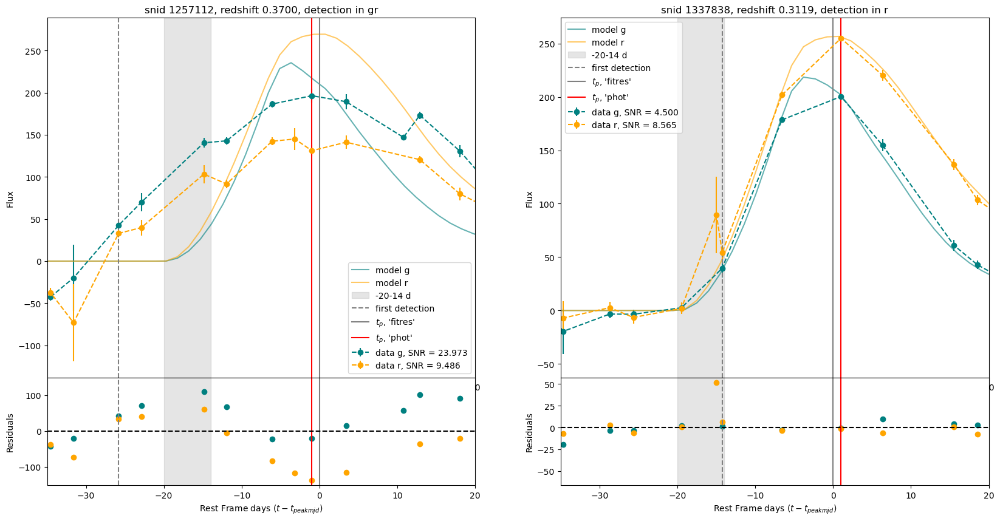

In [376]:
np.array(binstrs_unique_vis).reshape((1, 2))

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
for i in range(2):  
        plot_all_res(axes[i], np.array(snids_exflux)[excess_flux_cuts_x_vis_unique.astype(int)][i], 'fitres', binstrs_unique_vis[i])

/tmp/ipykernel_994968/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_994968/305493186.py:77: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  other_peak = peaks[np.logical_not(peaks == peak)]


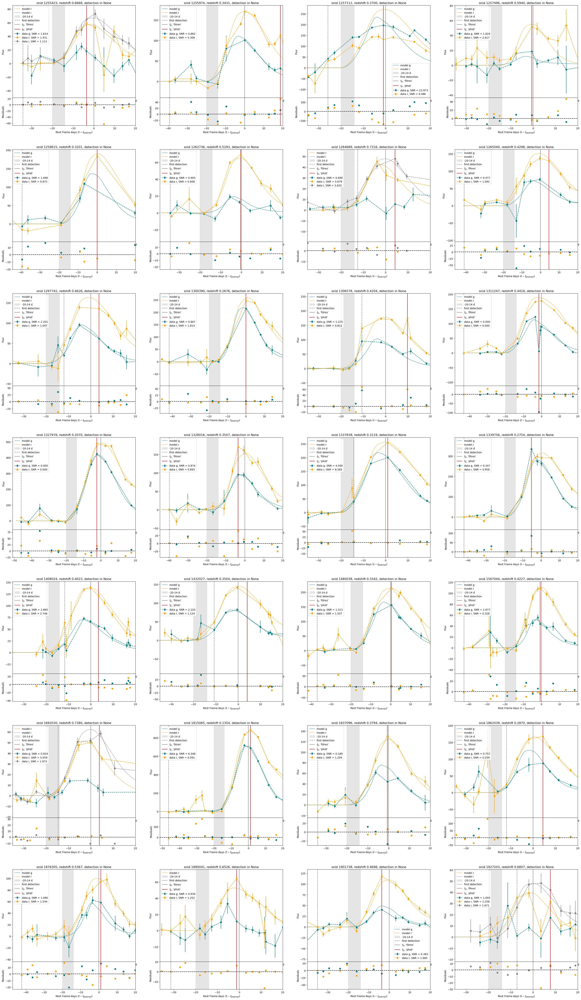

In [313]:
np.array(snids_exflux).reshape((7, 4))

fig, axes = plt.subplots(7, 4, figsize=(40, 70))
for i in range(7):  
    for j in range(4):  
        plot_all_res(axes[i,j], np.array(snids_exflux).reshape((7, 4))[i, j], peak='fitres')

In [ ]:
#### CHECKING OUR NEW GOOD SAMPLE FOR DETECTIONS ####

In [35]:
for m, k in enumerate(c_new): 
    test = detect_ex_flux(k, peak='fitres', th_pc=0.02) 
    print(m, test)

/tmp/ipykernel_704081/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew


0 (array([0., 0., 0.]), array([1.34138   , 3.55320007, 5.015     ]), array([1.89040983, 1.25574648, 1.35678709]))
1 (array([0., 0., 0.]), array([1.53070007, 2.7573999 , 2.61059998]), array([5.19266844, 7.83235502, 8.97522259]))
2 (array([1., 1., 0.]), array([1.26370003, 2.45039993, 2.10020004]), array([2.26985073, 8.26442432, 7.26263809]))
3 (array([0., 0., 0.]), array([17.465     , 14.7073999 , 11.23900024]), array([11.26869488,  5.94081354,  5.16154194]))
4 (array([1., 1., 1.]), array([1.84789993, 2.01800003, 2.09899994]), array([1.74661481, 3.3336668 , 2.49444699]))
5 (array([ 0., nan,  0.]), array([4.3423999 ,        nan, 5.71380005]), array([4.46205521,        nan, 5.51392078]))
6 (array([0., 0., 0.]), array([8.18039978, 9.44400024, 8.15539978]), array([ 6.97731256, 11.64616585,  5.71409464]))
7 (array([0., 0., 0.]), array([1.19666   , 2.6473999 , 2.16440002]), array([0.05718608, 7.11778355, 6.50878   ]))
8 (array([0., 1., 0.]), array([1.05012001, 1.07108002, 1.56740005]), array([

/global/common/software/nersc/pe/conda-envs/24.1.0/python-3.11/nersc-python/lib/python3.11/site-packages/scipy/interpolate/_interpolate.py:701: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


In [36]:
detects = np.array([detect_ex_flux(c_new[j], peak='fitres', th_pc=0.02)[0] for j in range(len(c_new))])
snrs = np.array([detect_ex_flux(c_new[j], peak='fitres', th_pc=0.02)[2] for j in range(len(c_new))])
detects_snrs = np.array(list(zip(detects, snrs)))

/tmp/ipykernel_704081/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew


In [37]:
np.where(detects > 0)
ind0 = np.where(detects > 0)[0]
ind1 = np.where(detects > 0)[1]

In [38]:
snrs_pos_detects = np.array([snrs[ind0[i]][ind1[i]] for i in range(len(ind0))])        # snrs of the positive detections --> how many of these are actually valid? 
snrs_pos_detects = snrs_pos_detects.astype('float')

In [39]:
snrs[redshifts_all[c_new.astype(int)] > z_gi], redshifts_all[c_new.astype(int)][redshifts_all[c_new.astype(int)] > z_gi]

(array([[0.92427522, 5.05893326, 1.87315702],
        [1.24323535,        nan, 2.56302476]]),
 array([0.738018, 0.873443], dtype='>f4'))

In [40]:
snrs_pos_detects[snrs_pos_detects > 4]       # snrs that are greater than 4 

array([ 8.26442432,  5.27020359, 10.69197464, 34.44408417,  5.68259668,
        5.41220379, 29.07011986, 40.97905731, 42.14406586, 11.67343616,
       13.57060051,  6.1761322 ,  6.92105913, 24.18574524, 62.7468338 ,
        6.36414051,  8.56493473,  5.96995592,  8.41903877, 12.66123199,
        7.83872747, 28.36668015, 19.82519531,  6.17736244,  7.20779085,
        4.51668787,  6.99973965,  5.97972059,  4.03294516,  6.64207935,
        4.91476774])

In [41]:
reds_4_detects = redshifts_all[c_new[ind0[snrs_pos_detects > 4]].astype(int)]
reds_4_detects

array([0.478026, 0.469491, 0.277836, 0.214916, 0.285131, 0.285131,
       0.348952, 0.348952, 0.348952, 0.179782, 0.459186, 0.459186,
       0.33754 , 0.177145, 0.181558, 0.261498, 0.31194 , 0.31194 ,
       0.1384  , 0.1384  , 0.408999, 0.119483, 0.320592, 0.428931,
       0.539439, 0.539439, 0.49183 , 0.337203, 0.348136, 0.348136,
       0.222105], dtype='>f4')

In [42]:
reds_4_detects[ind1[snrs_pos_detects > 4] == 2]      # some of these are DEF FALSE DETECTIONS! 
# reds_4_detects[ind1[snrs_pos_detects > 4] == 0]    # g band, r band look reasonable. maybe it's bc i band is lower snr? idk? 

array([0.348952, 0.179782, 0.261498, 0.31194 , 0.1384  , 0.119483,
       0.320592, 0.539439, 0.49183 , 0.222105], dtype='>f4')

In [43]:
ind0[snrs_pos_detects > 4], ind1[snrs_pos_detects > 4]
## check if the i band is valid -> i.e. if redshift really is > z_gi 

(array([ 2,  8, 12, 13, 14, 14, 16, 16, 16, 17, 21, 21, 22, 34, 40, 41, 42,
        42, 43, 43, 44, 50, 51, 52, 53, 53, 55, 57, 64, 64, 65]),
 array([1, 1, 0, 0, 0, 1, 0, 1, 2, 2, 0, 1, 0, 0, 0, 2, 1, 2, 1, 2, 1, 2,
        2, 1, 1, 2, 2, 1, 0, 1, 2]))

In [44]:
## number of unique sn 
np.unique(ind0[snrs_pos_detects > 4]).shape # 23
23 / len(c_new)

0.34328358208955223

In [45]:
## number of unique sn for gr band excess [the i's don't make sense given their redshift]
excess_flux_cuts_x = ind0[snrs_pos_detects > 4][ind1[snrs_pos_detects > 4] != 2]
excess_flux_cuts_x_unique = np.unique(excess_flux_cuts_x)

np.unique(ind0[snrs_pos_detects > 4][ind1[snrs_pos_detects > 4] != 2]).shape     # 17
17 / len(c_new)


0.2537313432835821

In [46]:
xy_excess_flux_cuts = list(zip(ind0[snrs_pos_detects > 4][ind1[snrs_pos_detects > 4] != 2], ind1[snrs_pos_detects > 4][ind1[snrs_pos_detects > 4] != 2]))
# ind0[snrs_pos_detects > 4][ind1[snrs_pos_detects > 4] != 2]
# ind1[snrs_pos_detects > 4][ind1[snrs_pos_detects > 4] != 2]
xy_excess_flux_cuts 

[(2, 1),
 (8, 1),
 (12, 0),
 (13, 0),
 (14, 0),
 (14, 1),
 (16, 0),
 (16, 1),
 (21, 0),
 (21, 1),
 (22, 0),
 (34, 0),
 (40, 0),
 (42, 1),
 (43, 1),
 (44, 1),
 (52, 1),
 (53, 1),
 (57, 1),
 (64, 0),
 (64, 1)]

In [47]:
def inds2bin(data):
    """ Given a list of tuples of indices (x, y) of detection where x is index number and y is 0, 1, or 2, return binary 000 - 111 
        that represents excess detection in each band.
    """
    # Step 1: Create a dictionary to group bands by SNID (x index) 
    snid_dict = {}
    for snid, band in data:    # the tuple
        if snid not in snid_dict:
            snid_dict[snid] = set()
        snid_dict[snid].add(band)
    
    # Step 2: Create binary strings
    binary_strings = []
    seen_snids = set()  # To keep track of seen SNIDs (x index)
    
    for snid in sorted(snid_dict.keys()):
        if snid in seen_snids:
            continue
        binary_string = ''.join('1' if i in snid_dict[snid] else '0' for i in range(3))
        binary_strings.append(binary_string)
        seen_snids.add(snid)
    
    return binary_strings

xs = np.array([xy_excess_flux_cuts[i][0] for i in range(len(xy_excess_flux_cuts))])
ys = np.array([xy_excess_flux_cuts[i][1] for i in range(len(xy_excess_flux_cuts))])
list(zip(np.unique(xs), inds2bin(xy_excess_flux_cuts)))

[(2, '010'),
 (8, '010'),
 (12, '100'),
 (13, '100'),
 (14, '110'),
 (16, '110'),
 (21, '110'),
 (22, '100'),
 (34, '100'),
 (40, '100'),
 (42, '010'),
 (43, '010'),
 (44, '010'),
 (52, '010'),
 (53, '010'),
 (57, '010'),
 (64, '110')]

In [53]:
xs = np.array([xy_excess_flux_cuts[i][0] for i in range(len(xy_excess_flux_cuts))])
ys = np.array([xy_excess_flux_cuts[i][1] for i in range(len(xy_excess_flux_cuts))])
# bins = np.array(['333'] * len(xs))
# bins_temp = np.array(['333'] * len(xs))
# # bins = []
# bins_fin = []
# bins = np.array(['000'] * len(xs))
# bins = np.array([''] * len(xs))
bins0 = np.zeros(len(xs))
bins = np.array(list(zip(bins, bins, bins)))

for i, tuple in enumerate(xy_excess_flux_cuts): 
    if xy_excess_flux_cuts[i][0] == xy_excess_flux_cuts[i-1][0]: 
        # bin = bins_temp[i-1]       # use same bin as previous 
        bin = bins[i-1]
        if xy_excess_flux_cuts[i-1][0] == xy_excess_flux_cuts[i-2][0]:  
            # bin = bins[i-1]   # this is the most far back it can go (max 3 detections); only replaced by i-1 again bc already has been replaced once
            # bin = bins_temp[i-2]
            bin = bins[i-2]
    else: 
        # bin = bins_temp[i] 
        bin = bins[i]
        
    if tuple[1] == 0:  
        # bin += '1'
        bin[0] = 1
    if tuple[1] == 1: 
        # bin += '01'    
        bin[1] = 1
    if tuple[1] == 2: 
        # bin += '001'
        bin[2] = 1    # in the case that the string IS mutable (or there is something else, another solution you can make) 
    
    print(i, tuple, bin)
    # bins_temp.append(bin)
    
    # now put it back in large array of FINAL BINS, same but in opposite manner 
    # if xy_excess_flux_cuts[i][0] == xy_excess_flux_cuts[i+1][0]:
    #     continue 
    #     if xy_excess_flux_cuts[i][0] == xy_excess_flux_cuts[i+2][0]: 
    #         continue 
    if i != len(xy_excess_flux_cuts) - 1: 
        if xy_excess_flux_cuts[i][0] != xy_excess_flux_cuts[i+1][0]: 
        # bins_fin[i] = bin   
            bins[i] = bin
            # print(i, bin)
        
    # actually don't need this bc you will just be replacing anyway...
#     if xy_excess_flux_cuts[i][0] == xy_excess_flux_cuts[i+2][0]:  
#         bins[i-1] = bin
            
#     if xy_excess_flux_cuts[i][0] == xy_excess_flux_cuts[i-1][0]: 
#         bins_fin[i-1] = bin 
       
    
#     if xs[i] != xs[i-1]:
#         bins[
#         else 
#         # new x 
    
#     if xs[i+1][0] != xs[i][0]:    # xy_excess_flux_cuts[i][0]
#         bins.append(bin)
        
# then get rid of all the '333' terms 

# create divider array? like get LAST indices of repeated x's

NameError: name 'bins' is not defined

In [48]:
## binary strings reshaped

binstrs_unique = inds2bin(xy_excess_flux_cuts)

binstrs_unique_new = np.append(binstrs_unique, [np.nan, np.nan, np.nan])
binstrs_unique_new_ = binstrs_unique_new.reshape((5, 4))

## flux ids reshaped
ids_ex_flux_cuts = c_new[excess_flux_cuts_x_unique]
ids_ex_flux_cuts_new = np.array(ids_ex_flux_cuts, dtype=object)

ids_ex_flux_cuts_new = np.append(ids_ex_flux_cuts_new, [np.nan, np.nan, np.nan])
ids_ex_flux_cuts_new_ = ids_ex_flux_cuts_new.reshape((5, 4))

# view both
binstrs_unique_new_, ids_ex_flux_cuts_new_

(array([['010', '010', '100', '100'],
        ['110', '110', '110', '100'],
        ['100', '100', '010', '010'],
        ['010', '010', '010', '010'],
        ['110', 'nan', 'nan', 'nan']], dtype='<U32'),
 array([[154, 267, 491, 493],
        [497, 547, 675, 698],
        [794, 926, 944, 952],
        [1006, 1295, 1302, 1451],
        [1585, nan, nan, nan]], dtype=object))

/tmp/ipykernel_1775656/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_1775656/305493186.py:77: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  other_peak = peaks[np.logical_not(peaks == peak)]


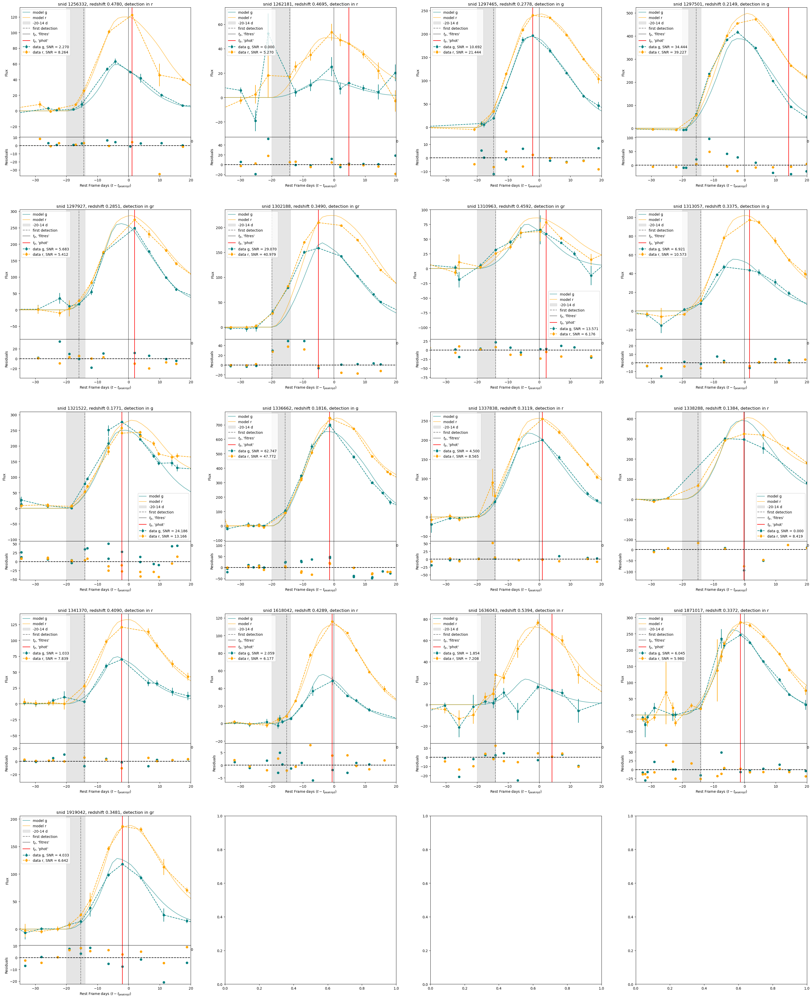

In [47]:
fig, axes = plt.subplots(5, 4, figsize=(40, 50))
for i in range(5): 
    for j in range(4):
        if i == 4: 
            if j == 1 or j == 2 or j == 3: 
                break
        plot_all_res(axes[i,j], ids_ex_flux_cuts_new_[i, j], peak='fitres', exflux=binstrs_unique_new_[i, j])

plt.savefig('finalcuts.pdf')


In [1]:
# for i, ex in enumerate(excess_flux_cuts_unique): 
#     fig, ax = plt.subplots(1, 1, figsize=(8,8))
#     plot_all_res(ax, c_new[ex], peak='fitres', exflux=binstrs_unique[i])

In [114]:
list([zip(i, detects[ind0[snrs_pos_detects > 4][i]][ind1[snrs_pos_detects > 4][i]] for i in range(31))])

SyntaxError: Generator expression must be parenthesized (343129469.py, line 1)

In [ ]:
for m, k in enumerate(c_new): 
    test = detect_ex_flux(k, peak='fitres', th_pc=0.02) 
    print(m, test)
    
## make dataframe with the snid, detects in each band, SNR for each band. 
# if SN > 4/5 for a detection, then use. 

In [29]:
detects = np.array([detect_ex_flux(c_new[j], peak='fitres', th_pc=0.02)[0] for j in range(len(c_new))])

detects_cp = detects.copy()
detects_cp[np.isnan(detects_cp)] = 0
np.sum(detects_cp, axis=1) > 0 

ex_flux_ids = cids[np.array(c_new, dtype=int)][np.sum(detects_cp, axis=1) > 0]

/tmp/ipykernel_527354/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew


In [32]:
np.intersect1d(ex_flux_ids, snids_exflux)

array([1337838])

In [31]:
ex_flux_ids

array([1256332, 1258330, 1262181, 1297465, 1297501, 1297927, 1302188,
       1303496, 1310963, 1313057, 1313698, 1318052, 1321522, 1336464,
       1336662, 1337649, 1337838, 1338288, 1341370, 1343533, 1512067,
       1519038, 1566028, 1618042, 1636043, 1643292, 1871017, 1900865,
       1905184, 1912066, 1919042, 1929063])

/tmp/ipykernel_1101889/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_1101889/1420893124.py:73: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  other_peak = peaks[np.logical_not(peaks == peak)]


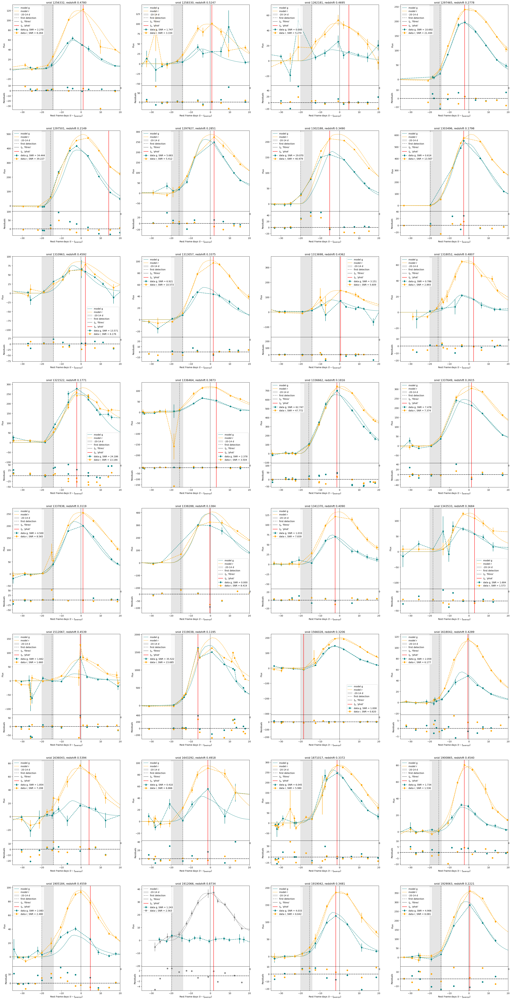

In [666]:
r = ex_flux_ids.reshape((8, 4))

fig, axes = plt.subplots(8, 4, figsize=(40, 80))
for i in range(8): 
    for j in range(4): 
        plot_all_res(axes[i, j], r[i, j], 'fitres')

plt.savefig('excess_flux.pdf')

## 5) Binning Redshifts

In [306]:
# fraction of redshift in each bin that is detected as excess early flux. 
u / r

array([0.21428571, 0.2972973 , 0.        ])

Text(0.5, 1.0, 'Final Cut SN Sample, Binned by Redshift')

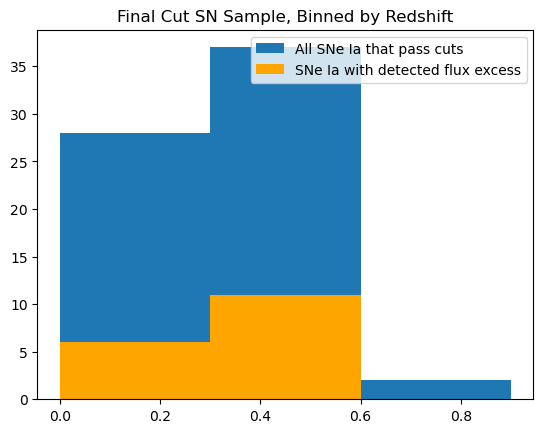

In [303]:
cut_redshifts = redshifts_all[np.array(c_new, dtype=int)]
r, g, h = plt.hist(cut_redshifts, bins=[0, 0.3, 0.6, 0.9], label='All SNe Ia that pass cuts')

exflux_redshifts = redshifts_all[c_new[excess_flux_cuts_unique].astype(int)]
u, j, k = plt.hist(exflux_redshifts, bins=[0, 0.3, 0.6, 0.9], color='orange', label='SNe Ia with detected flux excess')
plt.legend()
plt.title('Final Cut SN Sample, Binned by Redshift')
# plt.twinx()

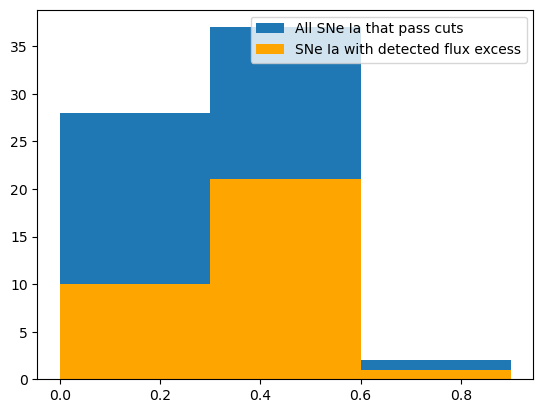

In [34]:
cut_redshifts = redshifts_all[np.array(c_new, dtype=int)]
r, g, h = plt.hist(cut_redshifts, bins=[0, 0.3, 0.6, 0.9], label='All SNe Ia that pass cuts')

exflux_redshifts = redshifts_all[np.array(c_new, dtype=int)[np.sum(detects_cp, axis=1) > 0]]
u, j, k = plt.hist(exflux_redshifts, bins=[0, 0.3, 0.6, 0.9], color='orange', label='SNe Ia with detected flux excess')
plt.legend()

## 6) Statistical Significance of Bump to Improve Detection ## 

Yeah, and rather than quantifying this as a percent threshold, we should think about quantifying whether the bump is statistically necessary, for example, in terms of the decrease in chi-squared when the bump is included.  
You can also use Bayesian model selection by calculating the odds ratio.

In [ ]:
I think the simplest thing to do is to use some sort of analytic model to fit the early light curves with and 
without an early bump (also modeled analytically).  
Then you can compare the chi-squared and compute the odds ratio.

* Use an analytical model like the ni ones? 
* Model with an early bump, and without an early bump 
    * 1) without is linear or exp or something
    * 2) With is gaussian ? 
* Then compare the chi-squared [for model with and without early bump for each] and compute odds ratio. 
Doing this in SNANA using SALT3 is a lot of work and probably not worth the time.
^ DO THIS FOR ALL THE LIGHT CURVES that pass the cuts. 

Yeah, something like that.  It’s not perfect because the bands cover different parts of the SED depending on redshift, 
but I can’t think of a better way that doesn’t involve SNANA.
If we find a large number of light curves with statistically significant bump, we will consider a more sophisticated approach.


SEE IF: 
* There is an analytical model out there for EARLY LIGHT CURVES with and without a bump. 
* If find a promising more interesting model, then can use MCMC. 

(Before)
One thing you could also try is to do a simple (polynomial?) fit to each early light curves excluding the times when the
blue bump is expected (if present).  For example, you can fit the points from t=-30 d to peak excluding t=-25 to -15 
(or something like that) and plot the residuals. 

In [60]:
peakmjds_fitres   # snana fit
peakmjds_all      # phot fit 

array([56530.3047, 56548.6055, 56532.5664, ..., 58128.0508, 58140.7188,
       58149.918 ])

In [62]:
## FIT TWO MODELS: (MCMC w/ emcee & Bayes, Chi-squared if linear, others?) 
# 1) "BUMPLESS" MODEL: POWER-LAW RISE = A(t - t0)^beta
    # fit for t0 too and compare to the values in the DES dataframe? 

# 2) "BUMP" MODEL: POWER-LAW RISE + GAUSSIAN = A(t - t0)^beta + gauss

""" From Wang et al. Flight of the Bumblebee: the Early Excess Flux of Type Ia Supernovae 2023bee

https://wrap.warwick.ac.uk/id/eprint/184086/1/WRAP-flight-of-the-bumblebee-the-early-excess-flux-Type-Ia-supernova-2023bee-revealed-TESS-Swift-Young-Supernova-Experiment-observations-2024.pdf
"""

def powerlaw(t, A, t0, beta): 
    return A*(t - t0)**beta            # no y-intercept term because flux is already calibrated

def powerlaw_gauss(t, A, t0, beta, B, sigma, mu): 
    return A*(t - t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-(t - mu)**2 / (2*sigma**2))

In [ ]:
## Run MCMC to fit each to a 1) powerlaw and 2) powerlaw + gaussian ==> parameters 


In [ ]:
## If bump is statistically necessary, then there will be a certain amount of 
## decrease in the chi-squared value from the model w/ bump compared to the bumpless model. 

# when running MCMC, return chi-squared? 
# also use bayesian model selection with odds ratio: -> what to use for prior 


In [ ]:
### fit only beginnng to up to 30% of max flux. -> i will do 40% because we have less points. actually just do -20-14d; this is easier.  
# Wang et al. uses lmfit (non-linear leaset squares fitting); make sure to use uncertainties too. 

mjds_interp_g, real_fluxes_g, real_fluxes_g_err
mjds_interp_r, real_fluxes_r, real_fluxes_r_err
mjds_interp_i, real_fluxes_i, real_fluxes_i_err

# get early flux data first: 
# ALTERNATIVELY: you could also use the rftimes from fitres and have t0 fixed, then fit just for A and beta. 

In [101]:
c_new = c_new.astype(int)
mjds_interp_g_cuts = [mjds_interp_g[c_new[i]] for i in range(len(c_new))]
real_fluxes_g_cuts = [real_fluxes_g[c_new[i]] for i in range(len(c_new))]
real_fluxes_g_err_cuts = [real_fluxes_g_err[c_new[i]] for i in range(len(c_new))]

# [mjds_interp_g_cuts[i][:np.where(np.isclose(real_fluxes_g_cuts[i], real_fluxes_g_cuts[i].max() * 0.4, atol=10))[0][0]] for i in range(len(c_new))]
# [real_fluxes_g_cuts[i][:np.where(np.isclose(real_fluxes_g_cuts[i], real_fluxes_g_cuts[i].max() * 0.4, atol=10))[0][0]] for i in range(len(c_new))]


In [132]:
x = [mjds_interp_g_cuts[i][:np.where(np.isclose(real_fluxes_g_cuts[i], real_fluxes_g_cuts[i].max() * 0.4, atol=10))[0][0]] for i in range(3)][2]
y = [real_fluxes_g_cuts[i][:np.where(np.isclose(real_fluxes_g_cuts[i], real_fluxes_g_cuts[i].max() * 0.4, atol=10))[0][0]] for i in range(3)][2]
yerr = [real_fluxes_g_err_cuts[i][:np.where(np.isclose(real_fluxes_g_cuts[i], real_fluxes_g_cuts[i].max() * 0.4, atol=10))[0][0]] for i in range(3)][2]
peakmjds_fitres[c_new][2]

56601.3867

In [131]:
from lmfit import Model

# data = loadtxt('model1d_gauss.dat')
# x = data[:, 0]
# y = data[:, 1]

# def gaussian(x, amp, cen, wid):
#     """1-d gaussian: gaussian(x, amp, cen, wid)"""
#     return (amp / (sqrt(2*pi) * wid)) * exp(-(x-cen)**2 / (2*wid**2))
# gmodel = Model(gaussian)

def powerlaw(t, A, t0, beta): 
    return A*(t - t0)**beta            # no y-intercept term because flux is already calibrated

def powerlaw_gauss(t, A, t0, beta, B, sigma, mu): 
    return A*(t - t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-(t - mu)**2 / (2*sigma**2))

plmodel = Model(powerlaw)
pl_gmodel = Model(powerlaw_gauss)
result1 = plmodel.fit(y, t=x, t0=peakmjds_fitres[c_new][2], beta=2)
result2 = pl_gmodel.fit(y, t=x, t0=peakmjds_fitres[c_new][2], beta=2, B=10, sigma=5, mu=peakmjds_fitres[c_new][2]+10)

print(result.fit_report())

plt.plot(x, y, 'o')
plt.plot(x, result.init_fit, '--', label='initial fit')
plt.plot(x, result.best_fit, '-', label='best fit')
plt.legend()
plt.show()

ModuleNotFoundError: No module named 'lmfit'

In [176]:
j = 10
cond = (-20 <= interp(c_new[j], 'g')['data'][:, 0]) & (interp(c_new[j], 'g')['data'][:, 0] <= -14) 
x = interp(c_new[j], 'g')['data'][:, 0][cond]
y = interp(c_new[j], 'g')['data'][:, 1][cond]
yerr = interp(c_new[j], 'g')['err'][cond]

/tmp/ipykernel_1655129/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew


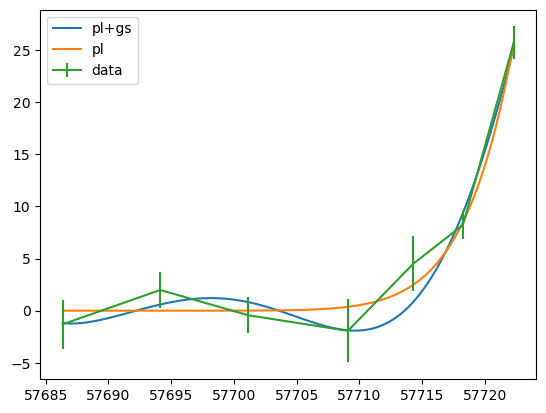

In [490]:
ts = np.linspace(mjds_interp_r[1295][:ind+1].min(), mjds_interp_r[1295][:ind+1].max(), 100)

plt.plot(ts, powerlaw_gauss_rf(ts, *popt2__), label='pl+gs')
plt.plot(ts, powerlaw_rf(ts, *popt1__), label='pl')
plt.errorbar(x, y, yerr, label='data')
plt.legend()

/tmp/ipykernel_1655129/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_1655129/305493186.py:77: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  other_peak = peaks[np.logical_not(peaks == peak)]


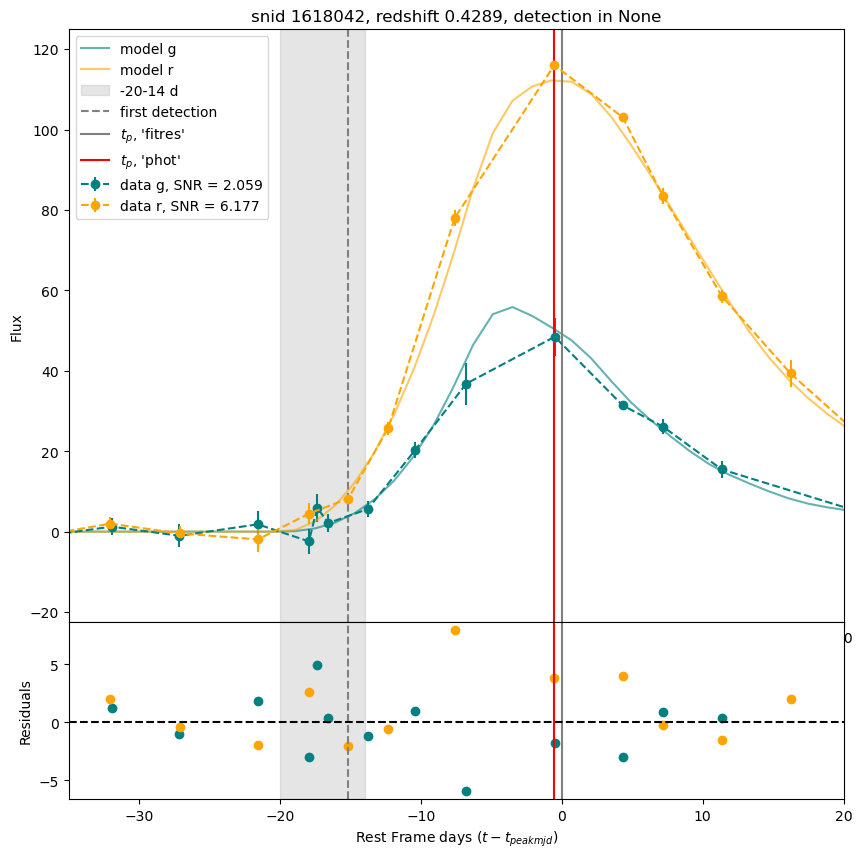

In [442]:
fig, ax = plt.subplots(figsize=(10, 10))
plot_all_res(ax, 1295, 'fitres')

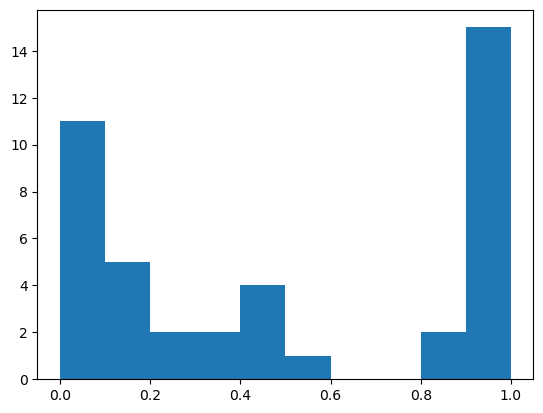

In [515]:
o = np.array([all_stats[i]['odds'] for i in range(len(all_stats)) if len(all_stats[i]['odds']) != 0])
a, b, c = plt.hist(o, bins=10)

In [531]:
r = [all_stats[i]['odds'] for i in range(len(all_stats))]
l = np.where([len(r[j]) != 0 for j in range(len(all_stats))])[0]

In [550]:
[all_stats[l[k]]['name'] for k in range(len(l))][0]

{'name': '149, r, 6',
 'popt1_': [array([2.42712829e-05, 4.64559579e+00])],
 'pcov1_': [array([[ 9.92594209e-09, -1.38353056e-04],
         [-1.38353056e-04,  1.93099739e+00]])],
 'popt2_': [array([ 2.52155936e-05,  4.63269456e+00, -1.48853286e+02,  1.11550350e+00,
          1.97397462e+00])],
 'pcov2_': [array([[inf, inf, inf, inf, inf],
         [inf, inf, inf, inf, inf],
         [inf, inf, inf, inf, inf],
         [inf, inf, inf, inf, inf],
         [inf, inf, inf, inf, inf]])],
 'odds': [0.054868728982656295],
 'data': [(56559.299, -11.123000144958496, 3.6110000610351562),
  (56564.31, -1.2640000581741333, 1.8969999551773071),
  (56568.272, 1.6440000534057617, 1.3519999980926514),
  (56576.191, 12.006999969482422, 1.5329999923706055),
  (56580.156, 32.983001708984375, 3.378999948501587)]}

In [571]:
popt1__, popt2__

(array([2.42712829e-05, 4.64559579e+00]),
 array([ 2.52155936e-05,  4.63269456e+00, -1.48853286e+02,  1.11550350e+00,
         1.97397462e+00]))

/tmp/ipykernel_1655129/254918245.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(j, figsize=(10, 10))


IndexError: index 0 is out of bounds for axis 0 with size 0

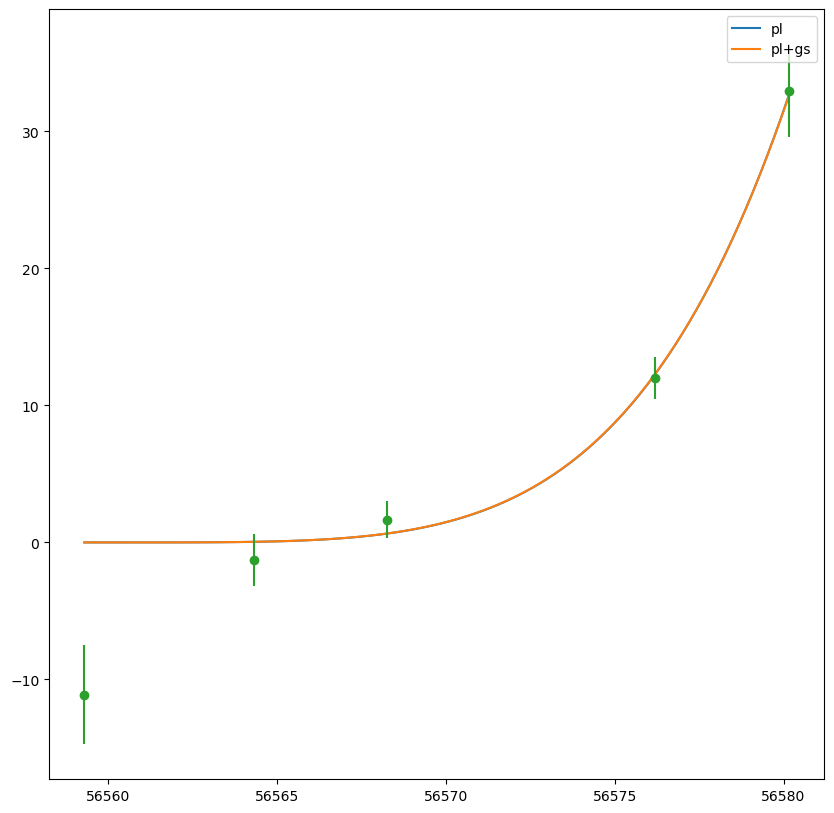

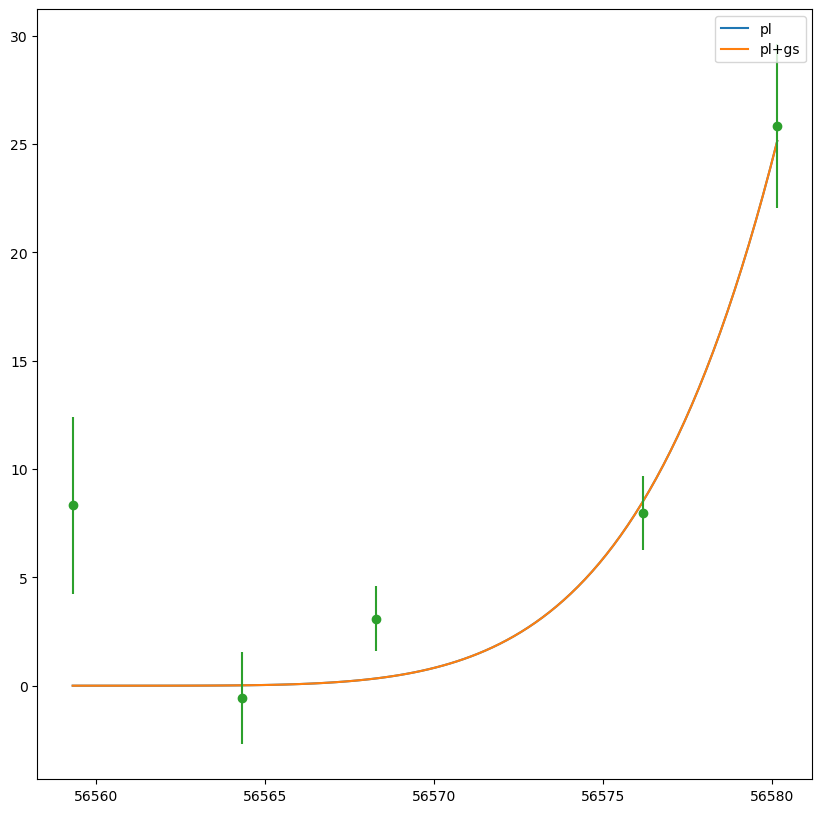

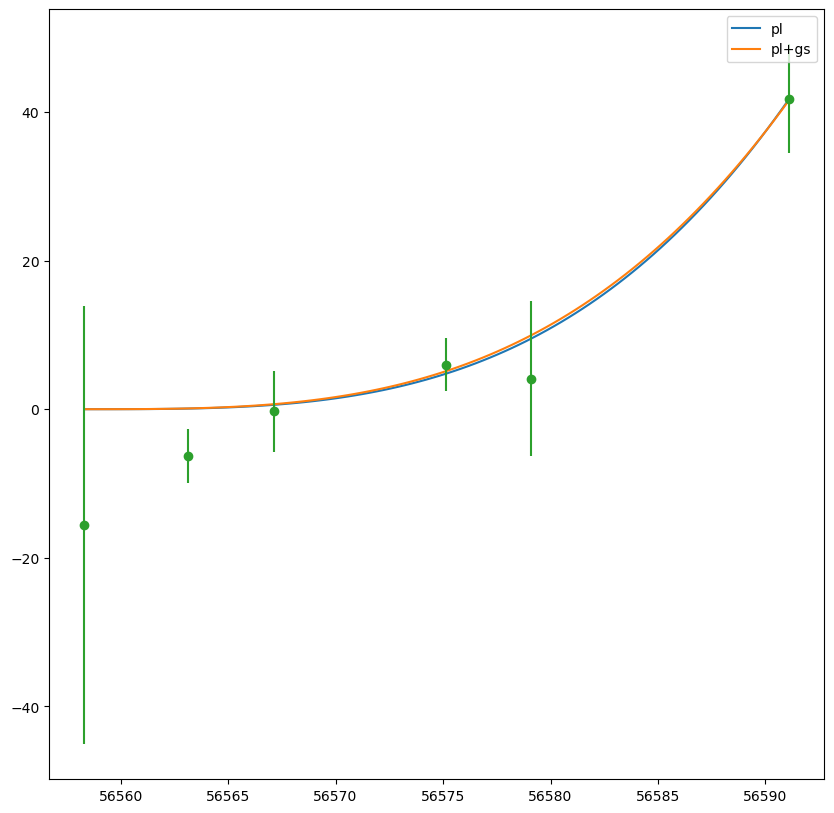

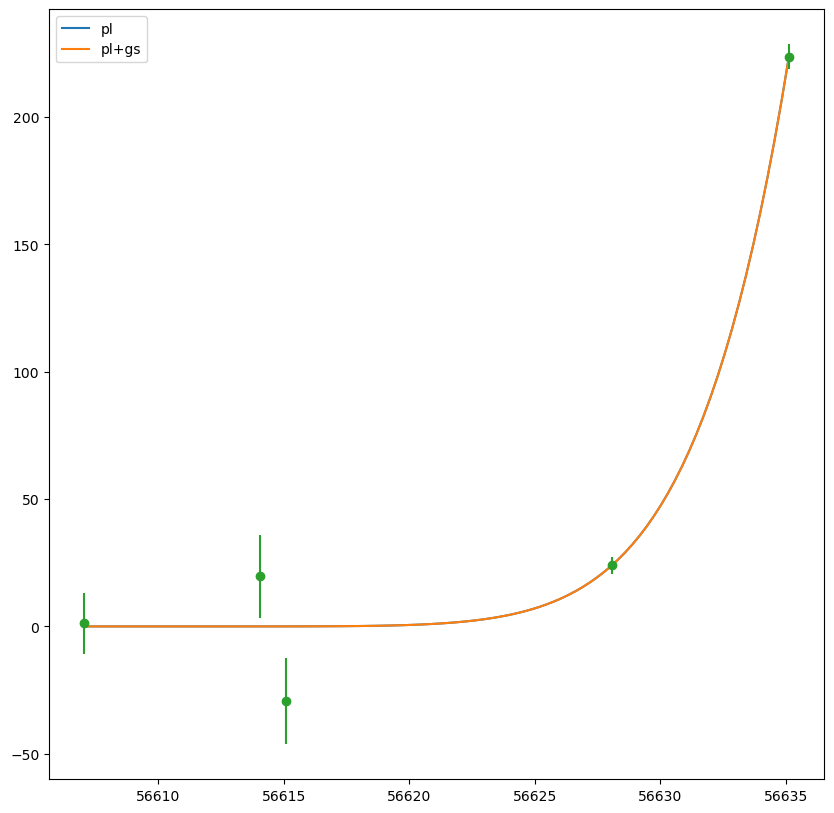

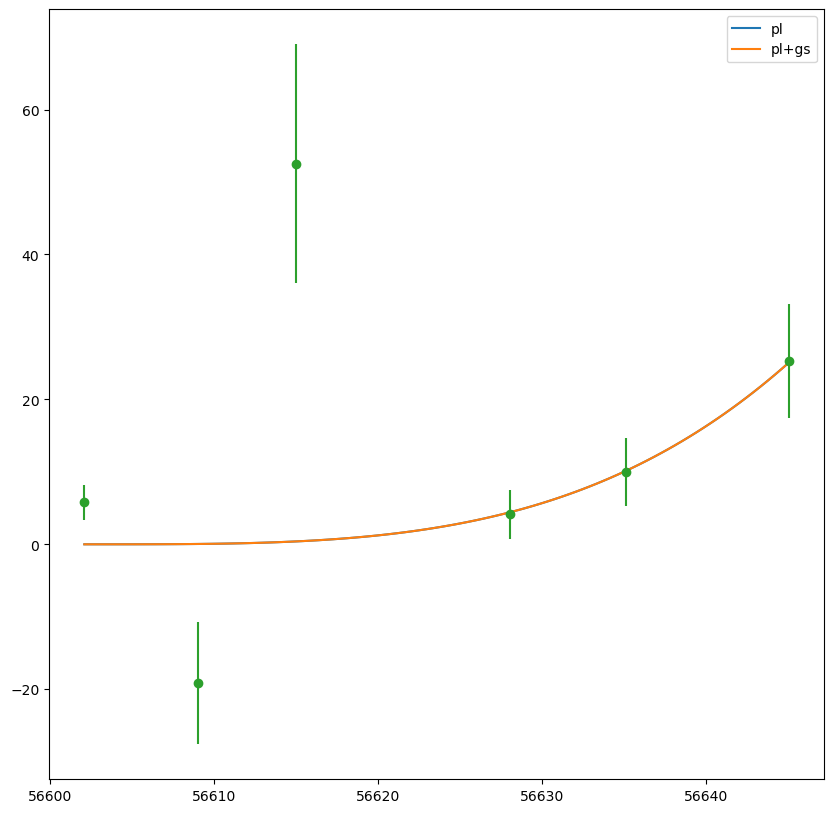

...

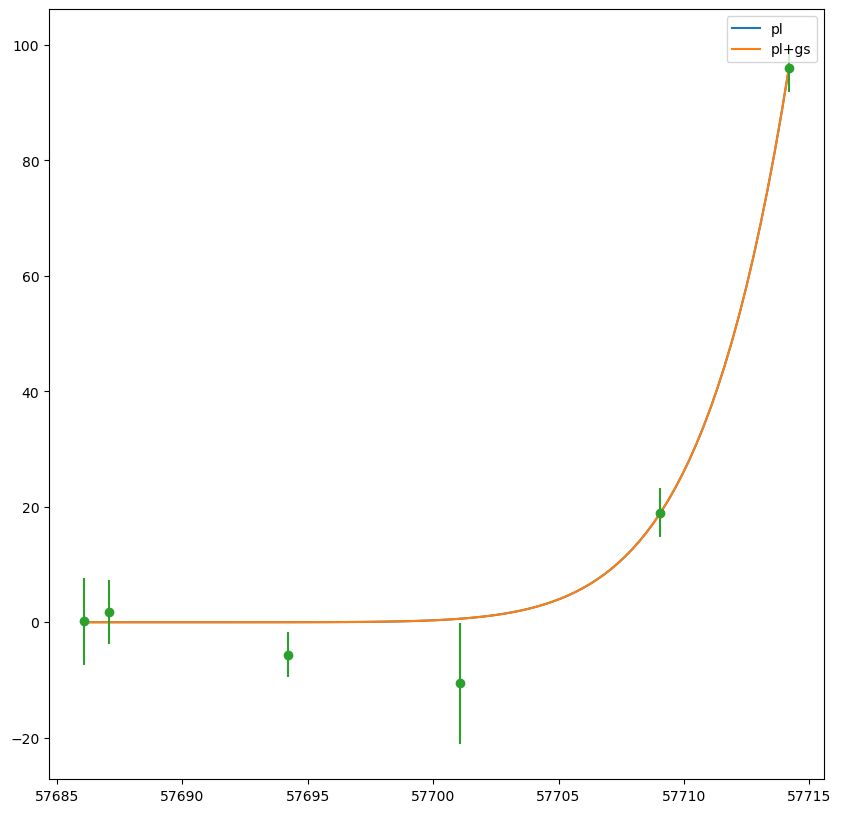

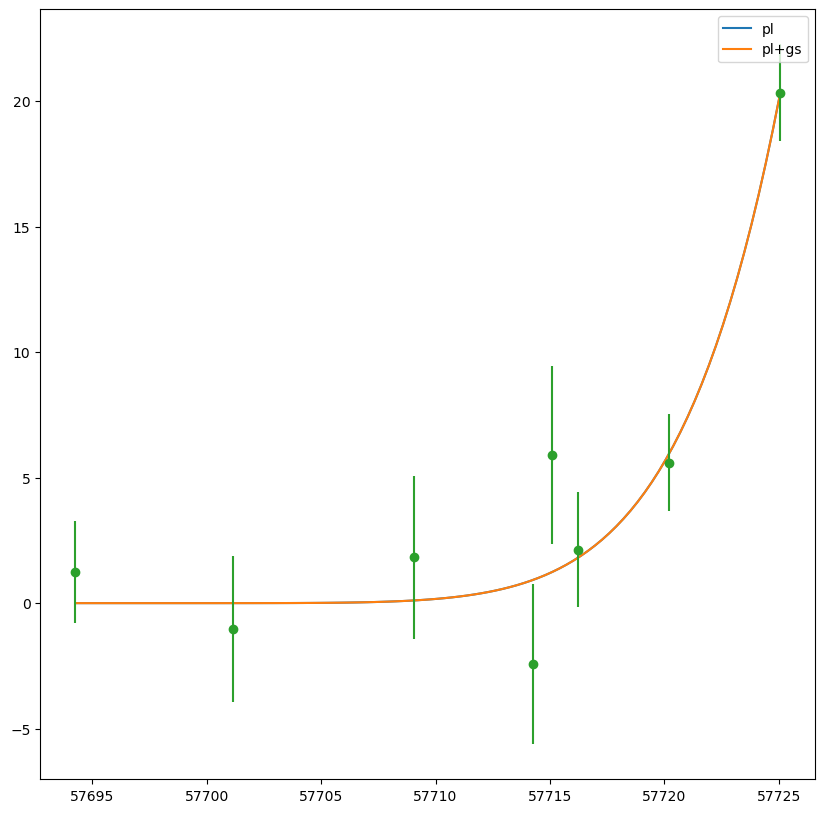

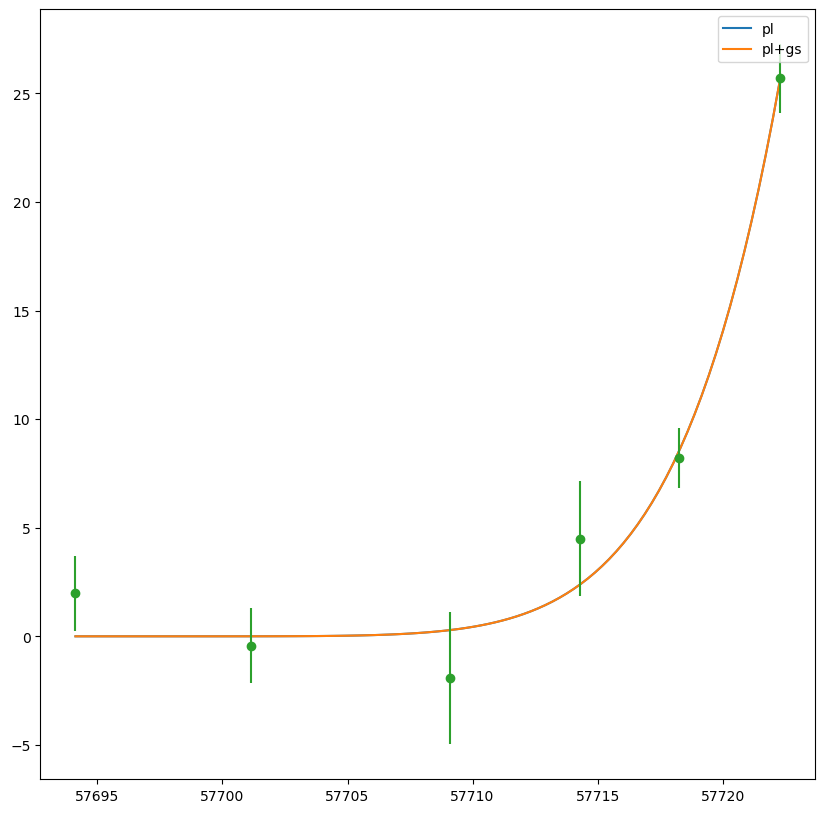

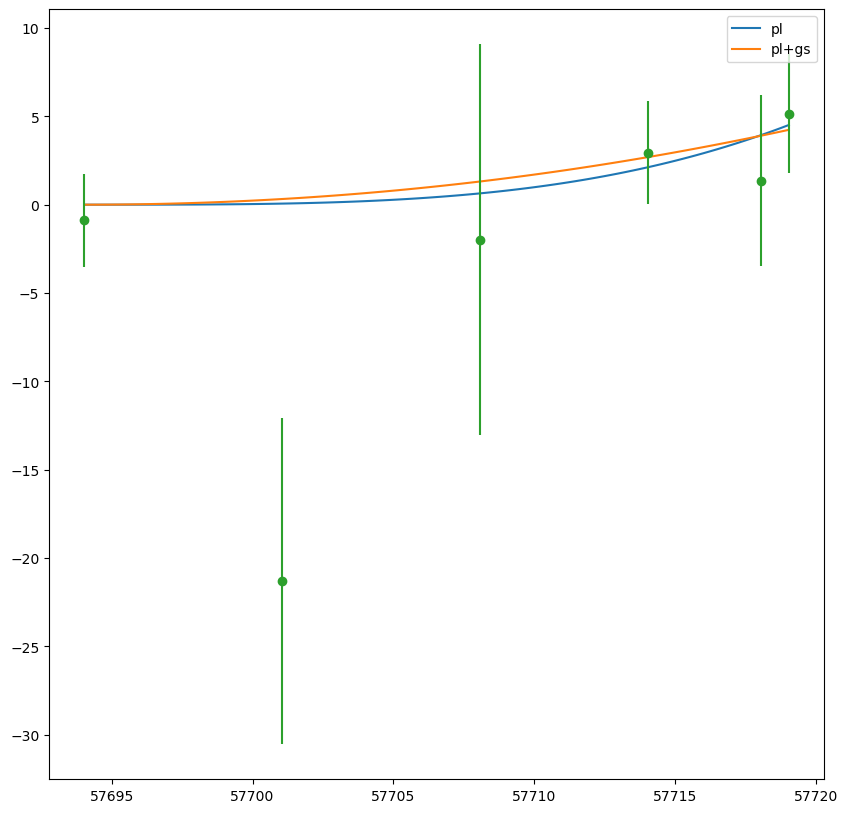

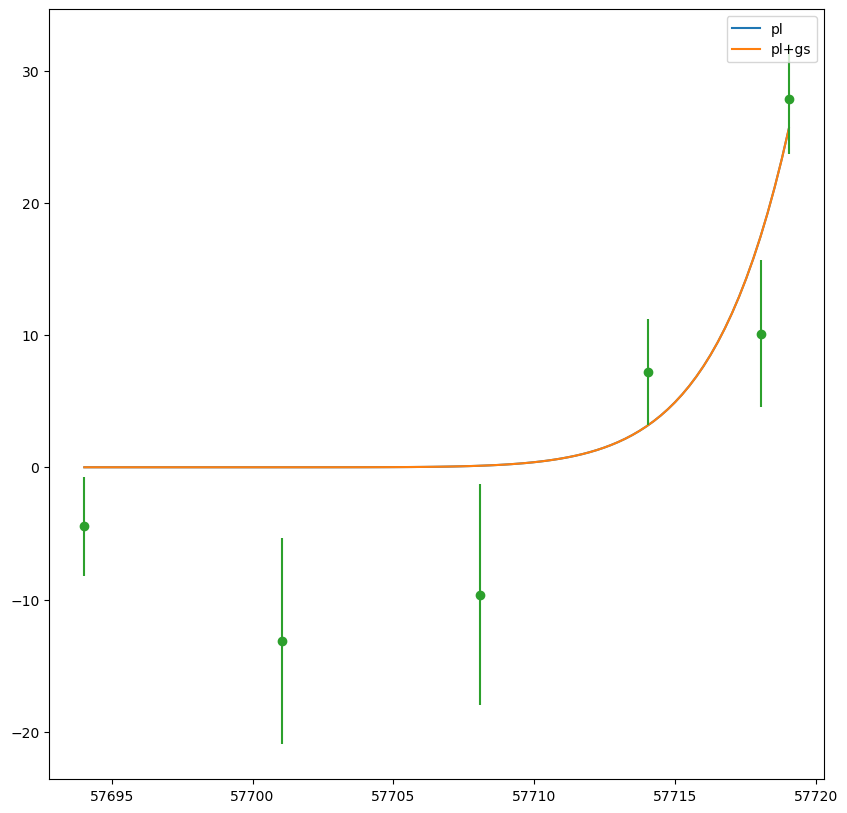

In [582]:
r = [all_stats[i]['odds'] for i in range(len(all_stats))]
l = np.where([len(r[j]) != 0 for j in range(len(all_stats))])[0]

j = 0 
for j in range(len(l)): 
    
    xs = np.array([all_stats[l[k]]['data'] for k in range(len(l))][j])[:, 0]
    ys = np.array([all_stats[l[k]]['data'] for k in range(len(l))][j])[:, 1]
    yerrs = np.array([all_stats[l[k]]['data'] for k in range(len(l))][j])[:, 2]

    ts = np.linspace(xs.min(), xs.max(), 100)

    popt1__ = np.array([all_stats[l[k]]['popt1_'] for k in range(len(l))][j])[0]
    popt2__ = np.array([all_stats[l[k]]['popt2_'] for k in range(len(l))][j])[0]

    def powerlaw_rf(t, A, beta): 
        return A*(t-t.min())**beta            
    def powerlaw_gauss_rf(t, A, beta, B, sigma, mu): 
        return A*(t-t.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))

    plt.figure(j, figsize=(10, 10))
    plt.plot(ts, powerlaw_rf(ts, *popt1__), label='pl')
    plt.plot(ts, powerlaw_gauss_rf(ts, *popt2__), label='pl+gs')
    plt.errorbar(xs, ys, yerrs, fmt='o')
    plt.legend()
# plt.xlim([56572, 56573])
# plt.ylim([2, 4])

746:, r, 6, pl, pl_gs
(1, 6)
57253.352 -4.544000148773193
successful pl: 746, r, 6, -220.078
Cannot fit pl + gs.


/tmp/ipykernel_1957936/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_1957936/3245161957.py:28: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta            # no y-intercept term because flux is already calibrated


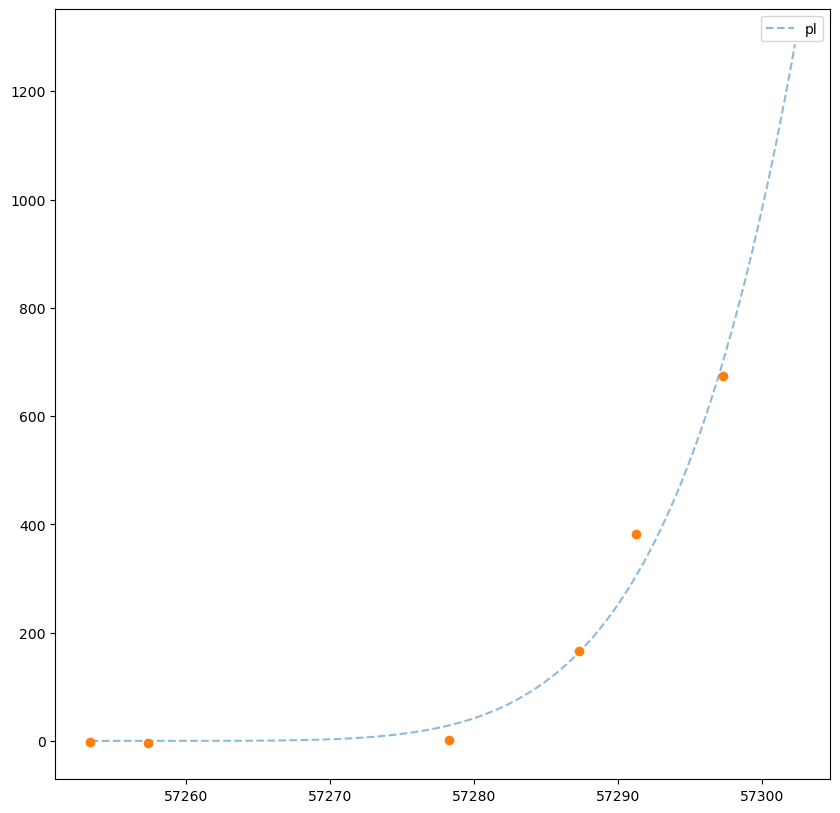

In [242]:
i = 30
filt = 'r'

from scipy import optimize

early_y = interp(c_new[i], filt)['data'][:, 1][interp(c_new[i], filt)['data'][:, 0] < 0]
        # ind = np.where(np.isclose(early_y, interp(c_new[i], filt)['data'][:, 1].max() * 0.4, atol=25))[0][0] 
       
# early light curves only 
# val = interp(c_new[i], filt)['data'][:, 1].max() * 0.4
# diffs = np.abs(early_y - val)

# ind = diffs.argmin()

# up until full peak
# ind = np.argmax(early_y)     # technically should just be the last one
ind = np.argmax(early_y) - 1

# add early index 
day = -30
diffs_day = np.abs(interp(c_new[i], filt)['data'][:, 0] - day)
ind_day = diffs_day.argmin()

ind_day = 1    # add this if you don't want to cut any earlier points off 
num_pts = ind - ind_day + 1

def powerlaw_rf(t, A, beta):                    # what if you fit for t0. 
    return A*(t-x.min())**beta            # no y-intercept term because flux is already calibrated
    # return A*(t-t0)**beta
    # return A*(t-t0)**beta + C 
    # think more about how to get more accurate measure for x.min...

def powerlaw_gauss_rf(t, A, beta, B, sigma, mu): 
    return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
    # return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2))
    # return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2)) + D

# if ind < 2: 
# if ind < 3:
params1 = inspect.signature(powerlaw_rf).parameters
params2 = inspect.signature(powerlaw_gauss_rf).parameters
l = len(params1) - 1
u = len(params2) - 1     

if num_pts < l: 
    print(f'{c_new[i]}:, {filt}, {num_pts}')
if l < num_pts < u: 
# if 2 < ind < 5: 
    print(f'{c_new[i]}:, {filt}, {num_pts}, pl') 
if num_pts >= u: 
# if ind >= 5: 
    print(f'{c_new[i]}:, {filt}, {num_pts}, pl, pl_gs') 

# print(f'{ind_day, ind}, points = {num_pts}')
print(f'{ind_day, ind}')

if filt == 'g': 
    x = mjds_interp_g[c_new[i]][ind_day:ind+1]
if filt == 'r': 
    x = mjds_interp_r[c_new[i]][ind_day:ind+1]
y = early_y[ind_day:ind+1]        # restrict range bc some early early points bad  
yerr = interp(c_new[i], filt)['err'][ind_day:ind+1]
if len(x) != 0: 
    print(x.min(), y.min()) 


popt1_, pcov1_ = [], []
popt2_, pcov2_ = [], []
odds_rat = []


# if 2 < ind < 5: 
if l < num_pts < u: 
    successful0 = False 
    try: 
        popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)
        popt1_.append(popt1), pcov1_.append(pcov1) 
        successful0 = True
    except: 
        print('Cannot fit pl.') 
    if successful0 == True: 
        lnlike1 = np.nan
        info1 = np.nan
        popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)

        lnlike1 = -0.5*np.sum(info1['fvec']**2) 
        print(f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}') 

# if ind >= 5: 
if num_pts >= u: 
    successful1 = False 
    try: 
        popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)
        popt1_.append(popt1), pcov1_.append(pcov1) 
        successful1 = True
    except: 
        print('Cannot fit pl.')
    if successful1 == True: 
        lnlike1 = np.nan
        info1 = np.nan
        popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)

        lnlike1 = -0.5*np.sum(info1['fvec']**2)
        # print('Successful pl.')
        print(f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}')

    successful2 = False 
    try: 
        # popt2 = np.nan
        popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss_rf, x, y, sigma=yerr, full_output=True)
        popt2_.append(popt2), pcov2_.append(pcov2) 
        successful2 = True
    except: 
        print('Cannot fit pl + gs.')  

    if successful2 == True: 
        lnlike2 = np.nan
        info2 = np.nan
        bounds=((-np.inf, -np.inf, 0, 0, 5), (np.inf, np.inf, np.inf, np.inf, np.inf))
        popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss_rf, x, y, sigma=yerr, bounds=bounds, full_output=True)

        lnlike2 = -0.5*np.sum(info2['fvec']**2)      
        print(f'successful pl + gs: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}, {lnlike2:.3f}')     
        odds_bump = lnlike2 / lnlike1
        odds_rat.append(odds_bump)
        print(f'odds ratio = {odds_bump:.3f}') 

# dict = {'name': f"{c_new[i]}, {filt}, {ind}",
#         'popt1_': popt1_, 
#         'pcov1_': pcov1_, 
#         'popt2_': popt2_, 
#         'pcov2_': pcov2_, 
#         'odds': odds_rat, 
#         'data': list(zip(x, y, yerr))}

# all_stats.append(dict)

plt.figure(figsize=(10, 10))
ts = np.linspace(x.min() - 5, x.max() + 5, 1000)
plt.plot(ts, powerlaw_rf(ts, *popt1), label='pl', ls='--', alpha=0.5)
# plt.plot(ts, powerlaw_gauss_rf(ts, *popt2), label='pl+gs', ls='--', alpha=0.5)
plt.errorbar(x, y, yerr, fmt='o')
# plt.axvline(x.min() + popt2[4], ls='--')
plt.legend()

In [289]:
import inspect
from scipy import optimize

def modelfit(i, filt): 
    """Fit both a 1) power law model and 2) power law + gaussian model to early light curves. 
    Inputs: index i, filter 'filt'
    Outputs: dictionary of parameters; plots 
    """
    if len(interp(c_new[i], filt)['data']) == 0: 
        return (f'No data for SN {c_new[i]}, band {filt}.')

    early_y = interp(c_new[i], filt)['data'][:, 1][interp(c_new[i], filt)['data'][:, 0] < 0]
            # ind = np.where(np.isclose(early_y, interp(c_new[i], filt)['data'][:, 1].max() * 0.4, atol=25))[0][0] 

    # early light curves only 
    # val = interp(c_new[i], filt)['data'][:, 1].max() * 0.4
    # diffs = np.abs(early_y - val)

    # ind = diffs.argmin()

    # up until full peak
    ind = np.argmax(early_y)     # technically should just be the last one
    # ind = np.argmax(early_y) - 1

    # add early index 
    day = -30
    diffs_day = np.abs(interp(c_new[i], filt)['data'][:, 0] - day)
    ind_day = diffs_day.argmin()

    # ind_day = 1    # add this if you don't want to cut any earlier points off 
    ind_day = 0
    num_pts = ind - ind_day + 1

    def powerlaw_rf(t, A, beta):                    # what if you fit for t0. 
        """power law fitting parameters: t, A, beta
        """
        return A*(t-x.min())**beta            # no y-intercept term because flux is already calibrated
        # return A*(t-t0)**beta
        # return A*(t-t0)**beta + C 
        # think more about how to get more accurate measure for x.min...

    def powerlaw_gauss_rf(t, A, beta, B, sigma, mu): 
        """ power law + gaussian fitting parameters: t, A, beta, B, sigma, mu
        """
        return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
        # return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2))
        # return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2)) + D

    # if ind < 2: 
    # if ind < 3:
    params1 = inspect.signature(powerlaw_rf).parameters
    params2 = inspect.signature(powerlaw_gauss_rf).parameters
    l = len(params1) - 1
    u = len(params2) - 1     

    if num_pts < l: 
        return (f'{c_new[i]}:, {filt}, {num_pts}')
    if l < num_pts < u: 
    # if 2 < ind < 5: 
        return (f'{c_new[i]}:, {filt}, {num_pts}, pl') 
    if num_pts >= u: 
    # if ind >= 5: 
        return (f'{c_new[i]}:, {filt}, {num_pts}, pl, pl_gs') 

    # print(f'{ind_day, ind}, points = {num_pts}')
    return (f'{ind_day, ind}')

    if filt == 'g': 
        x = mjds_interp_g[c_new[i]][ind_day:ind+1]
    if filt == 'r': 
        x = mjds_interp_r[c_new[i]][ind_day:ind+1]
    y = early_y[ind_day:ind+1]        # restrict range bc some early early points bad  
    yerr = interp(c_new[i], filt)['err'][ind_day:ind+1]
    if len(x) != 0: 
        return (f'x min = {x.min():.3f}, y min = {y.min():.3f}') 


    popt1_, pcov1_ = [], []
    popt2_, pcov2_ = [], []
    odds_rat = []


    if l < num_pts < u: 
        successful0 = False 
        try: 
            popt1, pcov1, info1, d1, e1 = None, None, None, None, None
            popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)
            popt1_.append(popt1), pcov1_.append(pcov1) 
            successful0 = True
        except: 
            return ('Cannot fit pl.') 
        if successful0 == True: 
            lnlike1 = np.nan
            info1 = np.nan
            popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)

            lnlike1 = -0.5*np.sum(info1['fvec']**2) 
            return (f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}') 
            return (f'A_pl = {np.format_float_scientific(popt1[0], precision=3, exp_digits=1)}, beta_pl = {popt1[1]:.3f}') 


    if num_pts >= u: 
        successful1 = False 
        try: 
            popt1, pcov1, info1, d1, e1 = None, None, None, None, None
            popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)
            popt1_.append(popt1), pcov1_.append(pcov1) 
            successful1 = True
        except: 
            return ('Cannot fit pl.')
        if successful1 == True: 
            lnlike1 = np.nan
            info1 = np.nan
            popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)

            lnlike1 = -0.5*np.sum(info1['fvec']**2)
            # print('Successful pl.')
            return (f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}')
            return (f'A_pl = {np.format_float_scientific(popt1[0], precision=3, exp_digits=1)}, beta_pl = {popt1[1]:.3f}') 

        successful2 = False 
        try: 
            # popt2 = np.nan
            popt2, pcov2, info2, d2, e2 = None, None, None, None, None
            popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss_rf, x, y, sigma=yerr, full_output=True)
            popt2_.append(popt2), pcov2_.append(pcov2) 
            successful2 = True
        except: 
            return ('Cannot fit pl + gs.')  

        if successful2 == True: 
            lnlike2 = np.nan
            info2 = np.nan
            bounds=((-np.inf, -np.inf, 0, 0, 10), (np.inf, np.inf, np.inf, np.inf, np.inf))
            # popt2 = None
            popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss_rf, x, y, bounds=bounds, full_output=True)

            lnlike2 = -0.5*np.sum(info2['fvec']**2)      
            return (f'successful pl + gs: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}, {lnlike2:.3f}')   
            odds_bump = None
            odds_bump = lnlike2 / lnlike1
            odds_rat.append(odds_bump)
            # print(f'odds ratio = {odds_bump:.3f}') 
            # print(f'x min = {x.min():.3f}, mu = {x.min() + popt2[-1]:.3f}')
            return (f'A_gs = {np.format_float_scientific(popt2[0], precision=3, exp_digits=1)}, beta_gs = {popt2[1]:.3f}, B = {popt2[2]:.3f}')
            return (f'mu = {popt2[-1]:.3f}, sig = {popt2[-2]:.3f}')

            return (f'odds ratio = {odds_bump:.3f}') 

    dict = {'name': f"{c_new[i]}, {filt}, {ind}",
            'popt1_': popt1_, 
            'pcov1_': pcov1_, 
            'popt2_': popt2_, 
            'pcov2_': pcov2_, 
            'odds': odds_rat, 
            'data': list(zip(x, y, yerr))}

    all_stats.append(dict)

    return dict 

    plt.figure(i, figsize=(10, 10))      
    ts = np.linspace(x.min() - 5, x.max() + 5, 1000)
    color = 'teal' if filt == 'g' else 'orange'

    if popt1 is not None: 
        plt.plot(ts, powerlaw_rf(ts, *popt1), label=f'pl, {filt}', ls='--', color=f'{color}', alpha=0.5)
    if popt2 is not None: 
        plt.plot(ts, powerlaw_gauss_rf(ts, *popt2), label=f'pl+gs, {filt}', ls='--', color=f'{color}', alpha=0.5)
        plt.axvline(x.min() + popt2[-1], ls='--', label=f"\mu = {x.min() + popt2[-1]}")
        plt.title(f'{c_new[i]}, {filt}, odds ratio = {odds_bump:.3f}')
    else: 
        plt.title(f'{c_new[i]}, {filt}')

    plt.errorbar(x, y, yerr, fmt='o', color=f'{color}')

#     if odds_bump is not None: 
#         plt.title(f'{c_new[i]}, {filt}, odds ratio = {odds_bump:.3f}')
    # else: 
    #     plt.title(f'{c_new[i]}, {filt}')

    plt.legend()

### A NEW FUNCTION ### 

* 0. FIX THE ODDS RATIO CALCULATION!!! 
* 1. Write function with 6 arguments: 0) index / id & filter, 1) fitting method, 2) initial point, 3) final point, 4) bounds for each model, 5) initial guess, 6) t0 true or false 

    * Do this for 
        i) all points
        ii) all points up to 40%. 
        iii) print and graph them. 
        iv) test lm, trf, dogbox.
        v) test t0 true or false. 
    * Then save to a dataframe. 

* 2. Save a data frame with index / id, params for each model (and each method), chi-squared for each model (and each method), odds ratio. 

In [76]:
import inspect
from scipy import optimize

# def modelfit(i, filt, method, init, final, bounds1, bounds2, p01, p02, t0=False): 
def modelfit(i, filt, method='lm', t0=False): 
    """ 
    Fitting powerlaw and powerlaw + gaussian models to early light curves. 
    Inputs: 
    Outputs: 
    Scipy methods: method{‘lm’, ‘trf’, ‘dogbox’}, optional
        Method to use for optimization. See least_squares for more details. 
        Default is ‘lm’ for unconstrained problems and ‘trf’ if bounds are provided. 
        The method ‘lm’ won’t work when the number of observations is less than the number of variables, 
        use ‘trf’ or ‘dogbox’ in this case.
    
    """

    if len(interp(c_new[i], filt)['data']) == 0: 
        return(f'No data for SN {c_new[i]}, band {filt}.')
        # print(f'No data for SN {c_new[i]}, band {filt}.')
        # return  

    early_y = interp(c_new[i], filt)['data'][:, 1][interp(c_new[i], filt)['data'][:, 0] < 0]
            # ind = np.where(np.isclose(early_y, interp(c_new[i], filt)['data'][:, 1].max() * 0.4, atol=25))[0][0] 

    # early light curves only 
    # val = interp(c_new[i], filt)['data'][:, 1].max() * 0.4
    # diffs = np.abs(early_y - val)

    # ind = diffs.argmin()

    # up until full peak
    ind = np.argmax(early_y)     # technically should just be the last one
    # ind = np.argmax(early_y) - 1

    # add early index 
    day = -30
    diffs_day = np.abs(interp(c_new[i], filt)['data'][:, 0] - day)
    ind_day = diffs_day.argmin()

    # ind_day = 1    # add this if you don't want to cut any earlier points off 
    ind_day = 0
    num_pts = ind - ind_day + 1

    #### add the option for index selection  

    ### 1) define power law models 
    def powerlaw_t0(t, A, beta, t0): 
        """ Power law fitting parameters: t, A, beta, t0
        """
        return A*(t-t0)**beta 

    def powerlaw_no_t0(t, A, beta): 
        """ Power law fitting parameters: t, A, beta
        """
        return A*(t-x.min())**beta 

    ### 2) define power law + gaussian models 
    def powerlaw_gauss_t0(t, A, beta, B, sigma, mu, t0): 
        """ Power law + gaussian fitting parameters: t, A, beta, B, sigma, mu, t0
        """
        return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2))

    def powerlaw_gauss_no_t0(t, A, beta, B, sigma, mu): 
        """ Power law + gaussian fitting parameters: t, A, beta, B, sigma, mu
        """
        return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))

    ### option for fitting for t0 
    if t0:
        powerlaw = powerlaw_t0
        powerlaw_gauss = powerlaw_gauss_t0 
    else:
        powerlaw = powerlaw_no_t0
        powerlaw_gauss = powerlaw_gauss_no_t0 

    ### get number of parameters for fitting 
    params1 = inspect.signature(powerlaw).parameters
    params2 = inspect.signature(powerlaw_gauss).parameters
    l = len(params1) - 1
    u = len(params2) - 1     

    print(f'{c_new[i]}:, {filt}, {num_pts}')
    
    # if method == 'lm': 
    #     if num_pts < l: 
    #         print(f'{c_new[i]}:, {filt}, {num_pts}')
    #     if l < num_pts < u: 
    #         print(f'{c_new[i]}:, {filt}, {num_pts}, pl') 
    #     if num_pts >= u: 
    #         print(f'{c_new[i]}:, {filt}, {num_pts}, pl, pl_gs') 

    # print(f'{ind_day, ind}, points = {num_pts}')
    print(f'{ind_day, ind}')

    if filt == 'g': 
        x = mjds_interp_g[c_new[i]][ind_day:ind+1]
    if filt == 'r': 
        x = mjds_interp_r[c_new[i]][ind_day:ind+1]
    y = early_y[ind_day:ind+1]        # restrict range bc some early early points bad  
    yerr = interp(c_new[i], filt)['err'][ind_day:ind+1]
    
    if len(x) != 0: 
        print(f'x min = {x.min():.3f}, y min = {y.min():.3f}') 


#     popt1_, pcov1_ = [], []
#     popt2_, pcov2_ = [], []
#     odds_rat = []
    
    if method != 'lm': 
        successful1 = False 
        try: 
            popt1, pcov1, info1, d1, e1 = None, None, None, None, None
            popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw, x, y, sigma=yerr, method=f'{method}', full_output=True)
            # popt1_.append(popt1), pcov1_.append(pcov1) 
            successful1 = True
        except: 
            print(e1, 'Cannot fit pl.')
        if successful1 == True: 
            lnlike1 = np.nan
            info1 = np.nan
            popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw, x, y, sigma=yerr, method=f'{method}', full_output=True)

            lnlike1 = -0.5*np.sum(info1['fvec']**2)
            # print('Successful pl.')
            print(f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}')
            print(f'A_pl = {np.format_float_scientific(popt1[0], precision=3, exp_digits=1)}, beta_pl = {popt1[1]:.3f}') 

        successful2 = False 
        try: 
            popt2, pcov2, info2, d2, e2 = None, None, None, None, None
            popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, method=f'{method}', full_output=True)
            # popt2_.append(popt2), pcov2_.append(pcov2) 
            successful2 = True
        except: 
            print(e2, 'Cannot fit pl + gs.')  
        if successful2 == True: 
            lnlike2 = np.nan
            info2 = np.nan
            bounds=((-np.inf, -np.inf, 0, 0, 10, x.min()), (np.inf, np.inf, np.inf, np.inf, np.inf, x.max()))
            # bounds = bounds2
            popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)

            lnlike2 = -0.5*np.sum(info2['fvec']**2)      
            print(f'successful pl + gs: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}, {lnlike2:.3f}')   
            odds_bump = None
            odds_bump = lnlike2 / lnlike1
            odds_rat.append(odds_bump)
            # print(f'odds ratio = {odds_bump:.3f}') 
            # print(f'x min = {x.min():.3f}, mu = {x.min() + popt2[-1]:.3f}')
            print(f'A_gs = {np.format_float_scientific(popt2[0], precision=3, exp_digits=1)}, beta_gs = {popt2[1]:.3f}, B = {popt2[2]:.3f}')
            print(f'mu = {popt2[4]:.3f}, sig = {popt2[3]:.3f}')

            print(f'odds ratio = {odds_bump:.3f}') 
        
    
    if method == 'lm': 
        if l < num_pts < u: 
            successful0 = False 
            try: 
                popt1, pcov1, info1, d1, e1 = None, None, None, None, None
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw, x, y, sigma=yerr, method=f'{method}', full_output=True)
                # popt1_.append(popt1), pcov1_.append(pcov1) 
                successful0 = True
            except: 
                print(e1, 'Cannot fit pl.') 
            if successful0 == True: 
                lnlike1 = np.nan
                info1 = np.nan
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw, x, y, sigma=yerr, method=f'{method}', full_output=True)

                lnlike1 = -0.5*np.sum(info1['fvec']**2) 
                print(f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}') 
                print(f'A_pl = {np.format_float_scientific(popt1[0], precision=3, exp_digits=1)}, beta_pl = {popt1[1]:.3f}') 

        if num_pts >= u: 
            successful1 = False 
            try: 
                popt1, pcov1, info1, d1, e1 = None, None, None, None, None
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw, x, y, sigma=yerr, method=f'{method}', full_output=True)
                # popt1_.append(popt1), pcov1_.append(pcov1) 
                successful1 = True
            # except: 
            #     print(e1, 'Cannot fit pl.')
            except RuntimeError as e: 
                print(e)
            if successful1 == True: 
                lnlike1 = np.nan
                info1 = np.nan
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw, x, y, sigma=yerr, method=f'{method}', full_output=True)

                lnlike1 = -0.5*np.sum(info1['fvec']**2)
                # print('Successful pl.')
                print(f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}')
                print(f'A_pl = {np.format_float_scientific(popt1[0], precision=3, exp_digits=1)}, beta_pl = {popt1[1]:.3f}') 

            successful2 = False 
            try: 
                popt2, pcov2, info2, d2, e2 = None, None, None, None, None
                popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, method=f'{method}', full_output=True)
                # popt2_.append(popt2), pcov2_.append(pcov2) 
                successful2 = True
            except: 
                print(info2, d2, e2, 'Cannot fit pl + gs.')  

            if successful2 == True: 
                lnlike2 = np.nan
                info2 = np.nan
                bounds=((-np.inf, -np.inf, 0, 0, 10, 0), (np.inf, np.inf, np.inf, np.inf, np.inf, np.inf))
                popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)

                lnlike2 = -0.5*np.sum(info2['fvec']**2)      
                print(f'successful pl + gs: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}, {lnlike2:.3f}')   
                odds_bump = lnlike2 / lnlike1
                odds_rat.append(odds_bump)
                print(f'A_gs = {np.format_float_scientific(popt2[0], precision=3, exp_digits=1)}, beta_gs = {popt2[1]:.3f}, B = {popt2[2]:.3f}')
                print(f'mu = {popt2[4]:.3f}, sig = {popt2[3]:.3f}')

                print(f'odds ratio = {odds_bump:.3f}') 

#     dict = {'name': f"{c_new[i]}, {filt}, {ind}",
#             'popt1_': popt1_, 
#             'pcov1_': pcov1_, 
#             'popt2_': popt2_, 
#             'pcov2_': pcov2_, 
#             'odds': odds_rat, 
#             'data': list(zip(x, y, yerr))}

#     all_stats.append(dict)
    
#     # return dict 
#     return popt1, popt2, odds_bump 



In [55]:
c_new

array([93, 149, 154, 189, 201, 214, 250, 260, 267, 268, 290, 440, 491,
       493, 497, 516, 547, 574, 607, 655, 661, 675, 698, 703, 704, 717,
       718, 719, 729, 733, 746, 750, 789, 792, 794, 832, 853, 887, 908,
       922, 926, 941, 944, 952, 1006, 1009, 1016, 1026, 1175, 1201, 1207,
       1257, 1295, 1302, 1304, 1317, 1349, 1451, 1481, 1525, 1539, 1562,
       1567, 1572, 1585, 1608, 1628], dtype=object)

In [250]:
#### TESTING / EDITED ### ==> CHANGE THE FUNCTION FOR THIS. 
i = -1
filt = 'g'
t0 = False
method = 'trf'
print(f't0 = {t0}')

if len(interp(c_new[i], filt)['data']) == 0: 
    print(f'No data for SN {c_new[i]}, band {filt}.')
    # print(f'No data for SN {c_new[i]}, band {filt}.')
    # return  

early_y = interp(c_new[i], filt)['data'][:, 1][interp(c_new[i], filt)['data'][:, 0] < 0]
        # ind = np.where(np.isclose(early_y, interp(c_new[i], filt)['data'][:, 1].max() * 0.4, atol=25))[0][0] 

# early light curves only 
# val = interp(c_new[i], filt)['data'][:, 1].max() * 0.4
# diffs = np.abs(early_y - val)

# ind = diffs.argmin()

# up until full peak
ind = np.argmax(early_y)     # technically should just be the last one
# ind = np.argmax(early_y) - 1

# add early index 
day = -30
diffs_day = np.abs(interp(c_new[i], filt)['data'][:, 0] - day)
ind_day = diffs_day.argmin()

# ind_day = 1    # add this if you don't want to cut any earlier points off 
ind_day = 0
num_pts = ind - ind_day + 1


### 1) define power law models 
def powerlaw_t0(t, A, beta, t0): 
    """ Power law fitting parameters: t, A, beta, t0
    """
    return A*(t-t0)**beta 

def powerlaw_no_t0(t, A, beta): 
    """ Power law fitting parameters: t, A, beta
    """
    return A*(t-x.min())**beta 

### 2) define power law + gaussian models 
def powerlaw_gauss_t0(t, A, beta, B, sigma, mu, t0): 
    """ Power law + gaussian fitting parameters: t, A, beta, B, sigma, mu, t0
    """
    return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2))

def powerlaw_gauss_no_t0(t, A, beta, B, sigma, mu): 
    """ Power law + gaussian fitting parameters: t, A, beta, B, sigma, mu
    """
    return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))

### option for fitting for t0 
if t0:
    powerlaw = powerlaw_t0
    powerlaw_gauss = powerlaw_gauss_t0 
else:
    powerlaw = powerlaw_no_t0
    powerlaw_gauss = powerlaw_gauss_no_t0 

### get number of parameters for fitting 
params1 = inspect.signature(powerlaw).parameters
params2 = inspect.signature(powerlaw_gauss).parameters
l = len(params1) - 1
u = len(params2) - 1     

print(f'{c_new[i]}: {filt}, {num_pts}')
print(f'{ind_day, ind}')

if filt == 'g': 
    x = mjds_interp_g[c_new[i]][ind_day:ind+1]
if filt == 'r': 
    x = mjds_interp_r[c_new[i]][ind_day:ind+1]
y = early_y[ind_day:ind+1]        # restrict range bc some early early points bad  
yerr = interp(c_new[i], filt)['err'][ind_day:ind+1]

if len(x) != 0: 
    print(f'x min = {x.min():.3f}, y min = {y.min():.3f}') 

successful1 = False 
try: 
    popt1, pcov1, info1, d1, e1 = None, None, None, None, None
    popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw, x, y, sigma=yerr, method=f'{method}', full_output=True)
    successful1 = True
# except: 
#     print(e1, 'Cannot fit pl.')
except RuntimeError as e: 
    print(e)
if successful1 == True: 
    like1 = np.nan
    info1 = np.nan
    bounds=((0, 0), (np.inf, np.inf))
    popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw, x, y, sigma=yerr, method=f'{method}', full_output=True)

    chi21 = np.sum(info1['fvec']**2)
    dof1 = num_pts - l 
    r_chi21 = chi21 / dof1       # NDF = k − n_p
    
    like1 = np.exp(-chi21/2)
    # print(f'successful pl: {c_new[i]}, {filt}, {ind}, {like1:.3f}')
    print('successful pl!')
    print(f'chi21 = {chi21:.3f}, r_chi21 = {r_chi21:.3f}')
    print(f'A_pl = {np.format_float_scientific(popt1[0], precision=3, exp_digits=1)}, beta_pl = {popt1[1]:.3f}') 

successful2 = False 
try: 
    popt2, pcov2, info2, d2, e2 = None, None, None, None, None
    popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, method=f'{method}', full_output=True)
    successful2 = True
# except: 
#     print(info2, d2, e2, 'Cannot fit pl + gs.')  
except RuntimeError as e: 
    print(e)

if successful2 == True: 
    like2 = np.nan
    info2 = np.nan
    if t0: 
        bounds=((0, 0, 10, 10, 10, x.min()), (np.inf, np.inf, np.inf, np.inf, np.inf, x.max()))
    else: 
        bounds=((0, 0, 10, 10, 10), (np.inf, np.inf, np.inf, np.inf, np.inf))
    p0 = False
    if p0: 
        p0 = np.array((1, 1, 10, 10, 10)) 
        popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, p0=p0, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)
    else: 
        popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)
        
    chi22 = np.sum(info2['fvec']**2) 
    dof2 = num_pts - u 
    r_chi22 = chi22 / dof2 
    
    like2 = np.exp(-chi22/2)
    print('successful pl + gs!')
    print(f'chi22 = {chi22:.3f}, r_chi22 = {r_chi22:.3f}')
    # print(f'like2 = {np.format_float_scientific(like1, precision=3, exp_digits=1)}, {np.format_float_scientific(like2, precision=3, exp_digits=1)}')   
    odds_bump = like2 / like1
    # odds_rat.append(odds_bump)
    print(f'A_gs = {np.format_float_scientific(popt2[0], precision=3, exp_digits=1)}, beta_gs = {popt2[1]:.3f}, B = {popt2[2]:.3f}, mu = {popt2[4]:.3f}, sig = {popt2[3]:.3f}')

    print(f'odds ratio (bump/no bump) = {odds_bump:.3f}')

t0 = False
1628: g, 9
(0, 8)
x min = 58093.046, y min = -1.616
successful pl!
chi21 = 173.584, r_chi21 = 24.798
A_pl = 1.852e-6, beta_pl = 4.712
successful pl + gs!
chi22 = 173.584, r_chi22 = 43.396
A_gs = 1.852e-6, beta_gs = 4.712, B = 10.000, mu = 13.451, sig = 3593317.608
odds ratio (bump/no bump) = 1.000


/tmp/ipykernel_623798/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew


In [225]:
powerlaw_gauss?

Signature: powerlaw_gauss(t, A, beta, B, sigma, mu)
Docstring:
Power law + gaussian fitting parameters: t, A, beta, B, sigma, mu
    
File:      /tmp/ipykernel_623798/654097424.py
Type:      function

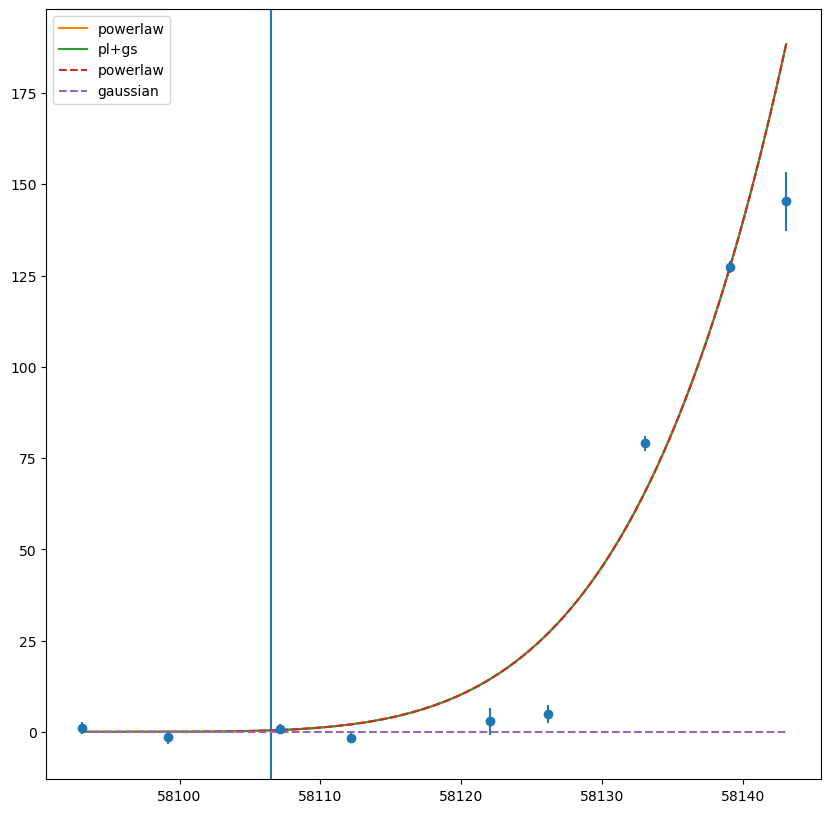

In [253]:
def pl_no_t0(t, A, beta): 
    return A*(t-x.min())**beta
def pl_t0(t, A, beta, t0): 
    return A*(t-t0)**beta

def gs_no_t0(t, B, sigma, mu): 
    return (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
def gs_t0(t, B, sigma, mu, t0): 
    return (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2))

if t0:
    pl = pl_t0
    gs = gs_t0 
else:
    pl = pl_no_t0
    gs = gs_no_t0

plt.figure(figsize=(10, 10))
plt.errorbar(x, y, yerr, fmt='o')
ts = np.linspace(x.min(), x.max(), 300)
plt.plot(ts, powerlaw(ts, *popt1), label='powerlaw')
plt.plot(ts, powerlaw_gauss(ts, *popt2), label='pl+gs')
plt.legend()

# change this plotting part here 
res = optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)[0]

plt.axvline(x.min() + res[-1])

plt.plot(ts, pl(ts, optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)[0][0], 
                optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)[0][1]), '--', label='powerlaw')


plt.plot(ts, gs(ts, res[2], res[3], res[4]), '--', label='gaussian')


# plt.xlim([(x.min() + res[-1] - 5), x.min() + res[-1] + 5])
# plt.ylim([0, 1])
plt.legend()

In [ ]:
### PLOT THE MODEL FITS SEPARATELY #### 

     count += 1
        
        plt.figure(count, figsize=(10, 10))
        ts = np.linspace(x.min() - 5, x.max() + 5, 1000)
        color = 'teal' if filt == 'g' else 'orange'
        
        def pl(t, A, beta): 
            return A*(t-x.min())**beta
        
        def gs(t, B, sigma, mu): 
            return (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
        
        if popt1 is not None: 
            # plt.plot(ts, powerlaw_rf(ts, *popt1), label=f'pl, {filt}', ls='--', color=f'{color}', alpha=0.5)
            plt.plot(ts, powerlaw_rf(ts, *popt1), label=f'pl, {filt}', ls='-', color='red', alpha=0.8)
            plt.axvline(popt1[2], ls='-', color='red', alpha=0.5, label=f't0_pl = {popt1[2]:.3f}')
        if popt2 is not None: 
            # plt.plot(ts, powerlaw_gauss_rf(ts, *popt2), label=f'pl+gs, {filt}', ls='--', color=f'{color}', alpha=0.5)
            plt.plot(ts, powerlaw_gauss_rf(ts, *popt2), label=f'pl+gs, {filt}', ls='-', color='teal', alpha=0.5)
            # plt.axvline(x.min() + popt2[-1], ls='--', label=f"\mu = {x.min() + popt2[-1]}")
            plt.axvline(x.min() + popt2[-1], ls='-', color='grey', alpha=0.5, label=f"$\mu = {popt2[-1]:.3f}$")
            plt.axvline(popt2[5], ls='-', color='blue', alpha=0.5, label=f't0_pl_gs = {popt2[2]:.3f}')
            
            plt.title(f'{c_new[i]}, {filt}, odds ratio = {odds_bump:.3f}')
            # overplot the gaussian individually and the power law inidividually
            plt.plot(ts, pl(ts, popt2[0], popt2[1]), ls=':', color='blue', label='pl portion')
            plt.plot(ts, gs(ts, popt2[2], popt2[3], popt2[4]), ls='--', color='blue', label='gs portion')
            
        else: 
            plt.title(f'{c_new[i]}, {filt}')

        plt.errorbar(x, y, yerr, fmt='o', color=f'{color}')

    #     if odds_bump is not None: 
    #         plt.title(f'{c_new[i]}, {filt}, odds ratio = {odds_bump:.3f}')
        # else: 
        #     plt.title(f'{c_new[i]}, {filt}')

        plt.legend()
    

In [354]:
"""method{‘lm’, ‘trf’, ‘dogbox’}, optional
Method to use for optimization. See least_squares for more details. 
Default is ‘lm’ for unconstrained problems and ‘trf’ if bounds are provided. 
The method ‘lm’ won’t work when the number of observations is less than the number of variables, 
use ‘trf’ or ‘dogbox’ in this case."""

SyntaxError: unterminated string literal (detected at line 5) (1587091606.py, line 5)

/tmp/ipykernel_1957936/2884600292.py:20: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
/tmp/ipykernel_1957936/1590131992.py:6: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta


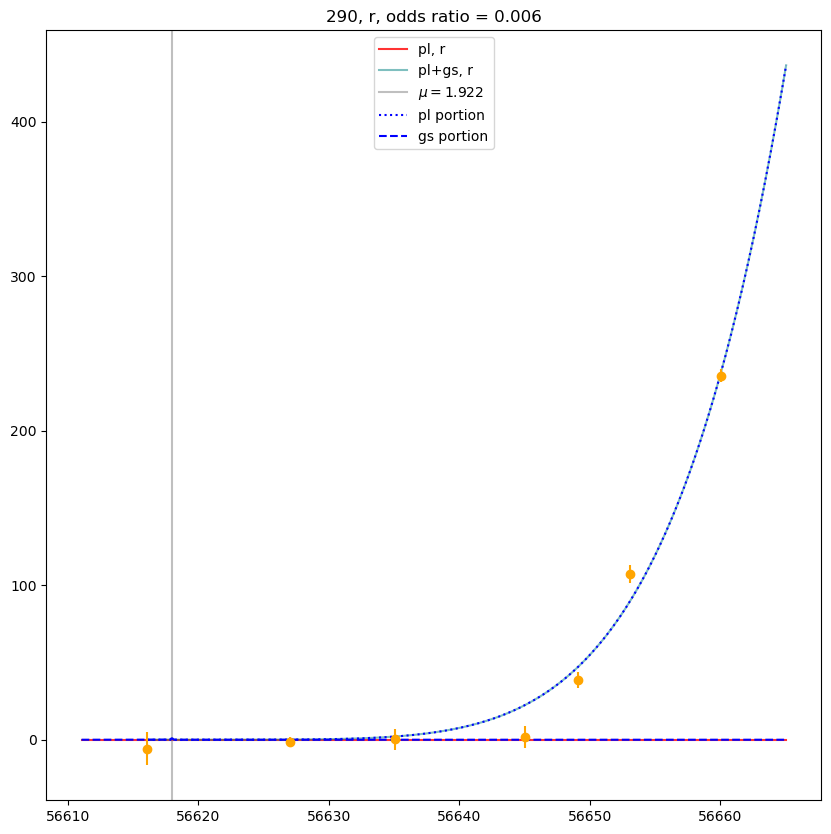

In [374]:
plt.figure(figsize=(10, 10))
ts = np.linspace(x.min() - 5, x.max() + 5, 1000)
color = 'teal' if filt == 'g' else 'orange'

def pl(t, A, beta): 
    return A*(t-x.min())**beta

def gs(t, B, sigma, mu): 
    return (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))

if popt1 is not None: 
    plt.plot(ts, powerlaw(ts, *popt1), label=f'pl, {filt}', ls='-', color='red', alpha=0.8)
    # plt.axvline(popt1[2], ls='-', color='red', alpha=0.5, label=f't0_pl = {popt1[2]:.3f}')
if popt2 is not None: 
    plt.plot(ts, powerlaw_gauss(ts, *popt2), label=f'pl+gs, {filt}', ls='-', color='teal', alpha=0.5)
    plt.axvline(x.min() + popt2[-1], ls='-', color='grey', alpha=0.5, label=f"$\mu = {popt2[-1]:.3f}$")
    # plt.axvline(popt2[5], ls='-', color='blue', alpha=0.5, label=f't0_pl_gs = {popt2[2]:.3f}')

    plt.title(f'{c_new[i]}, {filt}, odds ratio = {odds_bump:.3f}')
    # # overplot the gaussian individually and the power law inidividually
    plt.plot(ts, pl(ts, popt2[0], popt2[1]), ls=':', color='blue', label='pl portion')
    plt.plot(ts, gs(ts, popt2[2], popt2[3], popt2[4]), ls='--', color='blue', label='gs portion')

else: 
    plt.title(f'{c_new[i]}, {filt}')

plt.errorbar(x, y, yerr, fmt='o', color=f'{color}')
plt.legend()

93:, g, 6, pl, pl_gs
(0, 5)
x min = 56538.382, y min = -7.992
successful pl: 93, g, 5, -1.665
A_pl = 2.481e-1, beta_pl = 1.742
Cannot fit pl + gs.
93:, r, 6, pl, pl_gs
(0, 5)
x min = 56534.206, y min = -6.180
successful pl: 93, r, 5, -2.552
A_pl = 1.077e-2, beta_pl = 3.068
successful pl + gs: 93, r, 5, -2.552, -139.003
A_gs = 3.720e-2, beta_gs = 2.636, B = 0.819
mu = 11.028, sig = 0.201
odds ratio = 54.469
149:, g, 7, pl, pl_gs
(0, 6)
x min = 56543.223, y min = -5.051
successful pl: 149, g, 6, -8.989
A_pl = 2.289e-9, beta_pl = 6.261
successful pl + gs: 149, g, 6, -8.989, -23.216
A_gs = 1.258e-8, beta_gs = 5.821, B = 1.000
mu = 11.000, sig = 1.000
odds ratio = 2.583
149:, r, 8, pl, pl_gs
(0, 7)
x min = 56538.261, y min = -11.123
successful pl: 149, r, 7, -8.719
A_pl = 3.564e-10, beta_pl = 6.694


/tmp/ipykernel_55572/770456031.py:46: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta
/tmp/ipykernel_55572/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_55572/770456031.py:58: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
/tmp/ipykernel_55572/770456031.py:183: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta
/tmp/ipykernel_55572/770456031.py:58: RuntimeWarning: overflow encountered in power
  return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
/tmp/ipykernel_55572/770456031.py:58: RuntimeWarning: overflow encountered in multiply
  return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))


successful pl + gs: 149, r, 7, -8.719, -86.835
A_gs = 2.120e-9, beta_gs = 6.247, B = 0.987
mu = 11.065, sig = 0.765
odds ratio = 9.959
154:, g, 7, pl, pl_gs
(0, 6)
x min = 56547.291, y min = -3.207
successful pl: 154, g, 6, -11.092
A_pl = 7.057e-7, beta_pl = 4.768
Cannot fit pl + gs.
154:, r, 7, pl, pl_gs
(0, 6)
x min = 56545.211, y min = -0.575
successful pl: 154, r, 6, -5.335
A_pl = 5.437e-8, beta_pl = 5.547
Cannot fit pl + gs.
189:, g, 8, pl, pl_gs
(0, 7)
x min = 56563.037, y min = -10.714
successful pl: 189, g, 7, -485.368
A_pl = 6.614e-7, beta_pl = 5.509
successful pl + gs: 189, g, 7, -485.368, -6612.992
A_gs = 1.257e-6, beta_gs = 5.321, B = 3.387
mu = 12.001, sig = 0.437
odds ratio = 13.625
189:, r, 9, pl, pl_gs
(0, 8)
x min = 56558.054, y min = -11.406
successful pl: 189, r, 8, -156.256
A_pl = 1.248e-7, beta_pl = 5.729
successful pl + gs: 189, r, 8, -156.256, -4965.557
A_gs = 2.068e-8, beta_gs = 6.182, B = 0.884
mu = 11.420, sig = 0.361
odds ratio = 31.778
201:, g, 8, pl, pl_gs


/tmp/ipykernel_55572/770456031.py:58: RuntimeWarning: divide by zero encountered in power
  return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
/tmp/ipykernel_55572/770456031.py:46: RuntimeWarning: divide by zero encountered in power
  return A*(t-x.min())**beta


267:, g, 4, pl
(0, 3)
x min = 56594.090, y min = -19.133
successful pl: 267, g, 3, -9.070
A_pl = 4.786e+0, beta_pl = 0.000
267:, r, 9, pl, pl_gs
(0, 8)
x min = 56590.330, y min = -8.567
successful pl: 267, r, 8, -1.943
A_pl = 2.871e-3, beta_pl = 2.468
Cannot fit pl + gs.
268:, g, 7, pl, pl_gs
(0, 6)
x min = 56617.043, y min = -1.312
successful pl: 268, g, 6, -100.465
A_pl = 3.65e-3, beta_pl = 2.919
successful pl + gs: 268, g, 6, -100.465, -731.434
A_gs = 6.652e-3, beta_gs = 2.770, B = 0.310
mu = 10.234, sig = 0.203
odds ratio = 7.280
268:, r, 7, pl, pl_gs
(0, 6)
x min = 56607.302, y min = -7.477
successful pl: 268, r, 6, -46.725
A_pl = 4.689e-7, beta_pl = 5.108
successful pl + gs: 268, r, 6, -46.725, -176.216
A_gs = 1.151e-6, beta_gs = 4.879, B = 0.963
mu = 11.176, sig = 0.535
odds ratio = 3.771
290:, g, 9, pl, pl_gs
(0, 8)
x min = 56609.069, y min = -8.057
successful pl: 290, g, 8, -76.699
A_pl = 3.105e-8, beta_pl = 5.747
successful pl + gs: 290, g, 8, -76.699, -4247.202
A_gs = 2.023e

/tmp/ipykernel_55572/770456031.py:178: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(count, figsize=(10, 10))


Cannot fit pl + gs.
493:, g, 7, pl, pl_gs
(0, 6)
x min = 56888.281, y min = -7.470
successful pl: 493, g, 6, -977.896
A_pl = 1.297e-4, beta_pl = 3.931
successful pl + gs: 493, g, 6, -977.896, -9234.728
A_gs = 1.326e-4, beta_gs = 3.891, B = 1.000
mu = 11.000, sig = 1.000
odds ratio = 9.443
493:, r, 7, pl, pl_gs
(0, 6)
x min = 56885.369, y min = -6.645
successful pl: 493, r, 6, -1208.381
A_pl = 2.475e-5, beta_pl = 4.289
successful pl + gs: 493, r, 6, -1208.381, -5076.191
A_gs = 7.148e-5, beta_gs = 4.006, B = 1.000
mu = 11.000, sig = 1.000
odds ratio = 4.201
497:, g, 7, pl, pl_gs
(0, 6)
x min = 56891.377, y min = 1.769
successful pl: 497, g, 6, -2.670
A_pl = 7.443e-11, beta_pl = 7.787
successful pl + gs: 497, g, 6, -2.670, -596.409
A_gs = 9.085e-11, beta_gs = 7.730, B = 2.323
mu = 11.818, sig = 0.515
odds ratio = 223.394
497:, r, 8, pl, pl_gs
(0, 7)
x min = 56887.213, y min = -9.728
successful pl: 497, r, 7, -1.547
A_pl = 3.528e-9, beta_pl = 6.553
successful pl + gs: 497, r, 7, -1.547, -1

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


successful pl + gs: 703, r, 9, -27.913, -3894.517
A_gs = 1.707e-4, beta_gs = 3.569, B = 0.872
mu = 10.625, sig = 0.297
odds ratio = 139.526
704:, g, 6, pl, pl_gs
(0, 5)
x min = 56949.099, y min = 2.505
successful pl: 704, g, 5, -4.878
A_pl = 3.695e-11, beta_pl = 7.672
Cannot fit pl + gs.
704:, r, 7, pl, pl_gs
(0, 6)
x min = 56943.119, y min = -8.959
Cannot fit pl.
Cannot fit pl + gs.
717:, g, 8, pl, pl_gs
(0, 7)
x min = 56960.257, y min = -5.034
successful pl: 717, g, 7, -75.070
A_pl = 1.136e-7, beta_pl = 5.743
successful pl + gs: 717, g, 7, -75.070, -3074.800
A_gs = 1.600e-5, beta_gs = 4.453, B = 0.810
mu = 10.507, sig = 0.215
odds ratio = 40.959
717:, r, 9, pl, pl_gs
(0, 8)
x min = 56956.143, y min = -5.716
successful pl: 717, r, 8, -86.065
A_pl = 1.708e-7, beta_pl = 5.563
Cannot fit pl + gs.
718:, g, 8, pl, pl_gs
(0, 7)
x min = 56960.257, y min = -15.863
successful pl: 718, g, 7, -111.847
A_pl = 9.026e-8, beta_pl = 5.844
successful pl + gs: 718, g, 7, -111.847, -6032.635
A_gs = 1.22

RuntimeError: Optimal parameters not found: The maximum number of function evaluations is exceeded.

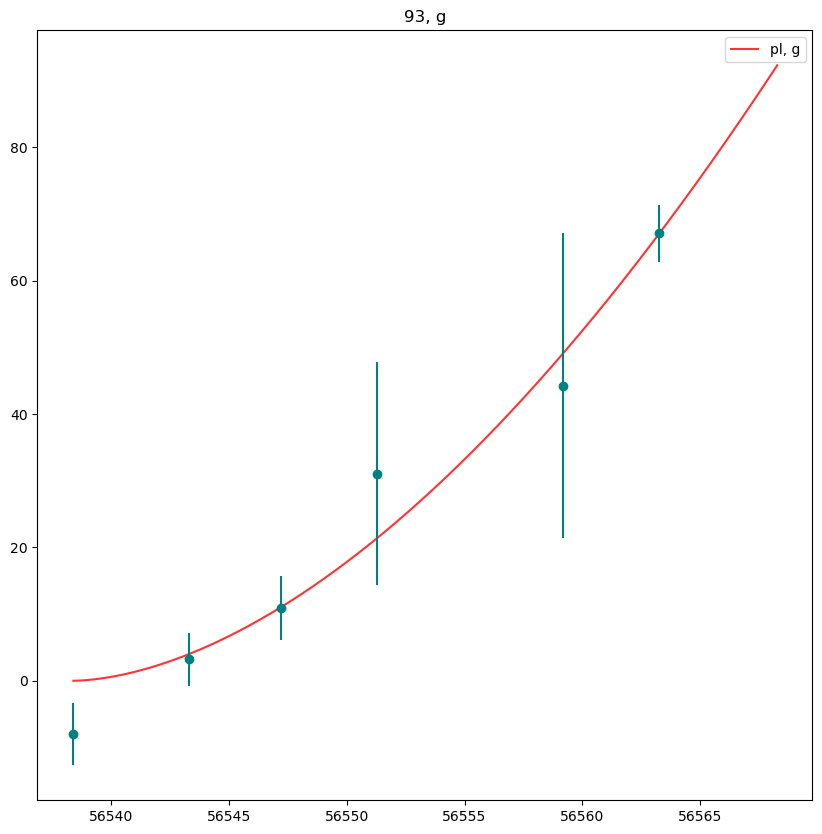

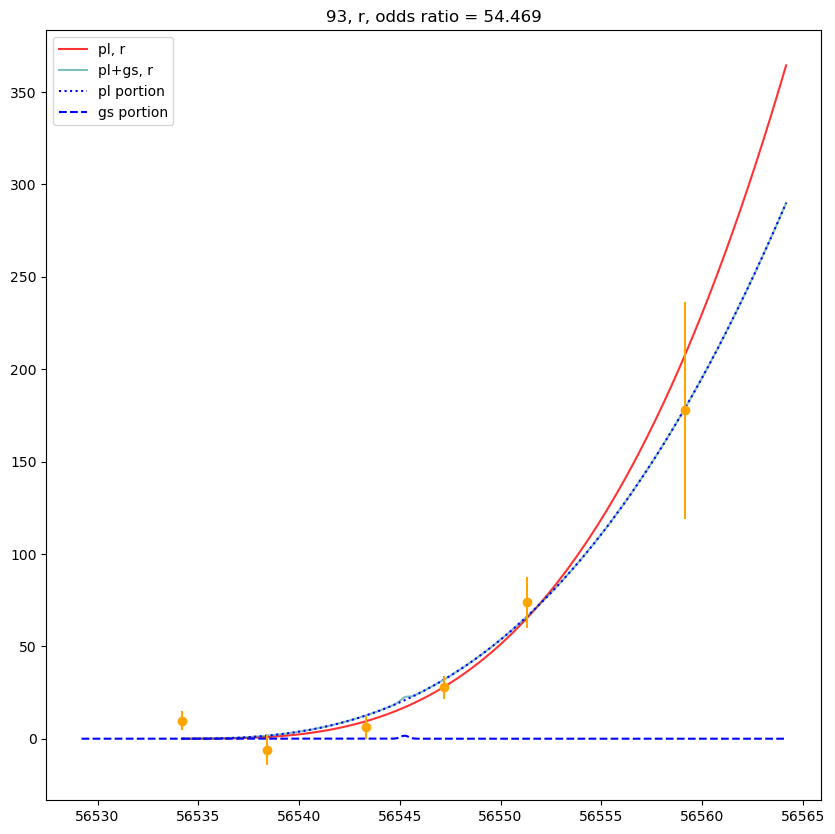

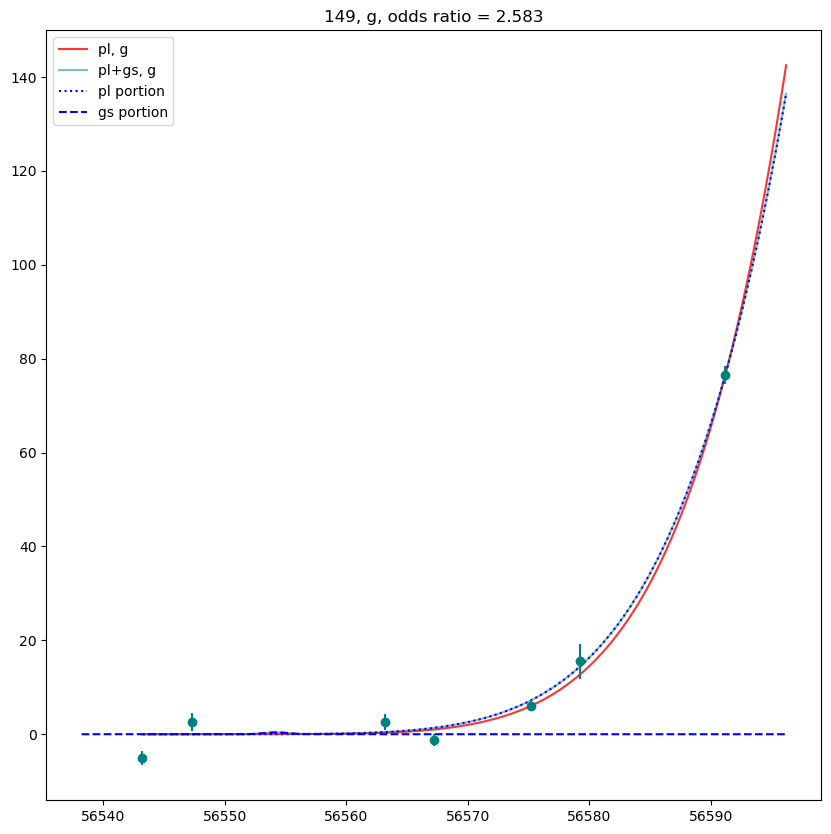

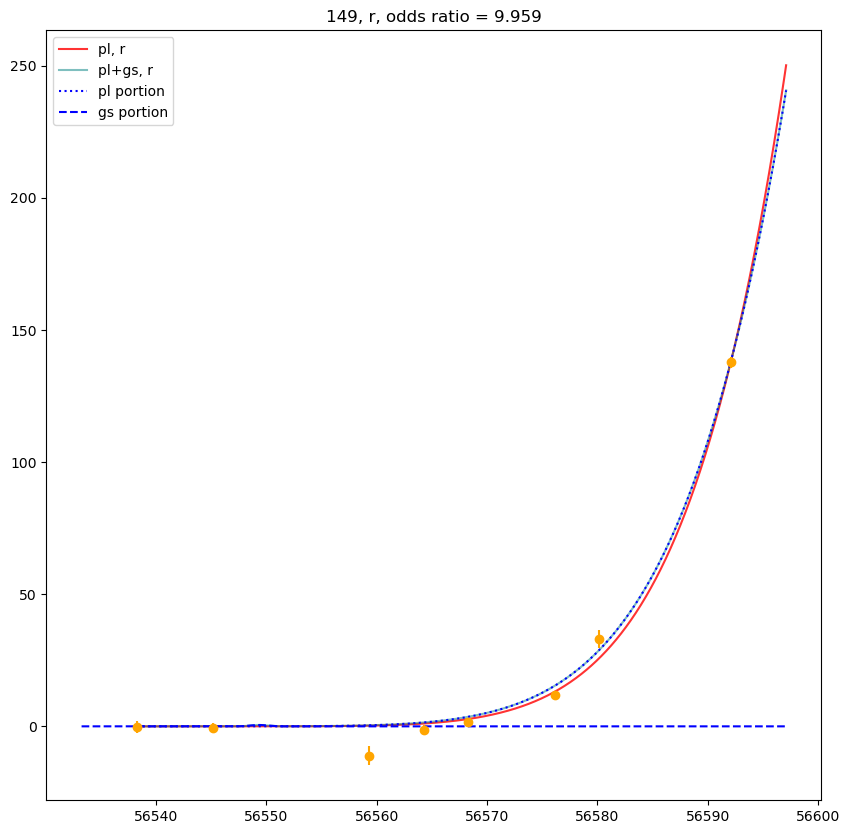

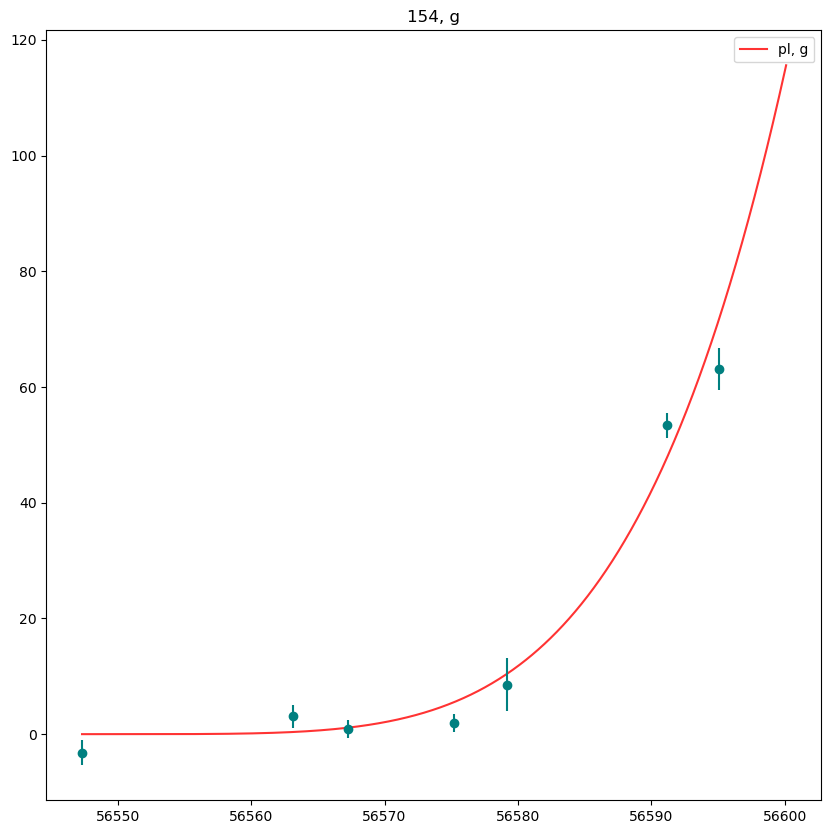

...

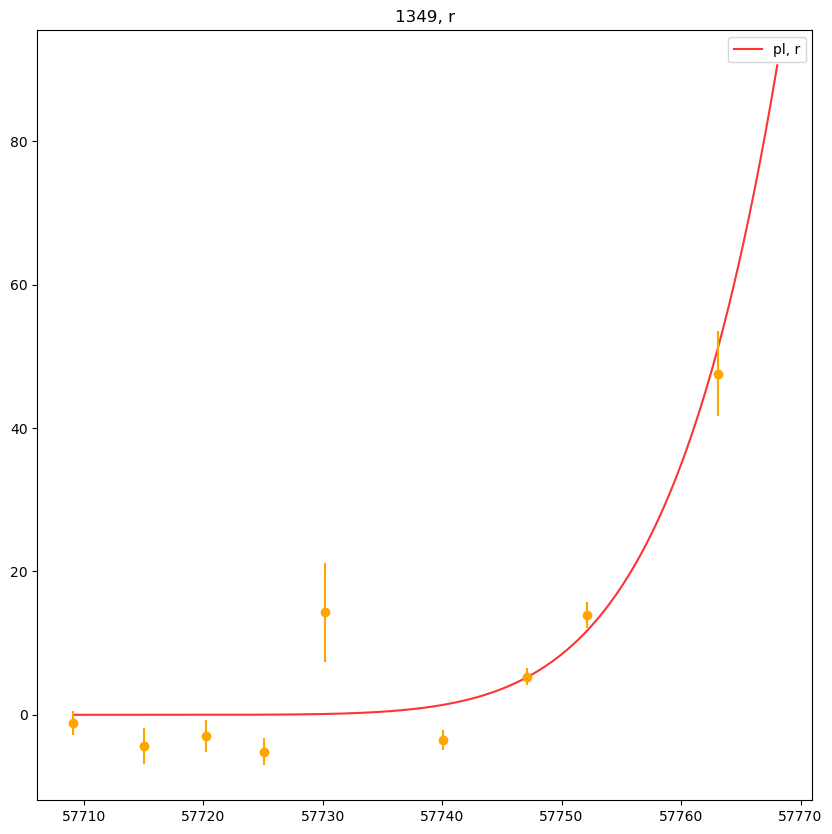

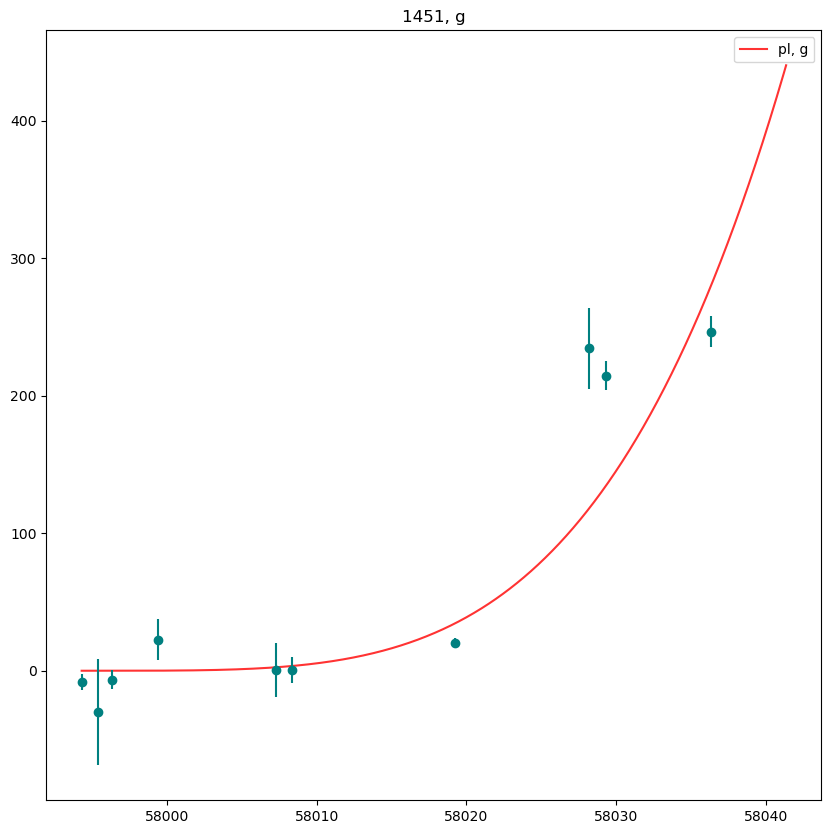

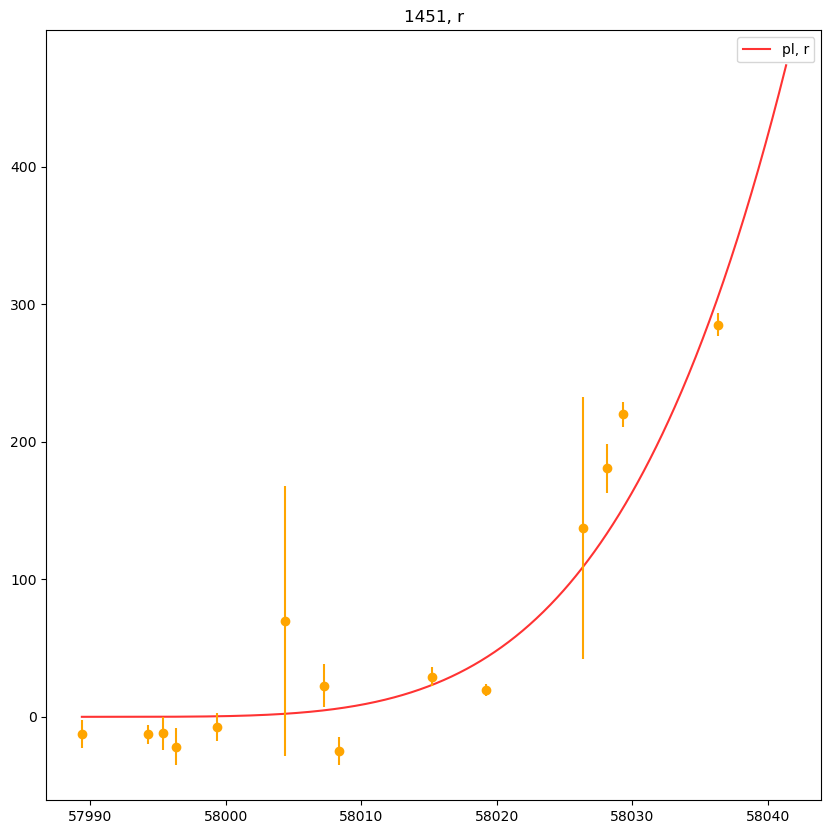

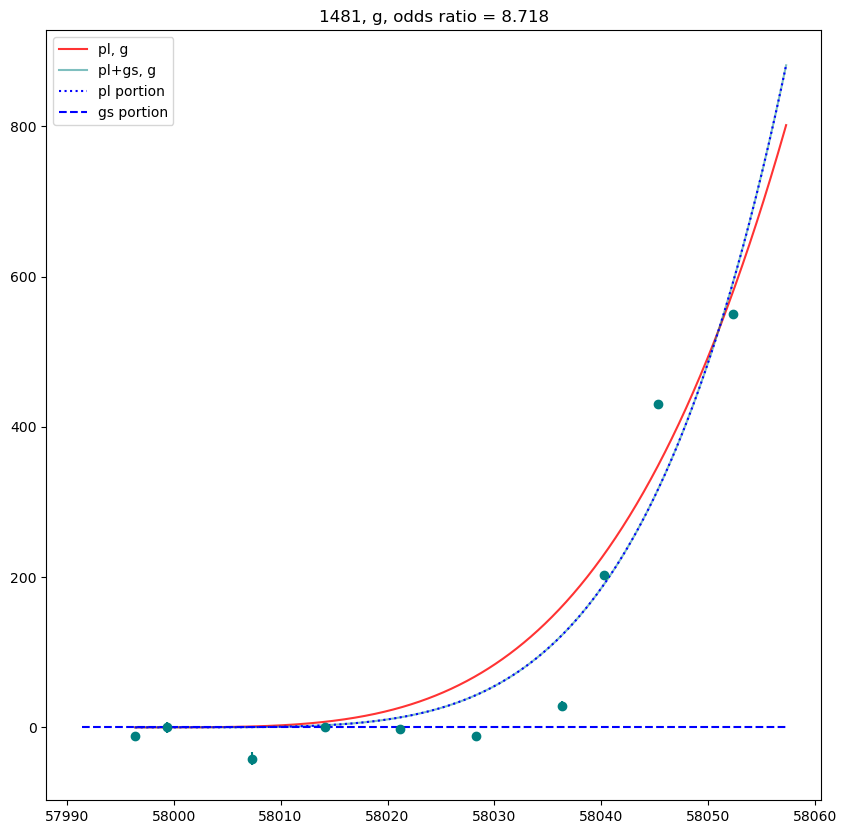

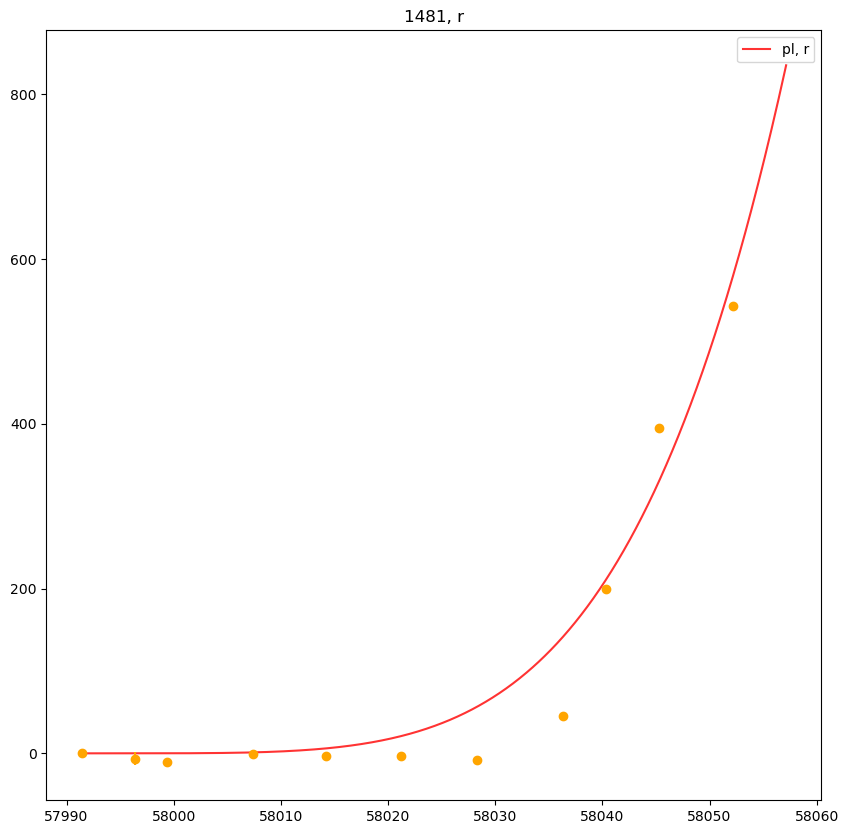

In [64]:
from scipy import optimize
import inspect

count = 0 
t0 = False 

for i in range(len(c_new)):
    for filt in ('g', 'r'):      # also in i if needed if that's a detection.. 
        if len(interp(c_new[i], filt)['data']) == 0: 
            print(f'No data for SN {c_new[i]}, band {filt}.')
            break 

        early_y = interp(c_new[i], filt)['data'][:, 1][interp(c_new[i], filt)['data'][:, 0] < 0]
                # ind = np.where(np.isclose(early_y, interp(c_new[i], filt)['data'][:, 1].max() * 0.4, atol=25))[0][0] 

        # early light curves only 
        # val = interp(c_new[i], filt)['data'][:, 1].max() * 0.4
        # diffs = np.abs(early_y - val)

        # ind = diffs.argmin()

        # up until full peak
        ind = np.argmax(early_y)     # technically should just be the last one
        # ind = np.argmax(early_y) - 1

        # add early index 
        day = -30
        diffs_day = np.abs(interp(c_new[i], filt)['data'][:, 0] - day)
        ind_day = diffs_day.argmin()

        # ind_day = 1    # add this if you don't want to cut any earlier points off 
        ind_day = 0
        num_pts = ind - ind_day + 1

#         if t0 == True: 
#             t0 is not None   #
#         def powerlaw(t, A, beta, t0=None): 
#             if t0 == True: 
#                 return powerlaw_t0(t, A, beta, t0)
#             if t0 == False: 
#                 return powerlaw(t, A, beta) 
            
        def powerlaw_rf(t, A, beta, t0=None):                    # what if you fit for t0. 
            """power law fitting parameters: t, A, beta
            """
            return A*(t-x.min())**beta 
            # if t0 is None: 
            #     return A*(t-x.min())**beta 
            # else: 
            #     return A*(t-t0)**beta          # no y-intercept term because flux is already calibrated
            # return A*(t-t0)**beta
            # return A*(t-t0)**beta + C 
            # think more about how to get more accurate measure for x.min...

        def powerlaw_gauss_rf(t, A, beta, B, sigma, mu, t0=None): 
            """ power law + gaussian fitting parameters: t, A, beta, B, sigma, mu
            """
            return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
            # if t0 is None: 
            #     return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
            # else: 
            #     return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2))
            # return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2)) + D


        params1 = inspect.signature(powerlaw_rf).parameters
        params2 = inspect.signature(powerlaw_gauss_rf).parameters
        l = len(params1) - 1
        u = len(params2) - 1     

        if num_pts < l: 
            print(f'{c_new[i]}:, {filt}, {num_pts}')
        if l < num_pts < u: 
        # if 2 < ind < 5: 
            print(f'{c_new[i]}:, {filt}, {num_pts}, pl') 
        if num_pts >= u: 
        # if ind >= 5: 
            print(f'{c_new[i]}:, {filt}, {num_pts}, pl, pl_gs') 

        # print(f'{ind_day, ind}, points = {num_pts}')
        print(f'{ind_day, ind}')

        if filt == 'g': 
            x = mjds_interp_g[c_new[i]][ind_day:ind+1]
        if filt == 'r': 
            x = mjds_interp_r[c_new[i]][ind_day:ind+1]
        y = early_y[ind_day:ind+1]        # restrict range bc some early early points bad  
        yerr = interp(c_new[i], filt)['err'][ind_day:ind+1]
        if len(x) != 0: 
            print(f'x min = {x.min():.3f}, y min = {y.min():.3f}') 


        popt1_, pcov1_ = [], []
        popt2_, pcov2_ = [], []
        odds_rat = []


        # if 2 < ind < 5: 
        if l < num_pts < u: 
            successful0 = False 
            try: 
                popt1, pcov1, info1, d1, e1 = None, None, None, None, None
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)
                popt1_.append(popt1), pcov1_.append(pcov1) 
                successful0 = True
            except: 
                print('Cannot fit pl.') 
            if successful0 == True: 
                lnlike1 = np.nan
                info1 = np.nan
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)

                lnlike1 = -0.5*np.sum(info1['fvec']**2) 
                print(f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}') 
                print(f'A_pl = {np.format_float_scientific(popt1[0], precision=3, exp_digits=1)}, beta_pl = {popt1[1]:.3f}') 


        # if ind >= 5: 
        if num_pts >= u: 
            successful1 = False 
            try: 
                popt1, pcov1, info1, d1, e1 = None, None, None, None, None
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)
                popt1_.append(popt1), pcov1_.append(pcov1) 
                successful1 = True
            except: 
                print('Cannot fit pl.')
            if successful1 == True: 
                lnlike1 = np.nan
                info1 = np.nan
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)

                lnlike1 = -0.5*np.sum(info1['fvec']**2)
                # print('Successful pl.')
                print(f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}')
                print(f'A_pl = {np.format_float_scientific(popt1[0], precision=3, exp_digits=1)}, beta_pl = {popt1[1]:.3f}') 

            successful2 = False 
            try: 
                # popt2 = np.nan
                popt2, pcov2, info2, d2, e2 = None, None, None, None, None
                popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss_rf, x, y, sigma=yerr, full_output=True)
                popt2_.append(popt2), pcov2_.append(pcov2) 
                successful2 = True
            except: 
                print('Cannot fit pl + gs.')  

            if successful2 == True: 
                lnlike2 = np.nan
                info2 = np.nan
                bounds=((-np.inf, -np.inf, 0, 0, 10, x.min()), (np.inf, np.inf, np.inf, np.inf, np.inf, x.max()))
                # popt2 = None
                popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss_rf, x, y, bounds=bounds, full_output=True)

                lnlike2 = -0.5*np.sum(info2['fvec']**2)      
                print(f'successful pl + gs: {c_new[i]}, {filt}, {ind}, {lnlike1:.3f}, {lnlike2:.3f}')   
                odds_bump = None
                odds_bump = lnlike2 / lnlike1
                odds_rat.append(odds_bump)
                # print(f'odds ratio = {odds_bump:.3f}') 
                # print(f'x min = {x.min():.3f}, mu = {x.min() + popt2[-1]:.3f}')
                print(f'A_gs = {np.format_float_scientific(popt2[0], precision=3, exp_digits=1)}, beta_gs = {popt2[1]:.3f}, B = {popt2[2]:.3f}')
                print(f'mu = {popt2[4]:.3f}, sig = {popt2[3]:.3f}')

                print(f'odds ratio = {odds_bump:.3f}') 

        # dict = {'name': f"{c_new[i]}, {filt}, {ind}",
        #         'popt1_': popt1_, 
        #         'pcov1_': pcov1_, 
        #         'popt2_': popt2_, 
        #         'pcov2_': pcov2_, 
        #         'odds': odds_rat, 
        #         'data': list(zip(x, y, yerr))}

        # all_stats.append(dict)
        count += 1
        
        plt.figure(count, figsize=(10, 10))
        ts = np.linspace(x.min() - 5, x.max() + 5, 1000)
        color = 'teal' if filt == 'g' else 'orange'
        
        def pl(t, A, beta): 
            return A*(t-x.min())**beta
        
        def gs(t, B, sigma, mu): 
            return (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
        
        if popt1 is not None: 
            # plt.plot(ts, powerlaw_rf(ts, *popt1), label=f'pl, {filt}', ls='--', color=f'{color}', alpha=0.5)
            plt.plot(ts, powerlaw_rf(ts, *popt1), label=f'pl, {filt}', ls='-', color='red', alpha=0.8)
            # plt.axvline(popt1[2], ls='-', color='red', alpha=0.5, label=f't0_pl = {popt1[2]:.3f}')
        if popt2 is not None: 
            # plt.plot(ts, powerlaw_gauss_rf(ts, *popt2), label=f'pl+gs, {filt}', ls='--', color=f'{color}', alpha=0.5)
            plt.plot(ts, powerlaw_gauss_rf(ts, *popt2), label=f'pl+gs, {filt}', ls='-', color='teal', alpha=0.5)
            # plt.axvline(x.min() + popt2[-1], ls='--', label=f"\mu = {x.min() + popt2[-1]}")
            # plt.axvline(x.min() + popt2[-1], ls='-', color='grey', alpha=0.5, label=f"$\mu = {popt2[-1]:.3f}$")
            # plt.axvline(popt2[5], ls='-', color='blue', alpha=0.5, label=f't0_pl_gs = {popt2[2]:.3f}')
            
            plt.title(f'{c_new[i]}, {filt}, odds ratio = {odds_bump:.3f}')
            # overplot the gaussian individually and the power law inidividually
            plt.plot(ts, pl(ts, popt2[0], popt2[1]), ls=':', color='blue', label='pl portion')
            plt.plot(ts, gs(ts, popt2[2], popt2[3], popt2[4]), ls='--', color='blue', label='gs portion')
            
        else: 
            plt.title(f'{c_new[i]}, {filt}')

        plt.errorbar(x, y, yerr, fmt='o', color=f'{color}')

    #     if odds_bump is not None: 
    #         plt.title(f'{c_new[i]}, {filt}, odds ratio = {odds_bump:.3f}')
        # else: 
        #     plt.title(f'{c_new[i]}, {filt}')

        plt.legend()


### 6.5 A New Version Developed from SDSS/EEFlux.ipynb 

In [49]:
### Convenience functions ### 
def mjd2rf(mjds_o, peakmjd, redshift):   
    """ Convert MJDs (observer frame) to MJDS (rest/lab frame). 
    Inputs: MJDs_o, peakmjd, redshift
    Outputs: MJDs_l 
    """
    return (mjds_o - peakmjd) / (1 + redshift)
    
def rf2mjd(mjds_l, peakmjd, redshift): 
    """ Convert MJDs (rest / lab frame) to MJDS (observer frame). 
    Inputs: MJDs_l, peakmjd, redshift
    Outputs: MJDs_o 
    """
    return mjds_l * (1 + redshift) + peakmjd

In [307]:
import inspect
from scipy import optimize

# def modelfit(i, filt, method, init, final, bounds1, bounds2, p01, p02, t0=False): 
def modelfit(i, filt, method='trf', bounds=True, t0=False, p0=False): 
    """ 
    Fitting powerlaw and powerlaw + gaussian models to early light curves. 
    Inputs: i = SN index out of 1635, filt = 'g' or 'r', method='lm', 'trf', or 'dogbox', bounds=True, t0=False, p0=False
    Outputs: data, dict, powerlaw, powerlaw_gauss
    Scipy methods: method{‘lm’, ‘trf’, ‘dogbox’}, optional
        Method to use for optimization. See least_squares for more details. 
        Default is ‘lm’ for unconstrained problems and ‘trf’ if bounds are provided. 
        The method ‘lm’ won’t work when the number of observations is less than the number of variables, 
        use ‘trf’ or ‘dogbox’ in this case.
    
    """
    ##### 0. GRAB EARLY LIGHTCURVE DATA ##### 
    
    if len(interp(i, filt)['data']) == 0: 
        return(f'No data for SN {i}, band {filt}.')
 
    cid = cids[i]
    peakmjd = peakmjds_fitres[i]
    redshift = interp(i, filt)['redshift']
    
    early = interp(i, filt)['data'][:, 1][interp(i, filt)['data'][:, 0] < 0]
    mjd_rf = interp(i, filt)['data'][:, 0][interp(i, filt)['data'][:, 0] < 0]
    
    # add left bound index FIRST 
    day = -30
    diffs_day = np.abs(mjd_rf - day)   
    ind0 = diffs_day.argmin()

    # fit up to 0.5 as in https://arxiv.org/pdf/1411.1064
    val = interp(i, filt)['data'][:, 1].max() * 0.5
    diffs = np.abs(early[ind0:] - val)
    ind1 = diffs.argmin()         
    ind1 = ind0 + ind1
    
    # up until full peak
    # ind = np.argmax(early) 
 
    num_pts = ind1 - ind0 + 1
    print(f'index = {i}, cid = {cid}, filter = {filt}')
    print(f'num_pts = {num_pts}: {ind0, ind1}')

    if num_pts <= 2: 
        print(f'failed <= 2 points: num_pts = {num_pts}')
        return f'failed <= 2 points: num_pts = {num_pts}' 

    ##### x0, x, y, yerr #####
    x0 = mjd_rf[ind0:ind1+1]
    if filt == 'g': 
        x = mjds_interp_g[i][ind0:ind1+1]
    if filt == 'r': 
        x = mjds_interp_r[i][ind0:ind1+1]
    y = early[ind0:ind1+1]         
    yerr = interp(i, filt)['err'][ind0:ind1+1]
    
    if len(x) != 0: 
        print(f'x min = {x.min():.3f}, y min = {y.min():.3f}') 


    ##### 1. FITTING FUNCTIONS #####
        
    # t0 = False          # use t0 = True AND & ind0 = 0 (all points) if desired. 

    ### 1) define power law models 
    def powerlaw_t0(t, A, beta, t0): 
        """ Power law fitting parameters: t, A, beta, t0
        """
        return A*(t-t0)**beta 

    def powerlaw_no_t0(t, A, beta): 
        """ Power law fitting parameters: t, A, beta
        """
        return A*(t-x.min())**beta 

    ### 2) define power law + gaussian models 
    def powerlaw_gauss_t0(t, A, beta, B, sigma, mu, t0): 
        """ Power law + gaussian fitting parameters: t, A, beta, B, sigma, mu, t0
        """
        return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2))

    def powerlaw_gauss_no_t0(t, A, beta, B, sigma, mu): 
        """ Power law + gaussian fitting parameters: t, A, beta, B, sigma, mu
        """
        return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))

    ### option for fitting for t0 
    if t0:
        powerlaw = powerlaw_t0
        powerlaw_gauss = powerlaw_gauss_t0 
    else:
        powerlaw = powerlaw_no_t0
        powerlaw_gauss = powerlaw_gauss_no_t0 

    ### get number of parameters for fitting (this only applies for lm) 
    params1 = inspect.signature(powerlaw).parameters
    params2 = inspect.signature(powerlaw_gauss).parameters
    l = len(params1) - 1
    u = len(params2) - 1     

    # if len(x) != 0: 
    #     print(f'x min = {x.min():.3f}, y min = {y.min():.3f}') '
    
    ##### 2. NOW PERFORM THE FITTING FOR POWERLAW #####
    # successful1 = False 
    try: 
        bounds=((0, 0), (np.inf, np.inf))        # don't need initial guess, it's pretty robust with any  method  
        popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw, x, y, sigma=yerr, method=f'{method}', full_output=True)
        # successful1 = True
        
        chi21 = np.sum(info1['fvec']**2)
        dof1 = num_pts - l 
        r_chi21 = chi21 / dof1       # NDF = k − n_p
        like1 = np.exp(-chi21/2)
        
        print('successful pl!')
        print(f'chi21 = {chi21:.3f}, r_chi21 = {r_chi21:.3f}')
        print(f'A_pl = {np.format_float_scientific(popt1[0], precision=3, exp_digits=1)}, beta_pl = {popt1[1]:.3f}') 
        
    except RuntimeError as e: 
        print('pl:', e)
        popt1, pcov1, chi21, dof1, r_chi21, like1 = None, None, None, None, None, None

    ##### 3. AND THE FITTING FOR POWERLAW + GAUSSIAN. #####

    try: 
        # constraining bounds for mu of gaussian
        start = -20    
        diffs_20 = np.abs(x0 - start)   
        ind_20 = diffs_20.argmin()
        mu0 = x[ind_20] - x.min()   
        mu1 = x.max() - x.min()         # this is relative to x.min, as how powerlaw_gauss function is written
        if mu0 == mu1: 
            mu0 = x.min()
            mu1 = x.max()
        print(f'mu0 = {mu0:.3f}, mu1 = {mu1:.3f}')
        
        if bounds: 
            if t0:   ### YES T0 ### 
                # bounds=((0, 0, 0, 0, mu0, x.min()), (np.inf, np.inf, np.inf, np.inf, mu1, x.max()))    # these bounds might not be right for t0
                bounds=((0, 0, 0, 0, mu0, -np.inf), (np.inf, np.inf, np.inf, np.inf, mu1, x.max()))
                
                if p0: 
                    p0 = np.array((1, 1, 1, 1, mu0, x.min()))
                    popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, p0=p0, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)
                else: 
                    popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)

            else:       ### NO T0 ### 
                bounds=((0, 0, 0, 0, mu0), (np.inf, np.inf, np.inf, np.inf, mu1))         # mu of the gaussian is at least -20 in rest frame. 
                
                if p0: 
                    p0 = np.array((1, 1, 1, 1, mu0))
                    popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, p0=p0, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)
                    
                else:    ### THIS IS THE DEFAULT: NO T0, NO P0 ### 
                    popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss, x, y, sigma=yerr, bounds=bounds, method=f'{method}', full_output=True)

        chi22 = np.sum(info2['fvec']**2) 
        dof2 = num_pts - u               # could be 0 .. 
        r_chi22 = chi22 / dof2 

        like2 = np.exp(-chi22/2)
        print('successful pl + gs!')
        print(f'chi22 = {chi22:.3f}, r_chi22 = {r_chi22:.3f}')
        if like1 == None: 
            odds_bump = None
        else: 
            odds_bump = like2 / like1 
        print(f'A_gs = {np.format_float_scientific(popt2[0], precision=3, exp_digits=1)}, beta_gs = {popt2[1]:.3f}, B = {popt2[2]:.3f}, sig = {popt2[3]:.3f}, mu = {popt2[4]:.3f}')

        if like1 != None: 
            print(f'odds ratio (bump/no bump) = {odds_bump:.3f}')      # DISCLAIMER this is not a great estimate if overfitting.. 

    except RuntimeError as e: 
        print('pl+gs:', e)
        popt2, pcov2, chi22, dof2, r_chi22, like2 = None, None, None, None, None, None
        odds_bump = None 


    ### 3.5 MAY BE USEFUL TO LOOK AT PCOV FOR QUALITY OF FITS ### 

    ### 4. WRITING A DICT FOR: (1) PARAMETERS & CHI2 FOR EACH FIT, (2) DATA TO DICTIONARIES ### 
    data = {'x0': x0, 
        'x': x,
        'y': y, 
        'yerr': yerr}

    dict = {'name': f'{cid}, {filt}, {num_pts}: ({ind0}, {ind1})',
            'index': i,
            'peakmjd': peakmjd,
            'redshift': redshift,
            'popt1': popt1 if popt1 is not None else np.nan, 
            'pcov1': pcov1 if pcov1 is not None else np.nan, 
            'chi21': chi21 if chi21 is not None else np.nan, 
            'dof1': dof1 if dof1 is not None else np.nan,
            'r_chi21': r_chi21 if dof1 is not None else np.nan,
            'like1': like1 if like1 is not None else np.nan,  
            'popt2': popt2 if popt2 is not None else np.nan, 
            'pcov2': pcov2 if pcov2 is not None else np.nan, 
            'chi22': chi22 if chi22 is not None else np.nan, 
            'dof2': dof2 if dof2 is not None else np.nan,
            'r_chi22': r_chi22 if r_chi22 is not None else np.nan,
            'like2': like2 if r_chi22 is not None else np.nan,
            'odds': odds_bump if odds_bump is not None else np.nan}

  
    
    return data, dict, powerlaw, powerlaw_gauss

In [322]:
def plotfits(ax, cid, filt, method, bounds=True, t0=False, p0=False, rf=False): 
    
    ### 1. Getting params ### 
    res = modelfit(cid, filt=filt, method=method, bounds=bounds, t0=t0, p0=p0)
    
    if len(res) > 10:         # 'No data for SN 214, band r.' => 27; 'failed <= 2 points: num_pts = 2' => 31
        return res 
    
    else: 
        xx0 = res[0]['x0']
        xx = res[0]['x']
        yy = res[0]['y']
        yyerr = res[0]['yerr']

        nname = res[1]['name']
        peak = res[1]['peakmjd']
        red = res[1]['redshift']

        ppopt1 = res[1]['popt1']
        ppopt2 = res[1]['popt2']
        oodds = res[1]['odds']

        powerlaw = res[2]
        powerlaw_gauss = res[3]


        ### 2. Constructing Plot ### 
        # plt.figure(figsize=(10, 10))
        ts = np.linspace(xx.min() - 5, xx.max() + 5, 1000)

        x0s = mjd2rf(ts, peak, red)


        if rf == True: 
            if ppopt1 is not np.nan: 
                ax.plot(x0s, powerlaw(ts, *ppopt1), label='pl', ls='--', color='red', alpha=0.8) 
            if ppopt2 is not np.nan: 
                ax.plot(x0s, powerlaw_gauss(ts, *ppopt2), label='pl+gs', ls='--', color='blue', alpha=0.5) 
                mu_mjd = xx.min() + ppopt2[4] 
                ax.axvline(mjd2rf(mu_mjd, peak, red), label='$\mu$', color='grey')
            ax.axvspan(-20, -14, label='-20-14d', color='grey', alpha=0.3)
            ax.errorbar(mjd2rf(xx, peak, red), yy, yyerr, fmt='o')

        if rf == False: 
            if ppopt1 is not np.nan: 
                ax.plot(ts, powerlaw(ts, *ppopt1), label='pl', ls='--', color='red', alpha=0.8) 
            if ppopt2 is not np.nan:
                ax.plot(ts, powerlaw_gauss(ts, *ppopt2), label=f'pl+gs, $B={ppopt2[2]:.3f}$, $\sigma={ppopt2[3]:.3f}$', ls='--', color='blue', alpha=0.5)
                ax.axvline(xx.min() + ppopt2[4], label='$\mu$', color='grey') 
            ax.axvspan(rf2mjd(-20, peak, red), rf2mjd(-14, peak, red), label='-20-14d', color='grey', alpha=0.3)
            ax.errorbar(xx, yy, yyerr, fmt='o')


        ax.set_title(f'{nname}, odds={oodds:.3f}')
        ax.legend()

        return res


In [ ]:
count += 1
        
def pl(t, A, beta): 
    return A*(t-x.min())**beta

def gs(t, B, sigma, mu): 
    return (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))

    # overplot the gaussian individually and the power law inidividually
    plt.plot(ts, pl(ts, popt2[0], popt2[1]), ls=':', color='blue', label='pl portion')
    plt.plot(ts, gs(ts, popt2[2], popt2[3], popt2[4]), ls='--', color='blue', label='gs portion')


In [332]:
### calculate denominator (total numbers WITH an odds ratio) 
### calculate numerator (where odds > 1) -> inspect these graphically. 

all_odds_trf = np.array(all_odds_trf)
all_odds_trf[all_odds_trf > 1]

all_names_trf = np.array(all_names_trf)
all_names_trf[all_odds_trf > 1]

med = [all_names_trf[all_odds_trf > 1][i][0:10] for i in range(len(all_names_trf[all_odds_trf > 1]))]
ids = np.array([med[i][:7] for i in range(len(med))]).astype(int)
indices = np.array(all_indices_trf)[all_odds_trf > 1]
filts = np.array([med[i][9:10] for i in range(len(med))])

names_gr1 = list(zip(indices, filts))


In [375]:
len(np.unique(indices)) / len(np.unique(np.array([all_names_trf[i][0:7] for i in range(len(all_names_trf))])).astype(int))

0.6981132075471698

index = 93, cid = 1252829, filter = g
num_pts = 4: (0, 3)
x min = 56538.382, y min = -7.992
successful pl!
chi21 = 2.957, r_chi21 = 1.479
A_pl = 4.717e-2, beta_pl = 2.518
mu0 = 0.000, mu1 = 12.911
successful pl + gs!
chi22 = 2.916, r_chi22 = -2.916
A_gs = 2.638e-2, beta_gs = 2.764, B = 3.782, sig = 0.863, mu = 5.811
odds ratio (bump/no bump) = 1.021
index = 93, cid = 1252829, filter = r
num_pts = 5: (0, 4)
x min = 56534.206, y min = -6.180
successful pl!
chi21 = 4.101, r_chi21 = 1.367
A_pl = 1.88e-3, beta_pl = 3.731
mu0 = 0.000, mu1 = 17.090
successful pl + gs!
chi22 = 4.101, r_chi22 = inf
A_gs = 1.88e-3, beta_gs = 3.731, B = 0.681, sig = 0.327, mu = 6.643
odds ratio (bump/no bump) = 1.000
index = 149, cid = 1255735, filter = r
num_pts = 5: (2, 6)
x min = 56559.299, y min = -11.123
successful pl!
chi21 = 10.542, r_chi21 = 3.514
A_pl = 2.427e-5, beta_pl = 4.646
mu0 = 8.973, mu1 = 20.857
successful pl + gs!
chi22 = 9.957, r_chi22 = inf
A_gs = 1.522e-5, beta_gs = 4.803, B = 0.197, sig = 0

/tmp/ipykernel_704081/2960091229.py:77: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta
/tmp/ipykernel_704081/2960091229.py:88: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
/tmp/ipykernel_704081/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_704081/2960091229.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  r_chi22 = chi22 / dof2


successful pl!
chi21 = 2.996, r_chi21 = 0.999
A_pl = 2.347e-4, beta_pl = 3.701
mu0 = 12.047, mu1 = 28.029
successful pl + gs!
chi22 = 2.782, r_chi22 = inf
A_gs = 1.168e-4, beta_gs = 3.910, B = 2.674, sig = 0.424, mu = 16.037
odds ratio (bump/no bump) = 1.113
index = 154, cid = 1256332, filter = r
num_pts = 5: (1, 5)
x min = 56559.299, y min = -0.575
successful pl!
chi21 = 7.817, r_chi21 = 2.606
A_pl = 4.354e-6, beta_pl = 5.125
mu0 = 8.973, mu1 = 20.856
successful pl + gs!
chi22 = 4.261, r_chi22 = inf
A_gs = 1.11e-6, beta_gs = 5.584, B = 3.648, sig = 0.420, mu = 9.234
odds ratio (bump/no bump) = 5.919
index = 201, cid = 1258330, filter = g
num_pts = 6: (2, 7)
x min = 56558.309, y min = -15.630
successful pl!
chi21 = 3.727, r_chi21 = 0.932
A_pl = 4.973e-4, beta_pl = 3.249
mu0 = 8.835, mu1 = 32.781
successful pl + gs!
chi22 = 3.727, r_chi22 = 3.727
A_gs = 4.974e-4, beta_gs = 3.249, B = 0.000, sig = 14.798, mu = 31.553
odds ratio (bump/no bump) = 1.000
index = 250, cid = 1261193, filter = 

/tmp/ipykernel_704081/2960091229.py:77: RuntimeWarning: divide by zero encountered in power
  return A*(t-x.min())**beta


successful pl + gs!
chi22 = 12.436, r_chi22 = 12.436
A_gs = 2.111e-5, beta_gs = 5.649, B = 2.083, sig = 0.060, mu = 14.068
odds ratio (bump/no bump) = 33.010
index = 794, cid = 1321522, filter = r
num_pts = 7: (7, 13)
x min = 57002.039, y min = 6.161
successful pl!
chi21 = 27.467, r_chi21 = 5.493
A_pl = 3.045e-2, beta_pl = 2.794
mu0 = 9.006, mu1 = 23.007
successful pl + gs!
chi22 = 20.721, r_chi22 = 10.361
A_gs = 2.051e-2, beta_gs = 2.910, B = 2.351, sig = 0.059, mu = 15.037
odds ratio (bump/no bump) = 29.159
index = 832, cid = 1330031, filter = r
num_pts = 5: (4, 8)
x min = 57283.131, y min = -10.799
successful pl!
chi21 = 11.272, r_chi21 = 3.757
A_pl = 1.481e-4, beta_pl = 5.154
mu0 = 7.950, mu1 = 21.935
successful pl + gs!
chi22 = 3.222, r_chi22 = inf
A_gs = 3.43e-5, beta_gs = 5.627, B = 2.132, sig = 0.013, mu = 17.919
odds ratio (bump/no bump) = 55.976
index = 853, cid = 1331836, filter = r
num_pts = 5: (2, 6)
x min = 57286.213, y min = -37.167
successful pl!
chi21 = 8.568, r_chi21 

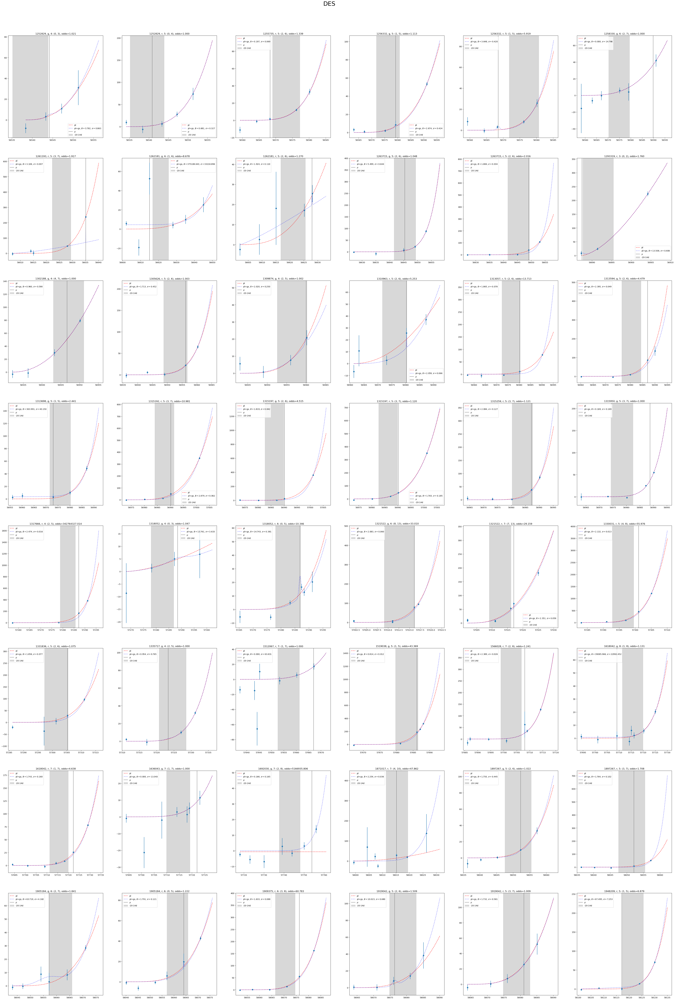

In [400]:
### this is for all the ones with odds ratios > 1 
method = 'trf'
indices.reshape(8, 6)
filts.reshape(8, 6)
fig, ax = plt.subplots(8, 6, figsize=(60, 80)) 

for i in range(8):
    for j in range(6): 
        a = plotfits(ax[i, j], indices.reshape(8, 6)[i, j], filt=filts.reshape(8, 6)[i, j], method=f'{method}', bounds=True, t0=False, p0=False, rf=False)  

plt.suptitle('DES', fontsize=30)
plt.subplots_adjust(top=0.95)
plt.savefig('odds_gr1.pdf') 

index = 93, cid = 1252829, filter = g
num_pts = 4: (0, 3)
x min = 56538.382, y min = -7.992
successful pl!
chi21 = 2.957, r_chi21 = 1.479
A_pl = 4.717e-2, beta_pl = 2.518
mu0 = 0.000, mu1 = 12.911
successful pl + gs!
chi22 = 2.916, r_chi22 = -2.916
A_gs = 2.638e-2, beta_gs = 2.764, B = 3.782, sig = 0.863, mu = 5.811
odds ratio (bump/no bump) = 1.021


index = 93, cid = 1252829, filter = r
num_pts = 5: (0, 4)
x min = 56534.206, y min = -6.180
successful pl!
chi21 = 4.101, r_chi21 = 1.367
A_pl = 1.88e-3, beta_pl = 3.731
mu0 = 0.000, mu1 = 17.090
successful pl + gs!
chi22 = 4.101, r_chi22 = inf
A_gs = 1.88e-3, beta_gs = 3.731, B = 0.681, sig = 0.327, mu = 6.643
odds ratio (bump/no bump) = 1.000


index = 149, cid = 1255735, filter = g
num_pts = 4: (2, 5)
x min = 56563.168, y min = -1.267
successful pl!
chi21 = 3.684, r_chi21 = 1.842
A_pl = 1.087e-3, beta_pl = 3.458
mu0 = 4.081, mu1 = 16.037
successful pl + gs!
chi22 = 3.684, r_chi22 = -3.684
A_gs = 1.087e-3, beta_gs = 3.458, B = 1.106, si

/tmp/ipykernel_704081/2960091229.py:77: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta
/tmp/ipykernel_704081/2960091229.py:88: RuntimeWarning: invalid value encountered in power
  return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
/tmp/ipykernel_704081/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_704081/2960091229.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  r_chi22 = chi22 / dof2


successful pl + gs!
chi22 = 9.957, r_chi22 = inf
A_gs = 1.522e-5, beta_gs = 4.803, B = 0.197, sig = 0.069, mu = 8.997
odds ratio (bump/no bump) = 1.339


index = 154, cid = 1256332, filter = g
num_pts = 5: (1, 5)
x min = 56563.168, y min = 0.951
successful pl!
chi21 = 2.996, r_chi21 = 0.999
A_pl = 2.347e-4, beta_pl = 3.701
mu0 = 12.047, mu1 = 28.029
successful pl + gs!
chi22 = 2.782, r_chi22 = inf
A_gs = 1.168e-4, beta_gs = 3.910, B = 2.674, sig = 0.424, mu = 16.037
odds ratio (bump/no bump) = 1.113


index = 154, cid = 1256332, filter = r
num_pts = 5: (1, 5)
x min = 56559.299, y min = -0.575
successful pl!
chi21 = 7.817, r_chi21 = 2.606
A_pl = 4.354e-6, beta_pl = 5.125
mu0 = 8.973, mu1 = 20.856
successful pl + gs!
chi22 = 4.261, r_chi22 = inf
A_gs = 1.11e-6, beta_gs = 5.584, B = 3.648, sig = 0.420, mu = 9.234
odds ratio (bump/no bump) = 5.919


index = 189, cid = 1257695, filter = g
num_pts = 4: (3, 6)
x min = 56578.999, y min = -10.714
successful pl!
chi21 = 0.693, r_chi21 = 0.347
A_

/tmp/ipykernel_704081/2163497152.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 10))




index = 491, cid = 1297465, filter = r
num_pts = 3: (1, 3)
x min = 56912.304, y min = -4.596
successful pl!
chi21 = 1.775, r_chi21 = 1.775
A_pl = 2.196e-1, beta_pl = 2.440
mu0 = 0.000, mu1 = 13.002
successful pl + gs!
chi22 = 1.775, r_chi22 = -0.887
A_gs = 2.196e-1, beta_gs = 2.440, B = 0.479, sig = 0.443, mu = 3.226
odds ratio (bump/no bump) = 1.000


index = 493, cid = 1297501, filter = g
num_pts = 4: (1, 4)
x min = 56915.221, y min = -7.470
successful pl!
chi21 = 4.884, r_chi21 = 2.442
A_pl = 2.704e+0, beta_pl = 1.942
mu0 = 0.000, mu1 = 9.967
pl+gs: Optimal parameters not found: The maximum number of function evaluations is exceeded.


index = 493, cid = 1297501, filter = r
num_pts = 4: (1, 4)
x min = 56903.246, y min = -6.645
successful pl!
chi21 = 10.078, r_chi21 = 5.039
A_pl = 1.767e-5, beta_pl = 5.290
mu0 = 9.058, mu1 = 22.060
pl+gs: Optimal parameters not found: The maximum number of function evaluations is exceeded.


index = 497, cid = 1297927, filter = g
num_pts = 6: (1, 6

/tmp/ipykernel_704081/2960091229.py:77: RuntimeWarning: divide by zero encountered in power
  return A*(t-x.min())**beta


pl+gs: Optimal parameters not found: The maximum number of function evaluations is exceeded.


index = 789, cid = 1321276, filter = r
num_pts = 5: (2, 6)
x min = 56987.094, y min = -1.931
successful pl!
chi21 = 12.155, r_chi21 = 4.052
A_pl = 7.998e-8, beta_pl = 6.447
mu0 = 13.966, mu1 = 25.011
pl+gs: Optimal parameters not found: The maximum number of function evaluations is exceeded.


index = 792, cid = 1321450, filter = g
num_pts = 4: (3, 6)
x min = 56992.033, y min = -10.143
successful pl!
chi21 = 7.431, r_chi21 = 3.716
A_pl = 1.266e-9, beta_pl = 7.809
mu0 = 10.004, mu1 = 24.072
successful pl + gs!
chi22 = 7.431, r_chi22 = -7.431
A_gs = 1.266e-9, beta_gs = 7.810, B = 2.328, sig = 0.002, mu = 14.243
odds ratio (bump/no bump) = 1.000


index = 792, cid = 1321450, filter = r
num_pts = 4: (4, 7)
x min = 56992.035, y min = -2.153
successful pl!
chi21 = 2.854, r_chi21 = 1.427
A_pl = 6.717e-7, beta_pl = 5.885
mu0 = 10.004, mu1 = 24.072
successful pl + gs!
chi22 = 2.854, r_chi22 = -2.854
A

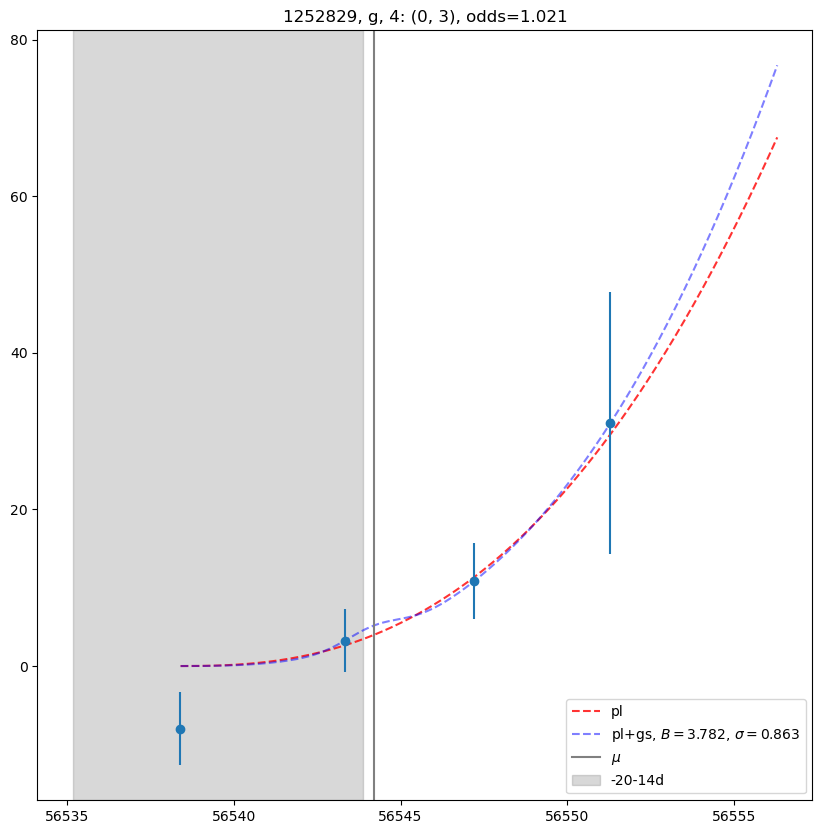

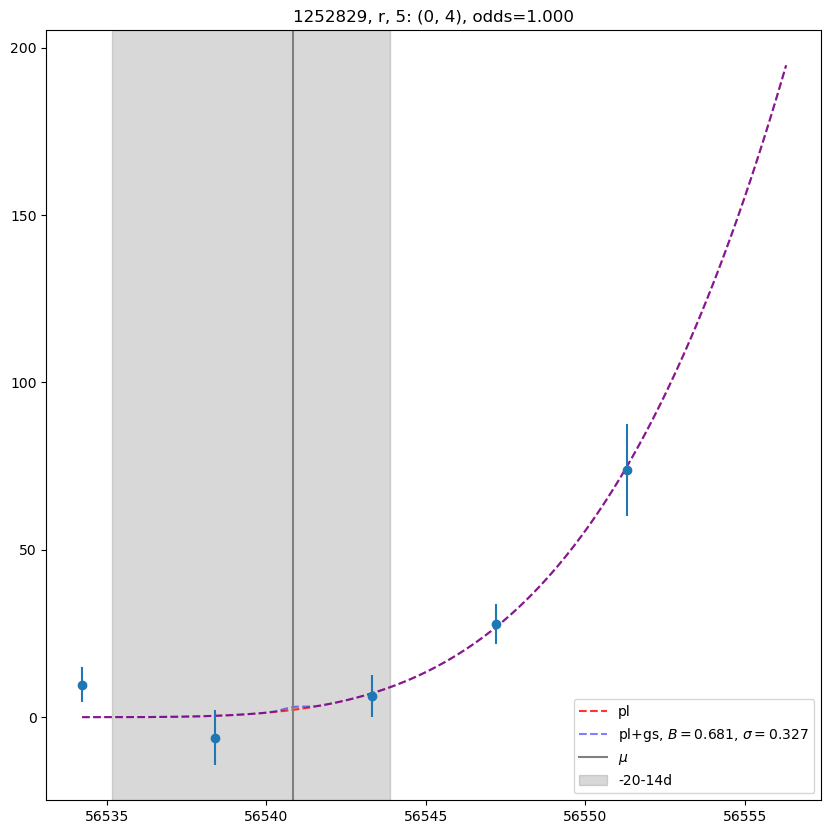

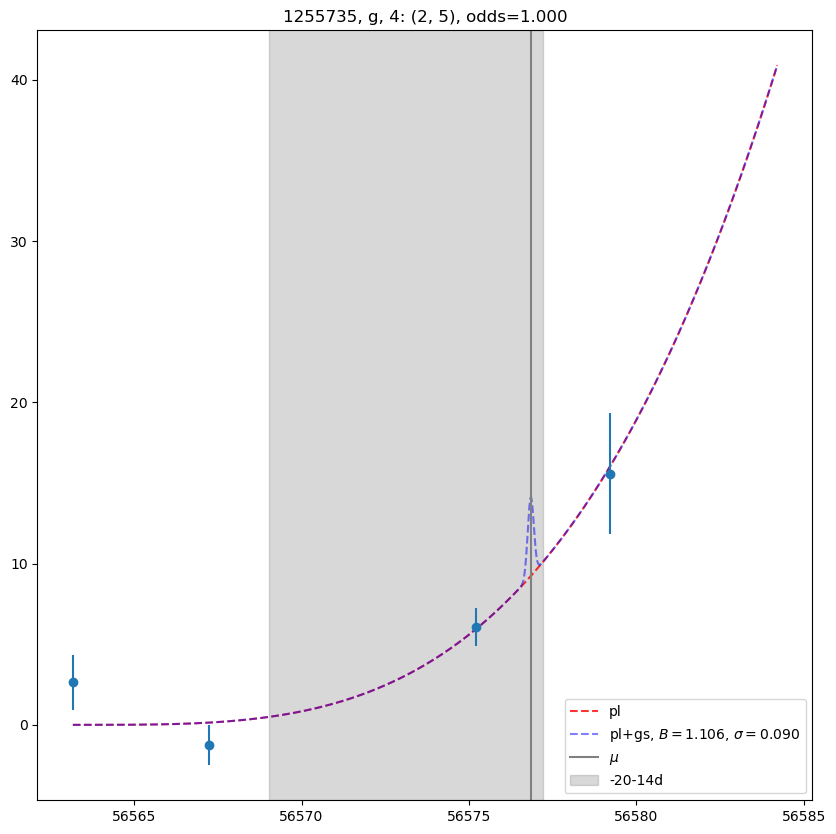

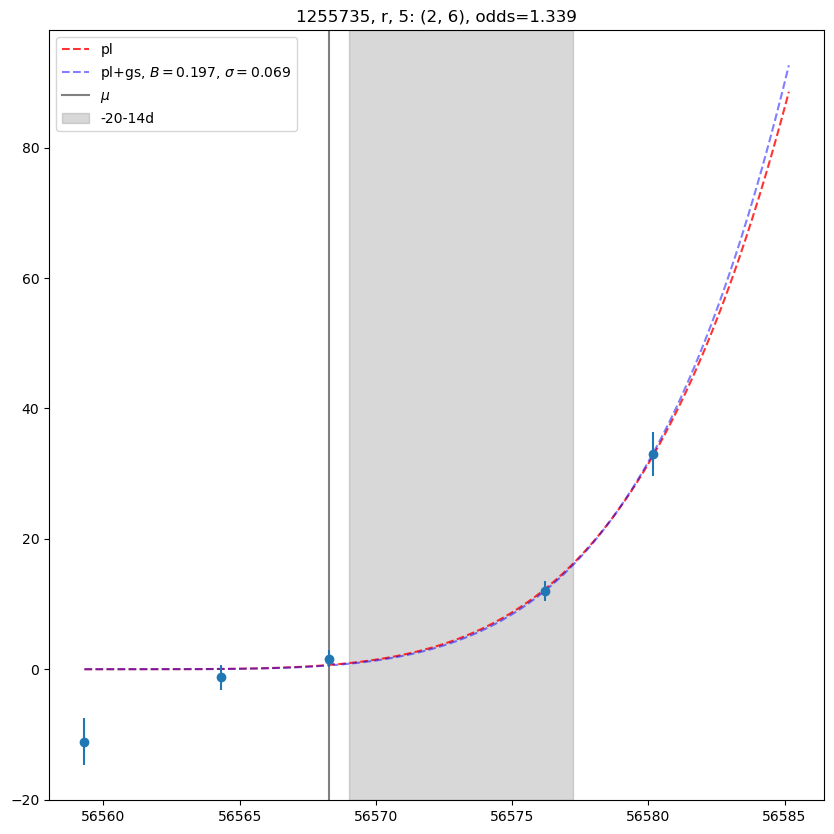

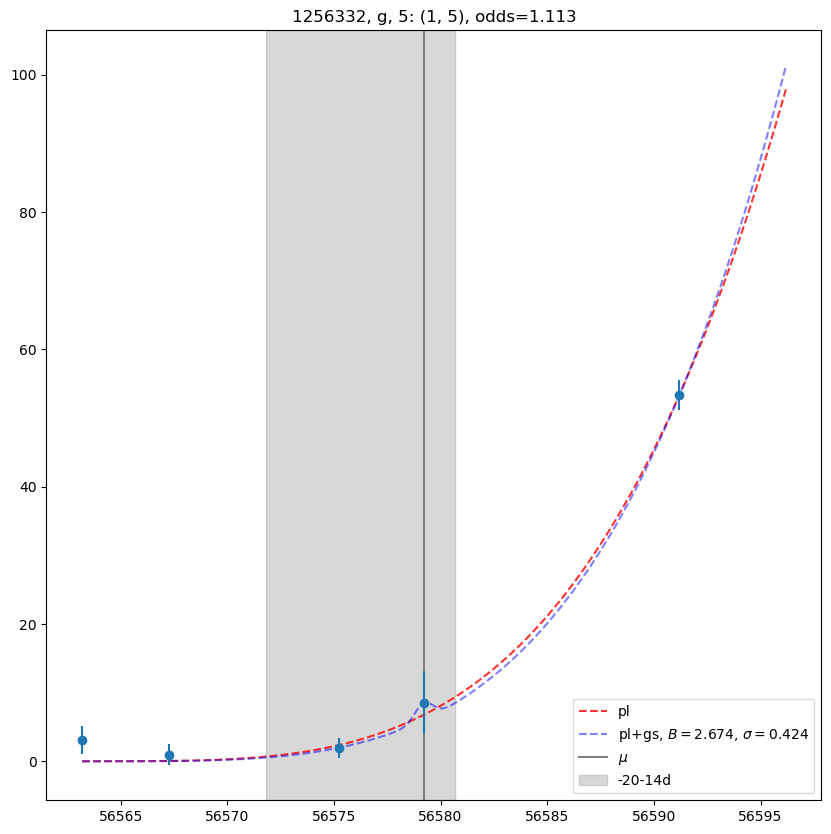

...

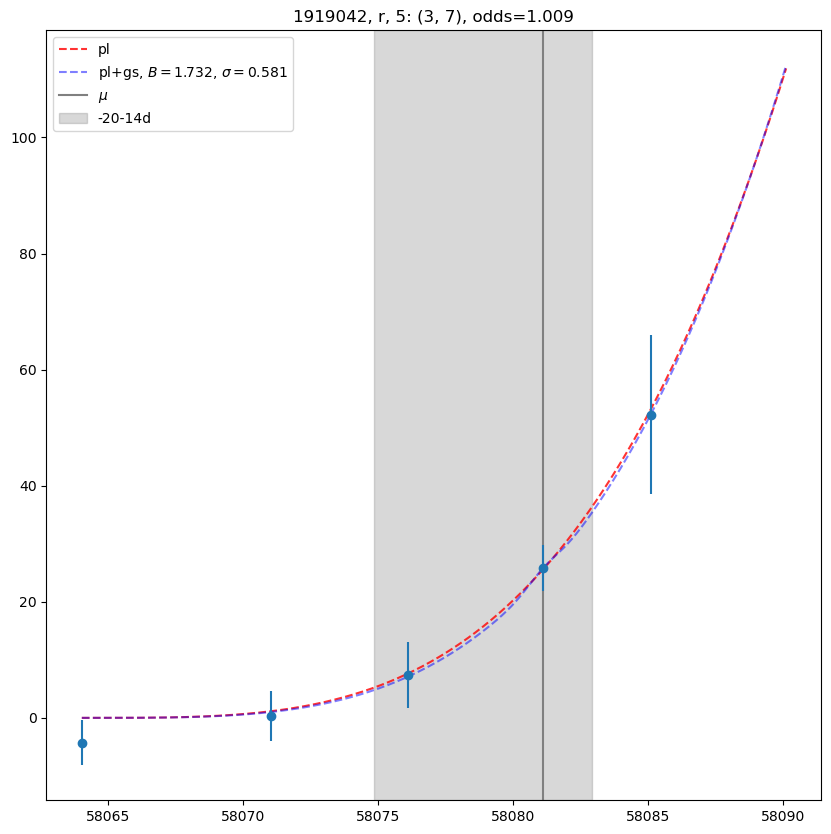

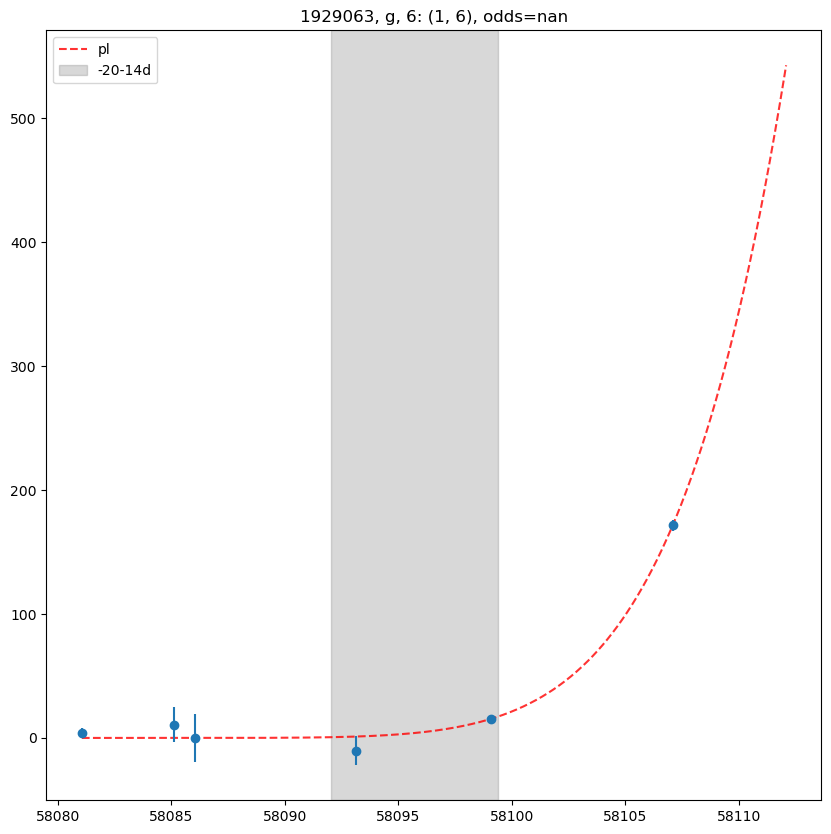

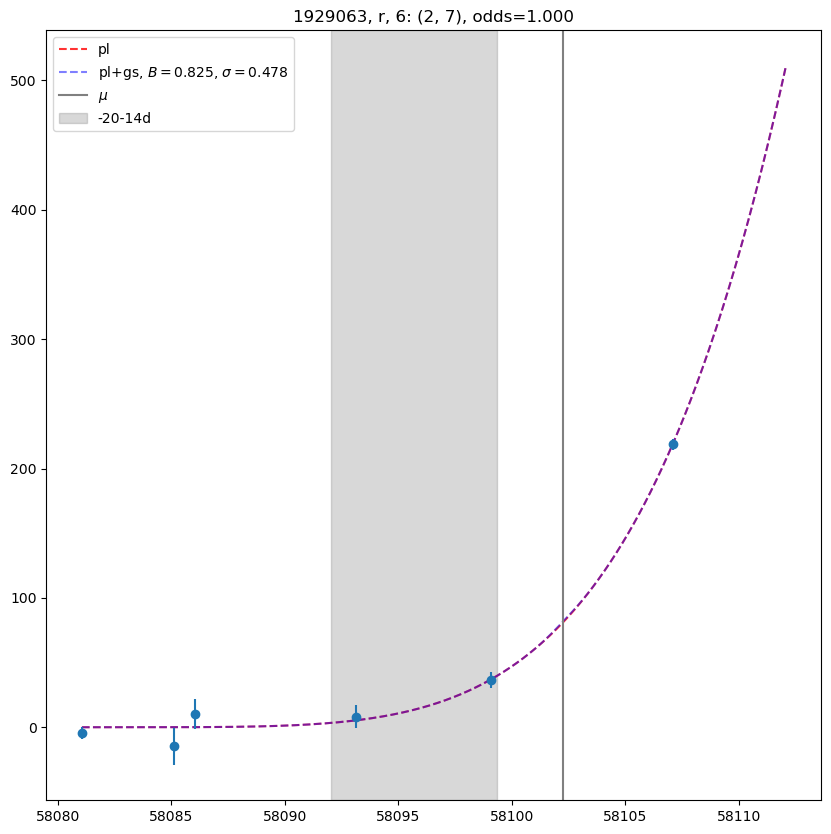

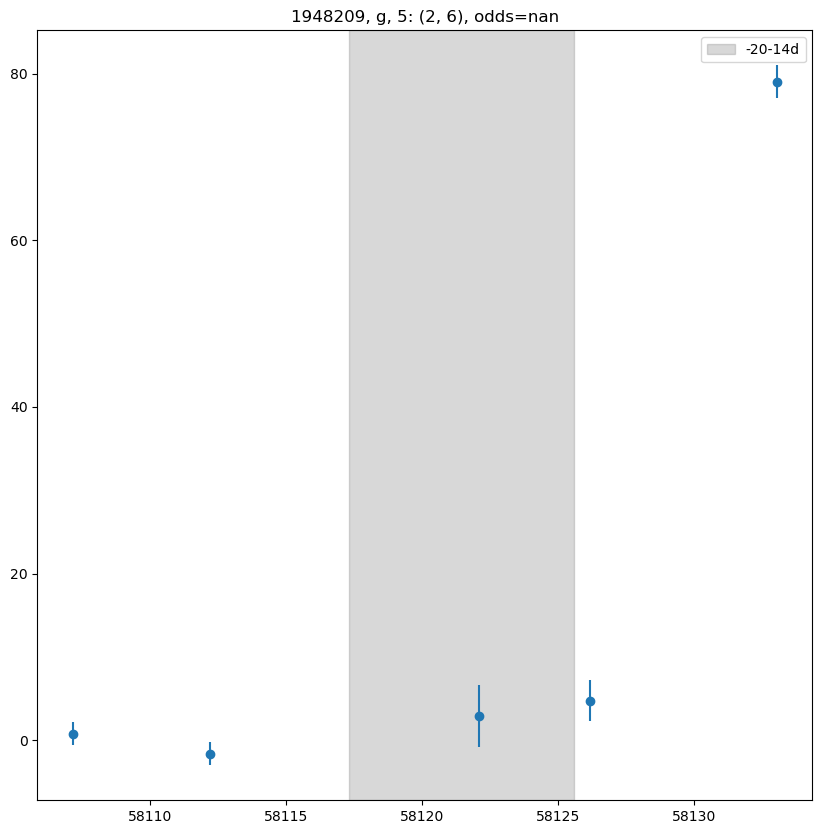

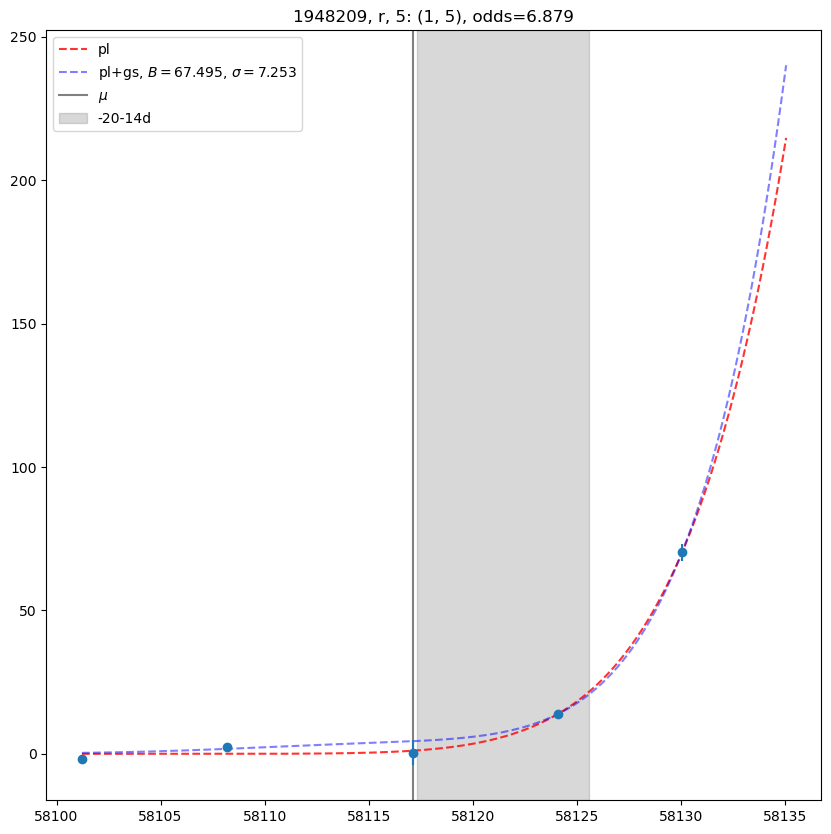

In [309]:
all_odds_trf = []
all_names_trf = []
all_indices_trf = []
# all_odds_dogbox = []
# all_names_dogbox = []

method = 'trf'
for i, id in enumerate(c_new): 
    for f in ['g', 'r']: 
        a = plotfits(id, filt=f'{f}', method=f'{method}', bounds=True, t0=False, p0=False, rf=False)  
        if len(a) < 10: 
            if a[1]['odds'] is not np.nan: 
                all_names_trf.append(a[1]['name'])
                all_indices_trf.append(a[1]['index'])
                all_odds_trf.append(a[1]['odds'])
                # all_odds_dogbox.append(a[1]['name'])
                # all_names_dogbox.append(a[1]['odds'])

        print('\n')

In [ ]:
##### RUN FOR ALL GR FOR CNEW #####

#### in a for loop with plots #####

#### if moderately successful, then save a dataframe. 



In [ ]:
### PLOTTING (FUNCTION FROM DES) 
count += 1
        
plt.figure(count, figsize=(10, 10))
ts = np.linspace(x.min() - 5, x.max() + 5, 1000)
color = 'teal' if filt == 'g' else 'orange'

def pl(t, A, beta): 
    return A*(t-x.min())**beta

def gs(t, B, sigma, mu): 
    return (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))

if popt1 is not None: 
    # plt.plot(ts, powerlaw_rf(ts, *popt1), label=f'pl, {filt}', ls='--', color=f'{color}', alpha=0.5)
    plt.plot(ts, powerlaw_rf(ts, *popt1), label=f'pl, {filt}', ls='-', color='red', alpha=0.8)
    # plt.axvline(popt1[2], ls='-', color='red', alpha=0.5, label=f't0_pl = {popt1[2]:.3f}')
if popt2 is not None: 
    # plt.plot(ts, powerlaw_gauss_rf(ts, *popt2), label=f'pl+gs, {filt}', ls='--', color=f'{color}', alpha=0.5)
    plt.plot(ts, powerlaw_gauss_rf(ts, *popt2), label=f'pl+gs, {filt}', ls='-', color='teal', alpha=0.5)
    # plt.axvline(x.min() + popt2[-1], ls='--', label=f"\mu = {x.min() + popt2[-1]}")
    # plt.axvline(x.min() + popt2[-1], ls='-', color='grey', alpha=0.5, label=f"$\mu = {popt2[-1]:.3f}$")
    # plt.axvline(popt2[5], ls='-', color='blue', alpha=0.5, label=f't0_pl_gs = {popt2[2]:.3f}')

    plt.title(f'{c_new[i]}, {filt}, odds ratio = {odds_bump:.3f}')
    # overplot the gaussian individually and the power law inidividually
    plt.plot(ts, pl(ts, popt2[0], popt2[1]), ls=':', color='blue', label='pl portion')
    plt.plot(ts, gs(ts, popt2[2], popt2[3], popt2[4]), ls='--', color='blue', label='gs portion')

else: 
    plt.title(f'{c_new[i]}, {filt}')

plt.errorbar(x, y, yerr, fmt='o', color=f'{color}')

#     if odds_bump is not None: 
#         plt.title(f'{c_new[i]}, {filt}, odds ratio = {odds_bump:.3f}')
# else: 
#     plt.title(f'{c_new[i]}, {filt}')

plt.legend()

### 6.75: A _really_ old version ###

In [205]:
###### THIS IS THE REALLY OLD VERSION ###### 

import inspect
from scipy import optimize 

all_stats = []
# for i in range(len(c_new)): 
for i in excess_flux_cuts_x_unique:    # do for all c_new eventually; excess_flux_cuts_x_unique => detection
# for i in range(len(c_new)):          # <-- need to make sure data exists too  

    for filt in ('g', 'r'):      # also in i if needed if that's a detection.. 
        if len(interp(c_new[i], filt)['data']) == 0: 
            print(f'No data for SN {c_new[i]}, band {filt}.')
            break 
        early_y = interp(c_new[i], filt)['data'][:, 1][interp(c_new[i], filt)['data'][:, 0] < 0]
        # ind = np.where(np.isclose(early_y, interp(c_new[i], filt)['data'][:, 1].max() * 0.4, atol=25))[0][0] 
        
        val = interp(c_new[i], filt)['data'][:, 1].max() * 0.4
        diffs = np.abs(early_y - val)

        ind = diffs.argmin()

        # add early index 
        day = -30
        diffs_day = np.abs(interp(c_new[i], filt)['data'][:, 0] - day)
        ind_day = diffs_day.argmin()
        
        ind_day = 0      # add this if you don't want to cut any earlier points off <-- note this results in better fitting results...
        num_pts = ind - ind_day + 1
        # print(f'{ind_day, ind}, points = {num_pts}')
        # assert ind_day <= ind
        
        def powerlaw_rf(t, A, beta):                    # what if you fit for t0. 
            return A*(t-x.min())**beta            # no y-intercept term because flux is already calibrated
            # return A*(t-t0)**beta
            # return A*(t-t0)**beta + C 
            # think more about how to get more accurate measure for x.min...
            
        def powerlaw_gauss_rf(t, A, beta, B, sigma, mu): 
            return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))
            # return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2))
            # return A*(t-t0)**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-t0) - mu)**2 / (2*sigma**2)) + D

        # if ind < 2: 
        # if ind < 3:
        params1 = inspect.signature(powerlaw_rf).parameters
        params2 = inspect.signature(powerlaw_gauss_rf).parameters
        l = len(params1) - 1
        u = len(params2) - 1
        # print(l, u)
        
        if num_pts < l: 
            print(f'{c_new[i]}: {filt}, {num_pts}')
        if l < num_pts < u: 
        # if 2 < ind < 5: 
            print(f'{c_new[i]}: {filt}, {num_pts}, pl') 
        if num_pts >= u: 
        # if ind >= 5: 
            print(f'{c_new[i]}: {filt}, {num_pts}, pl, pl_gs') 
        
        # print(f'{ind_day, ind}, points = {num_pts}')
        print(f'{ind_day, ind}')

        
        # x = interp(c_new[i], filt)['data'][:, 0][:ind+1]
        if filt == 'g': 
            x = mjds_interp_g[c_new[i]][ind_day:ind+1]
        if filt == 'r': 
            x = mjds_interp_r[c_new[i]][ind_day:ind+1]
        y = early_y[ind_day:ind+1]        # restrict range bc some early early points bad  
        yerr = interp(c_new[i], filt)['err'][ind_day:ind+1]
        if len(x) != 0: 
            print(x.min(), y.min()) 
         

        popt1_, pcov1_ = [], []
        popt2_, pcov2_ = [], []
        odds_rat = []
        
        # if ind < 2: 
        if num_pts < l: 
            break 
        # if 2 < ind < 5: 
        if l < num_pts < u: 
            successful0 = False 
            try: 
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)
                popt1_.append(popt1), pcov1_.append(pcov1) 
                successful0 = True
            except: 
                print('Cannot fit pl.') 
            if successful0 == True: 
                lnlike1 = np.nan
                info1 = np.nan
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)

                lnlike1 = -0.5*np.sum(info1['fvec']**2) 
                print(f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1}') 

        # if ind >= 5: 
        if num_pts >= u: 
            successful1 = False 
            try: 
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)
                popt1_.append(popt1), pcov1_.append(pcov1) 
                successful1 = True
            except: 
                print('Cannot fit pl.')
            if successful1 == True: 
                lnlike1 = np.nan
                info1 = np.nan
                popt1, pcov1, info1, d1, e1 = optimize.curve_fit(powerlaw_rf, x, y, sigma=yerr, full_output=True)

                lnlike1 = -0.5*np.sum(info1['fvec']**2)
                # print('Successful pl.')
                print(f'successful pl: {c_new[i]}, {filt}, {ind}, {lnlike1}')
                beta = popt1[1]
                print(f'beta = {beta}')
            
            successful2 = False 
            try: 
                popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss_rf, x, y, sigma=yerr, full_output=True)
                popt2_.append(popt2), pcov2_.append(pcov2) 
                successful2 = True
            except: 
                print('Cannot fit pl + gs.')  
            
            if successful2 == True: 
                lnlike2 = np.nan
                info2 = np.nan
                bounds = ((-np.inf, -np.inf, 0, -np.inf, -np.inf), (np.inf, np.inf, np.inf, np.inf, np.inf))   # specify bounds so that gaussian amplitude has to be pos +
                popt2, pcov2, info2, d2, e2 = optimize.curve_fit(powerlaw_gauss_rf, x, y, sigma=yerr, full_output=True)
                # ensure the gaussian has positive amplitude... 
                # assert popt2[4] > 0 

                lnlike2 = -0.5*np.sum(info2['fvec']**2)      
                print(f'successful pl + gs: {c_new[i]}, {filt}, {ind}, {lnlike1}, {lnlike2}') 
                beta1 = popt1[1]
                print(f'beta1 = {beta1}')
                          
                beta2 = popt2[-1]
                print(f'beta2 = {beta2}')
                          
                odds_bump = lnlike2 / lnlike1
                odds_rat.append(odds_bump)
                print(f'odds ratio = {odds_bump}') 
        
        dict = {'name': f"{c_new[i]}, {filt}, {ind}",
                'popt1_': popt1_, 
                'pcov1_': pcov1_, 
                'popt2_': popt2_, 
                'pcov2_': pcov2_, 
                'odds': odds_rat, 
                'data': list(zip(x, y, yerr))}
        
        all_stats.append(dict)
        
        ## NOTE: If want to calculate chi-squared and normalize across all sn for dof: 
        # if y_error is not None:
        #     dof = len(y_data) - len(popt)
        # else:
        #     dof = len(y_data) - len(popt)

#         # calculate likelihood 
#         if info1: 
#             lnlike1 = np.sum(info1['fvec']**2)   # * -0.5
#         if info2: 
#             lnlike2 = np.sum(info2['fvec']**2)   # * -0.5   # check these expressions again 
        
        # if lnlike1: 
        #     print(c_new[i], filt, ind, lnlike1) 
        # if lnlike2: 
        #     print(c_new[i], filt, ind, lnlike1, lnlike2) 
        
#         # calculate odds ratio: P(M1|Y) / P(M0|Y) = [P(M1) * P(Y|M1)] / [P(M0) * P(Y|M0)]
#             # assume uniform prior? because we don't know if for this particular one a certain model is preferred or not 
#         odds_bump = lnlike2 / lnlike1
        


/tmp/ipykernel_1957936/1613323892.py:80: RuntimeWarning: divide by zero encountered in divide
  res_chi2 = (fluxes[i] - ynew)**2 / ynew
/tmp/ipykernel_1957936/3337438863.py:32: RuntimeWarning: divide by zero encountered in power
  return A*(t-x.min())**beta            # no y-intercept term because flux is already calibrated
/tmp/ipykernel_1957936/3337438863.py:38: RuntimeWarning: divide by zero encountered in power
  return A*(t-x.min())**beta + (B/(sigma*np.sqrt(2*np.pi))) * np.exp(-((t-x.min()) - mu)**2 / (2*sigma**2))


154: g, 5, pl, pl_gs
(0, 4)
56547.291 -3.2070000171661377
successful pl: 154, g, 4, -2.4381010389229276
beta = 0.9734463518935007
successful pl + gs: 154, g, 4, -2.4381010389229276, -1.3706535088144989
beta1 = 0.9734463518935007
beta2 = -99315.38973873672
odds ratio = 0.5621807656585095
154: r, 6, pl, pl_gs
(0, 5)
56545.211 -0.574999988079071
successful pl: 154, r, 5, -4.347338621282875
beta = 8.59920503289561
successful pl + gs: 154, r, 5, -4.347338621282875, -4.347338662238195
beta1 = 8.59920503289561
beta2 = -1.3172323439224307
odds ratio = 1.00000000942078
267: g, 7, pl, pl_gs
(0, 6)
56594.09 -19.132999420166016
successful pl: 267, g, 6, -11.806438335333162
beta = 0.5997645452335522
successful pl + gs: 267, g, 6, -11.806438335333162, -11.806438335376074
beta1 = 0.5997645452335522
beta2 = -31.528843389389486
odds ratio = 1.0000000000036346
267: r, 5, pl, pl_gs
(0, 4)
56590.33 -8.567000389099121
successful pl: 267, r, 4, -1.1817522709992532
beta = 1.2223872517623857e-07
successful pl

In [371]:
# minimize chi-squared = maximize log likelihood 

chisq_powerlaw = np.sum(optimize.curve_fit(powerlaw_rf, x[3:], y[3:], sigma=yerr[3:], full_output=True)[2]['fvec']**2)   ### chi-squared
# chisq_powerlaw_gauss = 

In [ ]:
## 1) CHI-SQUARED: 
    # is the bump statistically necessary [significant / NOT correlated with the model / data], 
    # OR is it just due to chance/random variation?? 

## calculate relationship between the model and the bump? 




In [ ]:
## 2) Bayesian model selection, calculating the odds ratio = [ / ] ? 


### this is more advanced than the simple chi-squared test

### look at the 3358 hw 




## 7) MCMC Fitting